In [1]:
import pandas as pd
import numpy as np
from collections import Counter
import string

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors
import matplotlib.dates as mdates
import matplotlib.patches as mpatches
from cycler import cycler

sns.set()
import spacy
import pyLDAvis.gensim_models

pyLDAvis.enable_notebook()  # Visualise inside a notebook
import en_core_web_trf
import gensim
from gensim.corpora.dictionary import Dictionary
from gensim.models import LdaMulticore, LdaModel
from gensim.models import CoherenceModel
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from gensim.models.callbacks import PerplexityMetric

import re
import little_mallet_wrapper
from tqdm import tqdm
import seaborn as sns
import gensim

from datetime import datetime
import warnings
import ast
import os

from transformers import pipeline
from pysentimiento import create_analyzer
from tqdm.auto import tqdm
import copy
from tqdm.notebook import tqdm
from pysentimiento.preprocessing import preprocess_tweet

from matplotlib import pyplot as plt
from wordcloud import WordCloud
import matplotlib.colors as mcolors

tqdm.pandas()

warnings.filterwarnings("ignore")

C:\Users\user\.conda\envs\chatgpt\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\user\.conda\envs\chatgpt\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
C:\Users\user\.conda\envs\chatgpt\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"
C:\Users\user\.conda\envs\chatgpt\lib\site-packages\spacy\util.py:910: UserWarning: [W095] Model 'en_core_web_trf' (3.5.0) was trained with spaCy v3.5 and may not be 100% compatible with the current version (3.6.0). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


In [2]:
spacy.load('en_core_web_trf')

# Loading data

In [3]:
DATE = '04062023'
tweets_file_name = 'all_tweets_{}.csv'.format(DATE)

In [4]:
# Read the data
posts = pd.read_csv(tweets_file_name, nrows=None)

#### Load existing datasets

In [5]:
def load_existing_tweets_file(file_path):
    top_posts = pd.read_csv(file_path, nrows=None)
    top_posts["id"] = top_posts["id"].astype(str)
    if 'tokens' in top_posts.columns:
        tokens_list = [ast.literal_eval(pp) for pp in top_posts['tokens'].values.tolist()]
        top_posts["tokens"] = tokens_list
   
    if 'match' in top_posts.columns:
        match_list = [ast.literal_eval(pp) for pp in top_posts['match'].values.tolist()]
        top_posts["match"] = match_list
    return top_posts

#### Load only new posts (before merge)

In [6]:
def get_new_tweets_portion_from_previous_file(new_tweets_file_path, old_tweets_file_path):
    old_posts_with_sent_emotion = load_existing_tweets_file(old_tweets_file_path)
    assert "tokens" in old_posts_with_sent_emotion.columns
    assert "sentiment" in old_posts_with_sent_emotion.columns
    assert "sentiment_score" in old_posts_with_sent_emotion.columns
    print("Old posts with tokens and sentiment and emotion", old_posts_with_sent_emotion.shape)
    
    new_posts = pd.read_csv(new_tweets_file_path, nrows=None)
    if "tokens" in new_posts.columns:
        new_posts = load_existing_tweets_file(new_tweets_file_path)
    else:
        new_posts["id"] = new_posts["id"].astype(str)
    print("New posts", new_posts.shape)
    
    # get only new tweets by ID
    new_post_ids = list(set(new_posts["id"]) - set(old_posts_with_sent_emotion["id"]))
    print("Total {} new tweets".format(len(new_post_ids)))
    
    # get only new tweets df
    new_posts_to_process = new_posts[new_posts["id"].isin(new_post_ids)]
    print("New posts to process", new_posts_to_process.shape)
    
    return new_posts_to_process

def concatinate_old_new_processed_tweets(new_processed_tweets_file_path, old_tweets_file_path):
    old_posts_with_sent_emotion = load_existing_tweets_file(old_tweets_file_path)
    assert "tokens" in old_posts_with_sent_emotion.columns
    assert "sentiment" in old_posts_with_sent_emotion.columns
    assert "sentiment_score" in old_posts_with_sent_emotion.columns
    print("Columns in old file: {}".format(old_posts_with_sent_emotion.columns.tolist()))
    
    new_posts = pd.read_csv(new_processed_tweets_file_path, nrows=None)
    if "tokens" in new_posts.columns:
        new_posts = load_existing_tweets_file(new_processed_tweets_file_path)
    else:
        new_posts["id"] = new_posts["id"].astype(str)
    print("Columns in new file: {}".format(new_posts.columns.tolist()))
    
    if new_posts.columns.tolist() == old_posts_with_sent_emotion.columns.tolist():
        #same columns
        new_concatinated_df = pd.concat([old_posts_with_sent_emotion, new_posts], axis=0)
        print("New concatinated DF", new_concatinated_df.shape)
    # drop_duplicates
    new_concatinated_df = new_concatinated_df.drop_duplicates(subset=["id"])
    print("New concatinated DF", new_concatinated_df.shape)
    
    return new_concatinated_df

In [24]:
new_posts_to_process_df = get_new_tweets_portion_from_previous_file(old_tweets_file_path='all_tweets_from_last_7_days_28052023_with_sentiment_emotion.csv',
                                                                    new_tweets_file_path="all_tweets_from_last_7_days_04062023_tokens.csv")
new_posts_to_process_df.shape

Old posts with tokens and sentiment and emotion (324623, 19)
New posts (407874, 14)
Total 83332 new tweets
New posts to process (83332, 14)


(83332, 14)

In [62]:
all_posts_merged_df = concatinate_old_new_processed_tweets(new_processed_tweets_file_path="temp_tweets_to_process_04062023_with_sentiment_emotion.csv",
                                                           old_tweets_file_path="all_tweets_from_last_7_days_28052023_with_sentiment_emotion.csv")
all_posts_merged_df.shape

Columns in old file: ['author_id', 'created_at', 'id', 'post', 'edit_history_tweet_ids', 'retweet_count', 'reply_count', 'like_count', 'quote_count', 'impression_count', 'rule', 'engagement_count', 'clean_post', 'tokens', 'clean_post_for_sentiment', 'sentiment_score', 'sentiment', 'emotion', 'emotion_score']
Columns in new file: ['author_id', 'created_at', 'id', 'post', 'edit_history_tweet_ids', 'retweet_count', 'reply_count', 'like_count', 'quote_count', 'impression_count', 'rule', 'engagement_count', 'clean_post', 'tokens', 'clean_post_for_sentiment', 'sentiment_score', 'sentiment', 'emotion', 'emotion_score']
New concatinated DF (407955, 19)
New concatinated DF (407955, 19)


(407955, 19)

In [65]:
print("Posts without tokens", all_posts_merged_df[all_posts_merged_df["clean_post"].isnull()].shape[0])
all_posts_merged_df = all_posts_merged_df[~all_posts_merged_df["clean_post"].isnull()]
all_posts_merged_df.shape

Posts without tokens 73


(407882, 19)

In [66]:
all_posts_merged_df.to_csv("all_tweets_from_last_7_days_04062023_with_sentiment_emotion.csv", index=False)

#### Continue pre-process

In [ ]:
if "Unnamed: 0" in posts.columns:
    posts = posts.drop(columns=["Unnamed: 0"])
if "withheld" in posts.columns:
    posts = posts.drop(columns=["withheld"])
if 'bookmark_count' in posts.columns:
    posts = posts.drop(columns=["bookmark_count"])
if "text" in posts.columns:  
    posts = posts.rename(columns={"text": "post"})

posts = posts.dropna(axis=1, how='all', inplace=False)
print(posts.shape)
posts.head()

In [7]:
posts["id"] = posts["id"].apply(str)
posts["author_id"] = posts["author_id"].apply(str)

In [9]:
posts["engagement_count"] = posts["retweet_count"] + posts["reply_count"] + posts["like_count"] + posts["quote_count"]
# Engagements: Total number of times a user interacted with a Tweet. Clicks anywhere on the Tweet, including Retweets, replies, follows, likes, links, cards, hashtags, embedded media, username, profile photo, or Tweet expansion
# Engagement rate: Number of engagements divided by impressions
posts["engagement_rate"] = posts["engagement_count"] / posts["impression_count"]

In [12]:
print("Before filtering engamement", posts.shape)

Before filtering engamement (451894, 12)


# Cleaning and pre-processing

In [6]:
from spacy.lang.en import stop_words

extended_stop_wrods = list(stop_words.STOP_WORDS)
extended_stop_wrods.remove('no')
extended_stop_wrods.remove('not')
if "doesnt" in extended_stop_wrods:
    extended_stop_wrods.remove("doesnt")
if "doesn't" in extended_stop_wrods:
    extended_stop_wrods.remove("doesn't")
if "dont" in extended_stop_wrods:
    extended_stop_wrods.remove("dont")
if "don't" in extended_stop_wrods:
    extended_stop_wrods.remove("don't")
if "aren't" in extended_stop_wrods:
    extended_stop_wrods.remove("aren't")
if "arent" in extended_stop_wrods:
    extended_stop_wrods.remove("arent")
if "give" in extended_stop_wrods:
    extended_stop_wrods.remove("give")
if "up" in extended_stop_wrods:
    extended_stop_wrods.remove("up")
if "call" in extended_stop_wrods:
    extended_stop_wrods.remove("call")
if "down" in extended_stop_wrods:
    extended_stop_wrods.remove("down")

STOP_WORDS = set(extended_stop_wrods)
# Our spaCy model:
nlp = en_core_web_trf.load()

In [7]:
def get_url_patern():
    return re.compile(
        r'(https?:\/\/(?:www\.|(?!www))[a-zA-Z0-9][a-za-z0-9-]+[a-zA-Z0-9]\.[^\s]{2,}|https?:\/\/(?:www\.|(?!www))'
        r'[a-zA-Z0-9]\.[^\s]{2,}|www\.[a-zA-Z0-9]\.[^\s]{2,})')


def get_hashtags_pattern():
    return re.compile(r'#\w+')


def get_single_letter_words_pattern():
    return re.compile(r'(?<![\w-])\w(?![\w-])')


def get_blank_spaces_pattern():
    return re.compile(r'\s{2,}|\t')


def get_twitter_reserved_words_pattern():
    return re.compile(r'(RT|rt|FAV|fav|VIA|via)')


def get_mentions_pattern():
    return re.compile(r'@\w\*')


def clean_sentence(sentence, remove_stop_words=False, remove_short_words=False, remove_numbers=True):
    sentence = re.sub(pattern=get_url_patern(), repl="", string=sentence)
    sentence = re.sub(pattern=get_mentions_pattern(), repl="", string=sentence)
    sentence = re.sub(pattern=get_hashtags_pattern(), repl="", string=sentence)
    sentence = re.sub(pattern=get_twitter_reserved_words_pattern(), repl='', string=sentence)
    sentence = re.sub(r'http\S+', "", sentence)  # remove http links
    sentence = re.sub(r'bit.ly/\S+', "", sentence)  # remove bitly links
    sentence = sentence.strip('[link]')  # remove [links]
    sentence = re.sub('(RT\s@[A-Za-z]+[A-Za-z0-9-*]+)', "", sentence)  # remove retweet
    sentence = re.sub('(@[A-Za-z]+[A-Za-z0-9-_]+)', "", sentence)  # remove tweeted at
    sentence = sentence.encode('ascii', 'ignore').decode('ascii')

    clean_sentence = little_mallet_wrapper.process_string(sentence,
                                                          numbers='remove' if remove_numbers else None,
                                                          remove_stop_words=remove_stop_words,
                                                          remove_short_words=remove_short_words)
    return clean_sentence

In [8]:
import unicodedata
from nltk.tokenize.toktok import ToktokTokenizer

CONTRACTION_MAP = {
"ain't": "is not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he'll've": "he he will have",
"he's": "he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how is",
"I'd": "I would",
"I'd've": "I would have",
"I'll": "I will",
"I'll've": "I will have",
"I'm": "I am",
"I've": "I have",
"i'd": "i would",
"i'd've": "i would have",
"i'll": "i will",
"i'll've": "i will have",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'd've": "it would have",
"it'll": "it will",
"it'll've": "it will have",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she would",
"she'd've": "she would have",
"she'll": "she will",
"she'll've": "she will have",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as",
"that'd": "that would",
"that'd've": "that would have",
"that's": "that is",
"there'd": "there would",
"there'd've": "there would have",
"there's": "there is",
"they'd": "they would",
"they'd've": "they would have",
"they'll": "they will",
"they'll've": "they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what'll've": "what will have",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"when's": "when is",
"when've": "when have",
"where'd": "where did",
"where's": "where is",
"where've": "where have",
"who'll": "who will",
"who'll've": "who will have",
"who's": "who is",
"who've": "who have",
"why's": "why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you would",
"you'd've": "you would have",
"you'll": "you will",
"you'll've": "you will have",
"you're": "you are",
"you've": "you have"
}

def remove_stopwords(text, tokenizer, is_lower_case=False):
    tokens = tokenizer.tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in STOP_WORDS]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in STOP_WORDS]
    filtered_text = ' '.join(filtered_tokens)    
    return filtered_text

def lemmatize_text(text):
    text = nlp(text)
    text = ' '.join([word.lemma_ if word.lemma_ != '-PRON-' else word.text for word in text])
    return text

def remove_special_characters(text, remove_digits=False, remove_punctuation=False):
    base_punctuation = "!,.-(){}/\""
    base_pattern = "^a-zA-z0-9\s" if not remove_digits else "^a-zA-z\s"
    if not remove_punctuation:
        base_pattern = base_pattern + base_punctuation 
    pattern = f'[{base_pattern}]'
    text = re.sub(r''.format(pattern), '', text)
    return text

def expand_contractions(text, contraction_mapping=CONTRACTION_MAP):
    
    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())), 
                                      flags=re.IGNORECASE|re.DOTALL)
    def expand_match(contraction):
        match = contraction.group(0)
        first_char = match[0]
        expanded_contraction = contraction_mapping.get(match)\
                                if contraction_mapping.get(match)\
                                else contraction_mapping.get(match.lower())                       
        expanded_contraction = first_char+expanded_contraction[1:]
        return expanded_contraction
        
    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
    return expanded_text

def remove_accented_chars(text):
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')
    return text

def remove_url_tokens(text):
    text = re.sub(pattern=get_url_patern(), repl="", string=text)
    text = re.sub(r'http\S+', "", text)  # remove http links
    text = re.sub(r'bit.ly/\S+', "", text)  # remove bitly links
    text = text.strip('[link]')  # remove [links]
    if "find out here:" in text:
        text = text.replace("find out here:", "")
    elif "Find out here:" in text:
        text = text.replace("Find out here:", "")
    return text

def remove_hashtags_from_text(text):
    text = re.sub(pattern=get_hashtags_pattern(), repl="", string=text)
    return text

def remove_emoji_from_text(text):
    text = re.sub(r'\\(n|x..)', '', text)
    return text

def remove_non_ascii_characters_from_text(text):
    text = text.encode("ascii", "ignore")
    text = text.decode()
    return text

def remove_short_tokens(text, remove_len=2):
    return ' '.join([w for w in text.split(" ") if (len(w) > remove_len) or (w in stop_words.STOP_WORDS)])

def normalize_sentence(doc, tokenizer=ToktokTokenizer(), remove_urls=True, remove_short_words=True, contraction_expansion=True, remove_mentions=True,
                     accented_char_removal=True, text_lower_case=True, 
                     text_lemmatization=True, special_char_removal=True, 
                     stopword_removal=True, remove_digits=True, remove_hashtags=True, remove_emoji=True, remove_non_ascii_characters=True):
    # normalize each document in the corpus
    if remove_urls:
        doc = remove_url_tokens(doc)
    if remove_mentions:
        doc = re.sub(pattern=get_mentions_pattern(), repl="", string=doc)
        doc = re.sub('(RT\s@[0-9A-Za-z_]+[A-Za-z0-9-_*]+)', "", doc)  # remove retweet
        doc = re.sub('(@[0-9A-Za-z_]+[A-Za-z0-9-_]+)', "", doc)  # remove tweeted at
        doc = doc.replace("&amp", "")
        doc = doc.replace("'s", "")
    if remove_hashtags:
        doc = remove_hashtags_from_text(doc)
    if remove_emoji:
        doc = remove_emoji_from_text(doc)
    # remove accented characters
    if accented_char_removal:
        doc = remove_accented_chars(doc)
    # expand contractions
    if contraction_expansion:
        doc = expand_contractions(doc)
    # lowercase the text    
    if text_lower_case:
        doc = doc.lower()
    # remove extra newlines
    doc = re.sub(r'[\r|\n|\r\n]+', ' ',doc)
    # lemmatize text
    if text_lemmatization:
        doc = lemmatize_text(doc)
    # remove special characters and\or digits    
    if special_char_removal:
        # insert spaces between special characters to isolate them    
        special_char_pattern = re.compile(r'([{.(-)!}])')
        doc = special_char_pattern.sub(" \\1 ", doc)
        doc = remove_special_characters(doc, remove_digits=remove_digits)  
    # remove extra whitespace
    doc = re.sub(' +', ' ', doc)
    # remove stopwords
    if stopword_removal:
        doc = remove_stopwords(doc, tokenizer, is_lower_case=text_lower_case)  
    if remove_short_words:
        doc = remove_short_tokens(doc)
    if remove_non_ascii_characters:
        doc = remove_non_ascii_characters_from_text(doc)
    doc = doc.strip()
    return doc

In [19]:
posts["clean_post"] = posts["post"].progress_apply(lambda x : normalize_sentence(x, tokenizer=ToktokTokenizer(),
                                                                                 remove_urls=True,
                                                                                 remove_short_words=True,
                                                                                 contraction_expansion=True,
                                                                                 remove_mentions=True,
                                                                                 accented_char_removal=True,
                                                                                 text_lower_case=True,
                                                                                 text_lemmatization=True,
                                                                                 special_char_removal=True,
                                                                                 stopword_removal=True,
                                                                                 remove_digits=True))

  0%|          | 0/407956 [00:00<?, ?it/s]

In [22]:
if 'tokens' not in posts.columns:
    posts["tokens"] = posts['clean_post'].progress_apply(lambda sent: list(dict.fromkeys(sent.split(" "))))

  0%|          | 0/407956 [00:00<?, ?it/s]

In [24]:
# Remove tweets with empty tokens list
y = posts["tokens"].apply(lambda x: len(x) == 1 and '' in x)
posts = posts.loc[~y, :]

In [25]:
posts.shape

(407874, 14)

In [26]:
posts.to_csv("all_tweets_from_last_7_days_{}_tokens.csv".format(DATE), index=False)

## Remove duplicate tweet by similarity function

In [130]:
DATE = "04062023"
tweets_to_process = load_existing_tweets_file("all_tweets_from_last_7_days_{}_with_sentiment_emotion.csv".format(DATE))
tweets_to_process.shape

(407882, 19)

In [131]:
tweets_to_process["clean_post_for_themes_identification"] = tweets_to_process["post"].progress_apply(lambda x: normalize_sentence(x, tokenizer=ToktokTokenizer(),
                                                                                 remove_urls=True,
                                                                                 remove_short_words=False,
                                                                                 contraction_expansion=False,
                                                                                 remove_mentions=True,
                                                                                 accented_char_removal=False,
                                                                                 text_lower_case=False,
                                                                                 text_lemmatization=False,
                                                                                 special_char_removal=False,
                                                                                 stopword_removal=False,
                                                                                 remove_digits=False,
                                                                                 remove_emoji=True,
                                                                                 remove_hashtags=False,
                                                                                 remove_non_ascii_characters=True))
print(tweets_to_process.shape)

  0%|          | 0/407882 [00:00<?, ?it/s]

(407882, 20)


In [133]:
# Filter tweets with few than 5 meaningful tokens
tweets_to_process_filtered = tweets_to_process[tweets_to_process["tokens"].map(len) >= 5].reset_index(drop=True)
print(tweets_to_process_filtered.shape)

(364315, 20)


In [134]:
import textdistance
import numpy as np  
import swifter
from swifter import set_defaults

# Filter similar tweets according to tokens
# Calculate similarities between rows
# and save corresponding indexes in a new column "match"
def find_similar2(t):
    return [i for i, tokens_list in enumerate(tweets_to_process_filtered["tokens"]) 
            if (len(set(t).intersection(tokens_list)) > 0.8 * len(tokens_list)) and (len(set(t).intersection(tokens_list)) > 0.8 * len(t))]

In [48]:
def find_similar(tokens):
    i_s = []
    for i, row in tweets_to_process_filtered.iterrows():
        tokens_comp = row["tokens"]
        intersection = set(tokens).intersection(tokens_comp)
        if len(intersection) >= 0.8 * len(tokens_comp) and len(intersection) >= 0.8 * len(tokens):
            # similar
            i_s.append(i)
    return i_s

def remove_similar_duplicates(df_with_match):
    # Iterate to remove similar rows (keeping only the first one)
    indices_to_keep = set()
    indices_to_remove = set()
    for i, match_indices in tqdm(enumerate(df_with_match["match"])):
        match_list = ast.literal_eval(match_indices)
        indices_to_keep.add(i)
        if len(match_list) > 1:
            indices_to_remove.update([j for j in match_list if j not in indices_to_keep])
    return indices_to_keep, indices_to_remove

In [ ]:
tweets_to_process_filtered["match"] = tweets_to_process_filtered["tokens"].swifter.progress_bar(True).force_parallel(enable=True).allow_dask_on_strings(enable=True).apply(lambda x: find_similar2(x))

Dask Apply:   0%|          | 0/16 [00:00<?, ?it/s]

In [49]:
print("Size BEFORE similar duplicate removal", df_with_match.shape[0])
indices_to_keep, indices_to_remove = remove_similar_duplicates(df_with_match)
df_with_match_removed = df_with_match.drop(index=indices_to_remove, errors="ignore")
df_with_match_removed = df_with_match_removed.drop(columns="match")
print("Size AFTER similar duplicate removal", df_with_match_removed.shape[0])

Size BEFORE similar duplicate removal 407882


0it [00:00, ?it/s]

Size AFTER similar duplicate removal 264752


In [53]:
# Filter tweets with few than 3 meaningful tokens
df_with_match_removed_filtered = df_with_match_removed[df_with_match_removed["tokens"].map(len) >= 4].reset_index(drop=True)
print(df_with_match_removed_filtered.shape)

(254027, 20)


In [61]:
df_with_match_removed_filtered = df_with_match_removed_filtered.drop_duplicates("id")
df_with_match_removed_filtered.shape

(246811, 20)

In [76]:
df_with_match_removed_filtered.shape

(246811, 20)

In [77]:
DATE = "04062023"
df_with_match_removed_filtered.to_csv("tweets_{}_with_sentiment_emotion_for_chatgpt_filtered.csv".format(DATE), index=False)

# Topic Modeling (not used)

In [21]:
TOKENS_COLUMN_NAME = "posts_with_chatgpt_img_texts_tokens"
TOKENS_COLUMN_FOR_TOPIC_MODELING = "bigrams_tokens"

In [22]:
posts = load_existing_tweets_file("all_tweets_from_last_7_days_{}_with_sentiment_emotion.csv".format(DATE))
extracted_img_texts = load_existing_tweets_file("all_tweets_from_last_7_days_07052023_with_sentiment_emotion_img_texts.csv")
posts_with_tokens = load_existing_tweets_file("all_tweets_from_last_7_days_{}_tokens.csv".format(DATE))
print("posts", posts.shape)
print("posts_with_tokens", posts_with_tokens.shape)
print("extracted_img_texts", extracted_img_texts.shape)

posts (364356, 16)
posts_with_tokens (324623, 14)
extracted_img_texts (275741, 26)


In [24]:
posts = posts_with_tokens.merge(posts[["id", 'clean_post_for_sentiment', 'sentiment_score', 'sentiment', 'emotion', 'emotion_score']], left_on="id", right_on="id", how="inner")
print(posts.shape)

(324623, 19)


In [28]:
posts[["post", "clean_post", "sentiment", "emotion"]].head()

,post,clean_post,sentiment,emotion
0,You can now text @TSA to ask them questions! P...,text ask question use info weather forecast re...,Neutral,neutral
1,If you're wondering about #OpenAI and #ChatGPT...,wonder openai chatgpt similar podcast episode ...,Positive,neutral
2,It's quite impressive how in under a month the...,impressive month twitter public opinion chatgp...,Neutral,surprise
3,DAN has no limit and no censorship. DAN has ve...,dan no limit no censorship dan strong opinion ...,Positive,neutral
4,OPINION: Is ChatGPT the future of content crea...,opinion chatgpt future content creation,Neutral,neutral


In [29]:
extracted_img_texts = extracted_img_texts[~extracted_img_texts["imgs_clean_texts_chatgpt_cleaned"].isnull()]
posts = posts.merge(extracted_img_texts[["id", "imgs_clean_texts_chatgpt_cleaned"]], left_on="id", right_on="id", how="left")
print(posts[~posts["imgs_clean_texts_chatgpt_cleaned"].isnull()].shape)

(42, 20)


In [30]:
posts['chatgpt_img_text_tokens'] = posts['imgs_clean_texts_chatgpt_cleaned'].progress_apply(lambda doc: list(dict.fromkeys(doc.split(" "))) if not pd.isnull(doc) else [])

  0%|          | 0/324623 [00:00<?, ?it/s]

In [31]:
posts["posts_with_chatgpt_img_texts_tokens"] = posts[["tokens", "chatgpt_img_text_tokens"]].progress_apply(lambda x: list(set(x[0] + x[1])) if x[1] else x[0], axis=1)
print(posts["posts_with_chatgpt_img_texts_tokens"].shape)

  0%|          | 0/324623 [00:00<?, ?it/s]

(324623,)


In [35]:
posts["created_at"] = pd.to_datetime(posts["created_at"].replace("T", " ").replace("Z", ""), format="%Y-%m-%d")
posts['week_num'] = posts['created_at'].dt.isocalendar().week

week_num_count_df = posts.groupby(["week_num"]).count()["id"].reset_index().rename(columns={"id": "week_count"})
week_num_count_df["week_num"] = week_num_count_df["week_num"].map({week: get_week_date_range_str(2023, week) for week in range(1, 52)})
week_num_count_df

,week_num,week_count
0,30/01-05/02,38533
1,06/02-12/02,16804
2,13/02-19/02,5968
3,20/02-26/02,76982
4,27/02-05/03,61703
5,06/03-12/03,8173
6,13/03-19/03,11034
7,20/03-26/03,11863
8,27/03-02/04,11365
9,03/04-09/04,10853


### Gensim topic modeling

In [36]:
connector_words=["chatgpt", "gpt", "chatGPT", "GPT", "ChatGPT", "CHATGPT"]
# Build the bigram and trigram models
bigram = gensim.models.Phrases(posts[TOKENS_COLUMN_NAME], min_count=1, connector_words=list(gensim.models.phrases.ENGLISH_CONNECTOR_WORDS) + connector_words) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[posts[TOKENS_COLUMN_NAME]], min_count=1, connector_words=list(gensim.models.phrases.ENGLISH_CONNECTOR_WORDS) + connector_words)
# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

In [90]:
def make_bigrams(doc):
    res = []
    for token in bigram_mod[doc]:
        if '_' in token:
            pre_processed_token = token.replace("_", " ")
            if pre_processed_token.count(' ') == 1:
                res.append(pre_processed_token)
    return res

def make_trigrams(doc):
    res = []
    for token in trigram_mod[bigram_mod[doc]]:
        if '_' in token:
            pre_processed_token = token.replace("_", " ")
            if pre_processed_token.count(' ') == 2:
                res.append(pre_processed_token)
    return res

In [ ]:
posts['bigrams_tokens'] = posts[TOKENS_COLUMN_NAME].progress_apply(lambda x: make_bigrams(x))
posts['trigrams_tokens'] = posts[TOKENS_COLUMN_NAME].progress_apply(lambda x: make_trigrams(x))

In [38]:
print("Filtered posts without created bigrams", posts[posts['bigrams_tokens'].map(len) == 0].shape[0])
x = posts[posts['bigrams_tokens'].map(len) > 0]
print("After bigram creation", x.shape[0])

print("Filtered posts without created trigrams", posts[posts['trigrams_tokens'].map(len) == 0].shape[0])
x = posts[posts['trigrams_tokens'].map(len) > 0]
print("After trigrams creation", x.shape[0])

Filtered posts without created bigrams 373
After bigram creation 324250
Filtered posts without created trigrams 19764
After trigrams creation 304859


In [45]:
posts = posts[posts[TOKENS_COLUMN_FOR_TOPIC_MODELING].map(len) > 0]
print("After removing posts without bigrams or trigrams (or unigrams not with chatgpt word): {}".format(posts.shape[0]))

After removing posts without bigrams or trigrams (or unigrams not with chatgpt word): 324250


In [46]:
# Create dictionary
# I will apply the Dictionary Object from Gensim, which maps each word to their unique ID:
dictionary = Dictionary(posts[TOKENS_COLUMN_FOR_TOPIC_MODELING])

# Filter dictionary
dictionary.filter_extremes(no_below=5, no_above=0.60, keep_n=100_000)

# Create corpus
corpus = [dictionary.doc2bow(doc) for doc in posts[TOKENS_COLUMN_FOR_TOPIC_MODELING]]

In [49]:
# LDA model building
NUM_OF_TOPICS = 15
NUM_WORDS = 25

In [50]:
def jaccard_similarity(topic_1, topic_2):
    """
    Derives the Jaccard similarity of two topics

    Jaccard similarity:
    - A statistic used for comparing the similarity and diversity of sample sets
    - J(A,B) = (A ∩ B)/(A ∪ B)
    - Goal is low Jaccard scores for coverage of the diverse elements
    """
    intersection = set(topic_1).intersection(set(topic_2))
    union = set(topic_1).union(set(topic_2))
                    
    return float(len(intersection))/float(len(union))


def measure_overlap(LDA_topics, num_topics):
    LDA_stability = {}
    for i in range(0, num_topics - 1):
        jaccard_sims = []
        for t1, topic1 in enumerate(LDA_topics[i]): # pylint: disable=unused-variable
            sims = []
            for t2, topic2 in enumerate(LDA_topics[i + 1]): # pylint: disable=unused-variable
                sims.append(jaccard_similarity(topic1, topic2))    
            jaccard_sims.append(sims)    

        LDA_stability[i] = jaccard_sims

    mean_stabilities = [np.array(LDA_stability[i]).mean() for i in range(num_topics - 1)]
    return mean_stabilities

In [51]:
# LDA model building per num_topics
LDA_models = {}
LDA_topics = {}
coherence_score_per_num_topics = {}
perplexity_score_per_num_topics = {}
i = 0
for num_topics in range(1, NUM_OF_TOPICS + 1):
    print(f"Training topic: {num_topics}")
    lda_model = LdaModel(corpus=tqdm(corpus), id2word=dictionary, iterations=50, num_topics=num_topics,
                         passes=10, minimum_probability=0.05, alpha='auto', random_state=42)
    
    coherence_model_lda = gensim.models.CoherenceModel(model=lda_model, texts=posts[TOKENS_COLUMN_FOR_TOPIC_MODELING],
                                                       dictionary=dictionary, coherence='c_v')
    coherence_lda = coherence_model_lda.get_coherence()

    perplexity_lda = lda_model.log_perplexity(corpus)
    coherence_score_per_num_topics[num_topics] = coherence_lda # Coherence - Higher the topic coherence, the topic is more human interpretable.
    perplexity_score_per_num_topics[num_topics] = perplexity_lda # Perplexity - a measure of how good the model is. lower the better.
    
    LDA_models[i] = lda_model
    shown_topics = LDA_models[i].show_topics(num_topics=num_topics, 
                                             num_words=NUM_WORDS,
                                             formatted=False)
    LDA_topics[i] = [[word[0] for word in topic[1]] for topic in shown_topics]
    i = i + 1

Training topic: 1


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 2


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 3


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 4


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 5


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 6


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 7


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 8


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 9


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 10


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 11


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 12


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 13


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 14


  0%|          | 0/324250 [00:00<?, ?it/s]

Training topic: 15


  0%|          | 0/324250 [00:00<?, ?it/s]

In [52]:
mean_stabilities = measure_overlap(LDA_topics, NUM_OF_TOPICS)

In [53]:
coherences = list(coherence_score_per_num_topics.values())
coh_sta_diffs = [coherences[i] - mean_stabilities[i] for i in range(NUM_OF_TOPICS - 1)] # limit topic numbers to the number of keywords
coh_sta_max = max(coh_sta_diffs)
coh_sta_max_idxs = [i for i, j in enumerate(coh_sta_diffs) if j == coh_sta_max]
ideal_topic_num_index = coh_sta_max_idxs[0] # choose less topics in case there's more than one max
ideal_topic_num = ideal_topic_num_index + 1

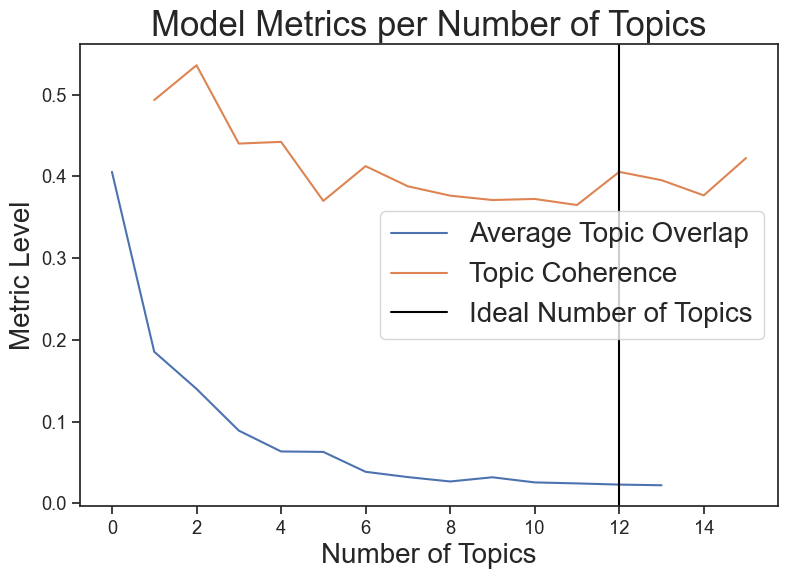

In [54]:
fig, ax1 = plt.subplots(figsize=(9, 6))

ax = sns.lineplot(x=list(LDA_topics.keys())[:-1], y=mean_stabilities, label='Average Topic Overlap')
ax = sns.lineplot(x=list(coherence_score_per_num_topics.keys()), y=coherences, label='Topic Coherence')

ax.axvline(x=ideal_topic_num, label='Ideal Number of Topics', color='black')
y_max = max(max(mean_stabilities), max(coherences)) + (0.10 * max(max(mean_stabilities), max(coherences)))
                
ax.axes.set_title('Model Metrics per Number of Topics', fontsize=25)
ax.set_ylabel('Metric Level', fontsize=20)
ax.set_xlabel('Number of Topics', fontsize=20)
plt.legend(fontsize=20)
plt.show()   

In [55]:
# Print performance
# Compute Perplexity Score
print('LDA Perplexity Score: ', lda_model.log_perplexity(corpus))
# Compute Coherence Score
coherence_model_lda = gensim.models.CoherenceModel(model=LDA_models[ideal_topic_num], texts=posts[TOKENS_COLUMN_FOR_TOPIC_MODELING], dictionary=dictionary,
                                                   coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('LDA Coherence Score: ', coherence_lda)

# Print topics
LDA_models[ideal_topic_num - 1].print_topics(NUM_OF_TOPICS, NUM_WORDS)

LDA Perplexity Score:  -11.811087089103065
LDA Coherence Score:  0.3954034267945336


[(0,
  '0.130*"wrong" + 0.028*"come" + 0.027*"intelligence" + 0.019*"train" + 0.019*"datum" + 0.016*"long" + 0.016*"interesting" + 0.015*"fact" + 0.014*"correct" + 0.013*"happen" + 0.012*"llm" + 0.012*"issue" + 0.012*"output" + 0.011*"thought" + 0.011*"end" + 0.010*"source" + 0.010*"far" + 0.010*"agi" + 0.010*"true" + 0.009*"soon" + 0.009*"consider" + 0.009*"require" + 0.009*"computer" + 0.009*"stop" + 0.008*"humanity"'),
 (1,
  '0.095*"chat" + 0.045*"news" + 0.038*"app" + 0.025*"web" + 0.020*"message" + 0.020*"break" + 0.015*"resource" + 0.014*"super" + 0.014*"hey" + 0.013*"programming" + 0.013*"speech" + 0.013*"large" + 0.012*"fix" + 0.011*"alternative" + 0.010*"action" + 0.008*"blockchain" + 0.008*"spark" + 0.008*"politician" + 0.008*"interface" + 0.008*"cybersecurity" + 0.008*"revolutionize" + 0.008*"define" + 0.007*"hit" + 0.007*"major" + 0.007*"implement"'),
 (2,
  '0.034*"play" + 0.029*"change" + 0.026*"nft" + 0.025*"post" + 0.025*"point" + 0.023*"life" + 0.022*"robot" + 0.021*"

In [114]:
ideal_topic_num = 4

In [115]:
best_num_of_topics = max(coherence_score_per_num_topics, key=coherence_score_per_num_topics.get)
print("Gensim LDA with {} topics".format(ideal_topic_num))
# ldamallet = gensim.models.wrappers.LdaMallet(mallet_path_obs, corpus=corpus, num_topics=num_of_topics,
                                             # id2word=None, random_seed=42, topic_threshold=0.05, optimize_interval=10)
lda_model = LdaModel(corpus=tqdm(corpus), id2word=dictionary, iterations=50, num_topics=ideal_topic_num,
                     passes=10, minimum_probability=0.05, alpha='auto', random_state=42)

Gensim LDA with 4 topics


  0%|          | 0/324250 [00:00<?, ?it/s]

In [116]:
# Print performance

# Compute Coherence Score
coherence_model_lda = gensim.models.CoherenceModel(model=lda_model, texts=posts[TOKENS_COLUMN_FOR_TOPIC_MODELING], dictionary=dictionary,
                                                   coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
coherence_lda_per_topic = coherence_model_lda.get_coherence_per_topic()
print('LDA Coherence Score: ', coherence_lda)

# Print topics
lda_model.print_topics(NUM_OF_TOPICS, NUM_WORDS)

LDA Coherence Score:  0.4422822620822623


[(0,
  '0.042*"human" + 0.023*"not" + 0.015*"like" + 0.013*"use" + 0.011*"wrong" + 0.010*"ask" + 0.009*"friend" + 0.007*"write" + 0.007*"new" + 0.006*"think" + 0.005*"give" + 0.005*"know" + 0.005*"answer" + 0.005*"need" + 0.005*"work" + 0.005*"question" + 0.005*"good" + 0.005*"people" + 0.005*"way" + 0.004*"openai" + 0.004*"tool" + 0.004*"race" + 0.004*"help" + 0.004*"generate" + 0.004*"try"'),
 (1,
  '0.038*"aificialintelligence" + 0.028*"openai" + 0.026*"check" + 0.013*"launch" + 0.011*"technology" + 0.011*"race" + 0.011*"generativeai" + 0.010*"friend foe" + 0.010*"chatbot" + 0.010*"elon musk" + 0.009*"tech" + 0.009*"project" + 0.009*"join" + 0.007*"aificial intelligence" + 0.007*"ready" + 0.006*"news" + 0.006*"rival" + 0.006*"arm race" + 0.006*"power" + 0.006*"microsoft" + 0.005*"china" + 0.005*"google" + 0.005*"hey friend" + 0.005*"tiktok" + 0.005*"future"'),
 (2,
  '0.034*"nft" + 0.022*"human brain" + 0.012*"web" + 0.010*"describe" + 0.010*"hire" + 0.009*"future" + 0.009*"crypto" 

In [ ]:
topics_word_prob_pairs = lda_model.show_topics(ideal_topic_num, NUM_WORDS, formatted=False)
topics = [[w[0] for w in word_prob_pairs[-1]] for word_prob_pairs in topics_word_prob_pairs]

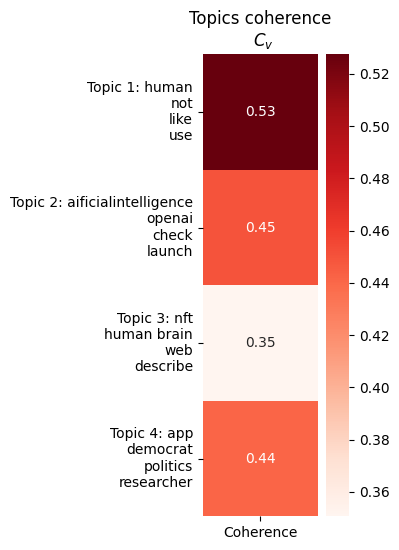

In [118]:
topics_str = ['Topic {}: {}'.format(j+1, '\n'.join(t[0: ideal_topic_num])) for j, t in enumerate(topics)]
data_topic_score = pd.DataFrame( data=zip(topics_str, coherence_lda_per_topic), columns=['Topic', 'Coherence'] )
data_topic_score = data_topic_score.set_index('Topic')

fig, ax = plt.subplots( figsize=(2,6) )
ax.set_title("Topics coherence\n $C_v$")
sns.heatmap(data=data_topic_score, annot=True, square=True,
            cmap='Reds', fmt='.2f',
            linecolor='black', ax=ax )
plt.yticks( rotation=0 )
ax.set_xlabel('')
ax.set_ylabel('')
fig.show()

In [120]:
topic_distributions = [[d[1] for d in td] for td in topic_distributions]

#### Topics distributions over time

In [121]:
topics_words_df = pd.DataFrame(topics)
topics_words_df.index += 1 
topics_words_df.columns=["Word_{}".format(i + 1) for i in range(NUM_WORDS)]
topics_words_df = topics_words_df.reset_index().rename(columns={"index": 'Topic num'})
topics_words_df

,Topic num,Word_1,Word_2,Word_3,Word_4,Word_5,Word_6,Word_7,Word_8,Word_9,...,Word_16,Word_17,Word_18,Word_19,Word_20,Word_21,Word_22,Word_23,Word_24,Word_25
0,1,human,not,like,use,wrong,ask,friend,write,new,...,question,good,people,way,openai,tool,race,help,generate,try
1,2,aificialintelligence,openai,check,launch,technology,race,generativeai,friend foe,chatbot,...,news,rival,arm race,power,microsoft,china,google,hey friend,tiktok,future
2,3,nft,human brain,web,describe,hire,future,crypto,behavior,complete,...,robot look,elonmusk,musk,danger,order custom,metaverse,smaer,log,solve captcha,resume
3,4,app,democrat,politics,researcher,trump,invitation code,chat similar,free mining,gwbwhbypxgvvlteakfyimajtp,...,read aicle,power bot,capacity,lets,future people,appreciate,chatbot chatbotai,trick chat,audit kyc,stick beginner


In [122]:
document_topics_dist = lda_model.get_document_topics(corpus, minimum_probability=0.05, minimum_phi_value=None, per_word_topics=False)
document_topics_dist_df = pd.DataFrame.from_records(document_topics_dist, columns=['Topic {}'.format(i + 1) for i in range(ideal_topic_num)])
document_topics_dist_df = document_topics_dist_df.applymap(lambda x: x[1] if x is not None else 0)
assert document_topics_dist_df.shape[0] == posts.shape[0]

In [123]:
document_topics_dist_df

,Topic 1,Topic 2,Topic 3,Topic 4
0,0.911460,0.073723,0.000000,0.0
1,0.874056,0.113393,0.000000,0.0
2,0.985381,0.000000,0.000000,0.0
3,0.982097,0.000000,0.000000,0.0
4,0.596162,0.366463,0.000000,0.0
...,...,...,...,...
324245,0.665353,0.316911,0.000000,0.0
324246,0.603890,0.206262,0.185606,0.0
324247,0.749808,0.148514,0.093104,0.0
324248,0.942780,0.000000,0.000000,0.0


In [124]:
docs_count_per_topic_above_thr = document_topics_dist_df.idxmax(axis=1).value_counts().reset_index(drop=False)
docs_count_per_topic_above_thr["index"] = docs_count_per_topic_above_thr["index"].apply(lambda x: int(x.split(" ")[-1]))
docs_count_per_topic_above_thr_df = docs_count_per_topic_above_thr.rename(columns={"index": 'Topic num', 0: 'Count'})
docs_count_per_topic_above_thr_df = docs_count_per_topic_above_thr_df.sort_values(by='Topic num')
docs_count_per_topic_above_thr_df

,Topic num,Count
0,1,256216
1,2,64106
2,3,3852
3,4,76


In [19]:
import datetime

def get_week_date_range_str(year, week):
    startdate = datetime.date.fromisocalendar(year, week, 1)
    dates = []
    for i in range(7):
        day = startdate + datetime.timedelta(days=i)
        dates.append(day.strftime("%d/%m/%Y"))
    return "{}/{}-{}/{}".format(dates[0].split("/")[0], dates[0].split("/")[1], dates[-1].split("/")[0], dates[-1].split("/")[1])

## Sentiment Analysis

In [26]:
from pysentimiento.preprocessing import preprocess_tweet

In [37]:
temp_tweets_to_process = load_existing_tweets_file("temp_tweets_to_process_04062023.csv")
posts = temp_tweets_to_process
posts.shape

(83332, 14)

In [38]:
def clean_sentence_for_sentiment_analysis(sentence, remove_urls=True, remove_retweets=True, remove_stop_words=False, handle_hashtags=True, remove_short_words=False, remove_punctuation=False,
                                          remove_numbers=True, decode_ascii=False, max_text_length=2048):
    if remove_urls:
        sentence = re.sub(pattern=get_url_patern(), repl="", string=sentence)
        sentence = re.sub(r'http\S+', "", sentence)  # remove http links
        sentence = re.sub(r'bit.ly/\S+', "", sentence)  # remove bitly links
        sentence = sentence.strip('[link]')  # remove [links]
    if remove_retweets:
        sentence = re.sub(pattern=get_mentions_pattern(), repl="", string=sentence)
        sentence = re.sub(pattern=get_twitter_reserved_words_pattern(), repl='', string=sentence)
        sentence = re.sub('(RT\s@[A-Za-z]+[A-Za-z0-9-*]+)', "", sentence)  # remove retweet
        sentence = re.sub('(@[A-Za-z]+[A-Za-z0-9-_]+)', "", sentence)  # remove tweeted at
    if remove_numbers:
        sentence = re.sub('[0-9]+', ' ', sentence)
    if remove_stop_words:
        sentence = ' '.join([word for word in sentence.split() if word not in extended_stop_wrods])
    if remove_short_words:
        sentence = ' '.join([word for word in sentence.split() if (not len(word) <= 2)])# or (word in UNICODE_EMOJI)])
    if handle_hashtags:
        sentence = preprocess_tweet(sentence, lang="en", demoji=False)
    if remove_punctuation:
        sentence = sentence.translate(str.maketrans('', '', string.punctuation))  # remove punctuation
    if decode_ascii:
        sentence=sentence.encode('ascii', 'ignore').decode('ascii')
    sentence = sentence[0:max_text_length]
    sentence = sentence.strip()

    clean_sentence = sentence
    return clean_sentence

In [39]:
def get_sentiment(sentence, analyzer_model):
    sentiment_dict = analyzer_model(sentence)[0]
    sentiment = "Positive" if sentiment_dict['label'] == "POS" else "Negative" if sentiment_dict['label'] == "NEG" else "Neutral"
    return sentiment_dict["score"], sentiment

def get_sentiment_pysentimiento(sentiment_dict):
    sentiment_label = sentiment_dict.output
    sentiment = "Positive" if sentiment_dict.output == "POS" else "Negative" if sentiment_dict.output == "NEG" else "Neutral"
    return sentiment_dict.probas[sentiment_label], sentiment

In [41]:
# Set up the inference pipeline using a model from the 🤗 Hub
sid_obj = create_analyzer(task="sentiment", lang="en")

loading configuration file config.json from cache at C:\Users\user/.cache\huggingface\hub\models--finiteautomata--bertweet-base-sentiment-analysis\snapshots\924fc4c80bccb8003d21fe84dd92c7887717f245\config.json
Model config RobertaConfig {
  "_name_or_path": "finiteautomata/bertweet-base-sentiment-analysis",
  "architectures": [
    "RobertaForSequenceClassification"
  ],
  "attention_probs_dropout_prob": 0.1,
  "bos_token_id": 0,
  "classifier_dropout": null,
  "eos_token_id": 2,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "id2label": {
    "0": "NEG",
    "1": "NEU",
    "2": "POS"
  },
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "label2id": {
    "NEG": 0,
    "NEU": 1,
    "POS": 2
  },
  "layer_norm_eps": 1e-05,
  "max_position_embeddings": 130,
  "model_type": "roberta",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 1,
  "position_embedding_type": "absolute",
  "problem

In [42]:
posts["clean_post_for_sentiment"] = posts["post"].progress_apply(lambda x: clean_sentence_for_sentiment_analysis(x, remove_stop_words=False, remove_urls=True, handle_hashtags=True, remove_retweets=True, remove_short_words=False, remove_punctuation=False,
                                          remove_numbers=True, decode_ascii=False))
print(len(posts["clean_post_for_sentiment"]))

  0%|          | 0/83332 [00:00<?, ?it/s]

83332


In [43]:
sentiment_df = posts
print("Sentiment Analysis: {} posts".format(sentiment_df.shape[0]))
sentiment_df["sentiment_score"], sentiment_df["sentiment"] = zip(*[get_sentiment_pysentimiento(output) for output in sid_obj.predict(posts["clean_post_for_sentiment"].values.tolist())])

Sentiment Analysis: 83332 posts


Map:   0%|          | 0/83332 [00:00<?, ? examples/s]

The following columns in the test set don't have a corresponding argument in `RobertaForSequenceClassification.forward` and have been ignored: text. If text are not expected by `RobertaForSequenceClassification.forward`,  you can safely ignore this message.
***** Running Prediction *****
  Num examples = 83332
  Batch size = 32


In [44]:
sentiment_df_merged = sentiment_df

In [47]:
sentiment_df_merged.to_csv("temp_tweets_to_process_04062023_with_sentiment.csv", index=False)

## Read already classified file

In [460]:
# Read old files by merge
DATE = "04062023"
posts = load_existing_tweets_file("tweets_{}_filtered_with_chatGPT_topic_classification_parsed.csv".format(DATE))
print(DATE)
from ast import literal_eval
posts["tokens"] = posts["tokens"].apply(lambda x: literal_eval(x) if "[" in x else x)
print(posts.shape)

04062023
(246811, 22)


In [ ]:
# Start the analysis from end of February 2023 (after the 8-day gap we have): 18 Feb 2023
posts["created_at"] = pd.to_datetime(posts["created_at"].replace("T", " ").replace("Z", ""), format="%Y-%m-%d")
posts = posts[posts["created_at"] >= "2023-02-06"]
posts.shape

(219847, 22)

In [463]:
# Read file with key ChatGPT-related events and dates
event_file_path = "twitter_discourse_key_dates"
key_events_dates_df = pd.read_csv("{}.csv".format(event_file_path))
key_events_dates_df.columns = [col.strip() for col in key_events_dates_df.columns]
key_events_dates_df['date'] =  pd.to_datetime(key_events_dates_df['date'], format='%m/%d/%Y', errors='coerce')
key_events_dates_df["week_num"] = key_events_dates_df['date'].dt.isocalendar().week
key_events_dates_df["week_num"] = key_events_dates_df["week_num"].map({week: get_week_date_range_str(2023, week) for week in range(1, 52)})
key_events_dates_df = key_events_dates_df[(~key_events_dates_df['date'].isnull()) & (~key_events_dates_df["keep"].isnull())]
key_events_dates_df.head()

,date,event,link,keep,week_num
1,2023-05-10,Bard made available,NaN,1.00000000,08/05-14/05
5,2023-04-17,Musk - Carlson interview: 'Starting new AI pla...,NaN,1.00000000,17/04-23/04
8,2023-03-08,Noam Chomsky: The False Promise of ChatGPT art...,https://www.nytimes.com/2023/03/08/opinion/noa...,1.00000000,06/03-12/03
10,2023-03-31,ChatGPT Is Banned in Italy Over Privacy Concerns,https://www.garanteprivacy.it/home/docweb/-/do...,1.00000000,27/03-02/04
12,2023-03-14,First public demo of ChatGPT-4,NaN,1.00000000,13/03-19/03


#### Manual Filter and sentiment label corrections

In [464]:
manual_comments_df = pd.read_csv("Drafts/all_tweets_from_last_7_days_26032023_with_sentiment_emotion_comments.csv")

# Filter garbage tweets
manual_comments_df_with_comments = manual_comments_df[~manual_comments_df["comments"].isnull()]
manual_comments_df_with_comments_junk = manual_comments_df_with_comments[manual_comments_df_with_comments["comments"] == "Junk"]
print("Junk posts: {}".format(manual_comments_df_with_comments_junk.shape[0]))
print("Before removal of manual junk: {}".format(posts.shape[0]))
posts = posts[~posts["post"].isin(manual_comments_df_with_comments_junk["post"])]
print("After removal of manual junk: {}".format(posts.shape[0]))

Junk posts: 19
Before removal of manual junk: 219847
After removal of manual junk: 219839


In [465]:
# Override manual sentiment correction
print("Before manual sentiment correction: {}".format(posts.shape[0]))
manual_comments_df_with_comments_fixed_sentiment = manual_comments_df[(~manual_comments_df["fixed_sentiment"].isnull()) & (manual_comments_df["comments"] != "Junk")]
print(manual_comments_df_with_comments_fixed_sentiment.shape[0])
for p in manual_comments_df_with_comments_fixed_sentiment["post"].values.tolist():
    fixed_sentiment =  manual_comments_df_with_comments_fixed_sentiment[manual_comments_df_with_comments_fixed_sentiment["post"] == p]["fixed_sentiment"].values[0]
    fixed_sentiment = "Neutral" if fixed_sentiment.endswith("tral") else "Negative" if "Neg" in fixed_sentiment else "Positive"
    if posts[posts["post"] == p].shape[0] > 0:
        posts[posts["post"] == p]["sentiment"] = fixed_sentiment
        
print("After manual sentiment correction: {}".format(posts.shape[0]))

Before manual sentiment correction: 219839
8
After manual sentiment correction: 219839


In [466]:
# Filter tweets with extreme engagement counts, probably ads or bots?
print("Before zero impression count filtering: {}".format(posts.shape[0]))
posts = posts[posts["impression_count"]  > 0]
print("After zero impression count filtering: {}".format(posts.shape[0]))

Before zero impression count filtering: 219839
After zero impression count filtering: 219219


In [467]:
# Filter tweets to include only tweets with confidence of sentiment and emotion above threshold
SENTIMENT_THRESHOLD = 0.5
EMOTION_THRESHOLD = 0.5

print("Before sentiment conf filtering: {}".format(posts.shape[0]))
# posts = posts[posts["sentiment_score"] > SENTIMENT_THRESHOLD]
print("After sentiment conf filtering: {}".format(posts.shape[0]))
# posts = posts[posts["emotion_score"] > EMOTION_THRESHOLD]
print("After emotion conf filtering: {}".format(posts.shape[0]))

Before sentiment conf filtering: 219219
After sentiment conf filtering: 219219
After emotion conf filtering: 219219


In [469]:
# Remove tweets with TRASH classification for their topic (classified by chatGPT)
print("Before TRASH topic filtering: {}".format(posts.shape[0]))
posts = posts[posts["gpt_classify"] != "TRASH"]
print("After TRASH topic filtering: {}".format(posts.shape[0]))

Before TRASH topic filtering: 219219
After TRASH topic filtering: 217495


In [470]:
# Calculate the metric of engagement rate
posts["engagement_count"] = posts["retweet_count"] + posts["reply_count"] + posts["like_count"] + posts["quote_count"]
# Engagements: Total number of times a user interacted with a Tweet. Clicks anywhere on the Tweet, including Retweets, replies, follows, likes, links, cards, hashtags, embedded media, username, profile photo, or Tweet expansion
# Engagement rate: Number of engagements divided by impressions
posts["engagement_rate"] = posts["engagement_count"] / posts["impression_count"]
posts["engagement_rate"][posts["engagement_rate"] > 1] = 1.0
posts["engagement_rate"].describe()

count   217495.00000000
mean         0.03515671
std          0.09022342
min          0.00000000
25%          0.00000000
50%          0.01052632
75%          0.03571429
max          1.00000000
Name: engagement_rate, dtype: float64

In [472]:
sentiment_df_merged = posts

In [473]:
sentiment_df_merged.shape

(217495, 23)

In [474]:
sentiment_df_merged["created_at"] = pd.to_datetime(sentiment_df_merged["created_at"].replace("T", " ").replace("Z", ""))
sentiment_df_merged['week_num'] = sentiment_df_merged['created_at'].dt.isocalendar().week
sentiment_df_merged["date"] = sentiment_df_merged["created_at"].dt.date
sentiment_df_merged.groupby(["week_num"]).count()

,Unnamed: 0,author_id,created_at,id,post,edit_history_tweet_ids,retweet_count,reply_count,like_count,quote_count,...,tokens,clean_post_for_sentiment,sentiment_score,sentiment,emotion,emotion_score,clean_post_for_themes_identification,gpt_classify,engagement_rate,date
week_num,,,,,,,,,,,,,,,,,,,,,
6,11770,11770,11770,11770,11770,11770,11770,11770,11770,11770,...,11770,11770,11770,11770,11770,11770,11770,11770,11770,11770
7,2563,2563,2563,2563,2563,2563,2563,2563,2563,2563,...,2563,2563,2563,2563,2563,2563,2563,2563,2563,2563
8,30061,30061,30061,30061,30061,30061,30061,30061,30061,30061,...,30061,30061,30061,30061,30061,30061,30061,30061,30061,30061
9,29410,29410,29410,29410,29410,29410,29410,29410,29410,29410,...,29410,29410,29410,29410,29410,29410,29410,29410,29410,29410
10,5994,5994,5994,5994,5994,5994,5994,5994,5994,5994,...,5994,5994,5994,5994,5994,5994,5994,5994,5994,5994
11,8616,8616,8616,8616,8616,8616,8616,8616,8616,8616,...,8616,8616,8616,8616,8616,8616,8616,8616,8616,8616
12,9578,9578,9578,9578,9578,9578,9578,9578,9578,9578,...,9578,9578,9578,9578,9578,9578,9578,9578,9578,9578
13,9427,9427,9427,9427,9427,9427,9427,9427,9427,9427,...,9427,9427,9427,9427,9427,9427,9427,9427,9427,9427
14,8827,8827,8827,8827,8827,8827,8827,8827,8827,8827,...,8827,8827,8827,8827,8827,8827,8827,8827,8827,8827


### Look at ChatGPT's theme classification

In [475]:
sentiment_df_merged["gpt_classify"] = sentiment_df_merged["gpt_classify"].replace("Different", "DIFFERENT")

In [476]:
sentiment_df_merged["gpt_classify"].value_counts()

Topic 2: Criticism, Concerns, and Limitations of ChatGPT.                 55346
DIFFERENT                                                                 44716
Topic 3: AI in Education, Employment, and Various Industries.             32182
Topic 4: Comparison, Integration, and Advancements of AI Technologies.    29923
Topic 1: ChatGPT's Description, Functionality, and Applications.          28991
Topic 5: Ethics, Bias, and Regulation of AI.                              26337
Name: gpt_classify, dtype: int64

### Plot emotion percentage over week time

In [477]:
emotion_df_pivt = sentiment_df_merged.groupby(['week_num', 'emotion']).size().reset_index().pivot(columns='emotion', index='week_num', values=0)
emotion_df_total = emotion_df_pivt.sum(axis=1).reset_index().set_index("week_num").rename(columns={0: "total"})
emotion_df_pivt_all = pd.concat([emotion_df_pivt, emotion_df_total], axis=1)
emotion_df_rel = emotion_df_pivt_all[emotion_df_pivt_all.columns[0:-1]].div(emotion_df_pivt_all[emotion_df_pivt_all.columns[-1]], 0)*100
emotion_df_rel = emotion_df_rel[["anger", "disgust", "fear", "joy", "sadness", "surprise", "neutral"]]
emotion_df_rel.head()

,anger,disgust,fear,joy,sadness,surprise,neutral
week_num,,,,,,,
6,4.98725573,2.80373832,16.73746814,14.51146984,2.00509771,9.15887850,49.79609176
7,6.08661725,3.19937573,19.07920406,15.52867733,2.96527507,8.19352321,44.94732735
8,5.82149629,2.59805063,19.25750973,16.07398290,3.26669106,8.19999335,44.78227604
9,4.15844951,1.93471608,17.13702822,22.52295138,2.71676301,9.31995920,42.21013261
10,6.90690691,6.32298966,14.58124791,9.47614281,3.85385385,8.32499166,50.53386720


In [478]:
emotion_df_pivt_with_engagement_rate = sentiment_df_merged.groupby(['week_num', 'emotion']).agg({'engagement_rate' : 'sum'}).reset_index().pivot(columns='emotion', index='week_num', values="engagement_rate")
emotion_df_total_with_engagement_rate = emotion_df_pivt_with_engagement_rate.sum(axis=1).reset_index().set_index("week_num").rename(columns={"engagement_rate": "total"})
emotion_df_pivt_all_with_engagement_rate = pd.concat([emotion_df_pivt_with_engagement_rate, emotion_df_total_with_engagement_rate], axis=1)
emotion_df_rel_with_engagement_rate = emotion_df_pivt_all_with_engagement_rate[emotion_df_pivt_all_with_engagement_rate.columns[0:-1]].div(emotion_df_pivt_all_with_engagement_rate[emotion_df_pivt_all_with_engagement_rate.columns[-1]], 0)*100
emotion_df_rel_with_engagement_rate = emotion_df_rel_with_engagement_rate[["anger", "disgust", "fear", "joy", "sadness", "surprise", "neutral"]]
emotion_df_rel_with_engagement_rate.head()

,anger,disgust,fear,joy,sadness,surprise,neutral
week_num,,,,,,,
6,5.77087001,2.51774290,19.70912493,17.00079925,2.10266206,8.12841912,44.77038174
7,5.61386033,1.62734772,24.07954399,14.78676801,9.86592184,7.26144937,36.76510873
8,4.46047909,2.05472344,23.44664117,16.49225557,9.90661672,6.14380336,37.49548066
9,3.94913677,1.86140403,21.12311237,22.40800923,2.34641385,6.99492008,41.31700366
10,7.38344723,6.65068057,13.84949259,11.02258647,4.16036987,7.48361721,49.44980607


In [479]:
emotion_df_pivt_with_engagement_rate_date = sentiment_df_merged.groupby(['date', 'emotion']).agg({'engagement_rate' : 'sum'}).reset_index().pivot(columns='emotion', index='date', values="engagement_rate")
emotion_df_total_with_engagement_rate_date = emotion_df_pivt_with_engagement_rate_date.sum(axis=1).reset_index().set_index("date").rename(columns={"engagement_rate": "total"})
emotion_df_pivt_all_with_engagement_rate_date = pd.concat([emotion_df_pivt_with_engagement_rate_date, emotion_df_total_with_engagement_rate_date], axis=1)
emotion_df_rel_with_engagement_rate_date = emotion_df_pivt_all_with_engagement_rate_date[emotion_df_pivt_all_with_engagement_rate_date.columns[0:-1]].div(emotion_df_pivt_all_with_engagement_rate_date[emotion_df_pivt_all_with_engagement_rate_date.columns[-1]], 0)*100
emotion_df_rel_with_engagement_rate_date = emotion_df_rel_with_engagement_rate_date[["anger", "disgust", "fear", "joy", "sadness", "surprise", "neutral"]]
emotion_df_rel_with_engagement_rate_date.head()

,anger,disgust,fear,joy,sadness,surprise,neutral
date,,,,,,,
2023-02-06,6.22407433,2.88687166,19.44655580,16.91248283,2.41779376,8.40577080,43.70645082
2023-02-07,5.12884869,2.01868448,20.17626862,17.87383494,1.78236299,7.98882809,45.03117220
2023-02-08,8.38822588,2.26505361,21.54393570,9.96610266,1.05587864,1.98732128,54.79348223
2023-02-09,5.01626792,3.26226966,14.46972967,0.89142325,0.36066883,6.93461483,69.06502585
2023-02-19,5.61386033,1.62734772,24.07954399,14.78676801,9.86592184,7.26144937,36.76510873


In [480]:
emotion_df_chng_pct = emotion_df_rel.pct_change() * 100
emotion_df_chng_pct

,anger,disgust,fear,joy,sadness,surprise,neutral
week_num,,,,,,,
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,22.04341564,14.11106776,13.99098059,7.00967927,47.88681167,-10.54010367,-9.73723888
8,-4.35580132,-18.79507603,0.93455509,3.51160346,10.16485777,0.07896642,-0.36721051
9,-28.56734250,-25.53201003,-11.01119272,40.12053836,-16.83440660,13.65813121,-5.74366392
10,66.09332145,226.81744427,-14.91378945,-57.92672705,41.85462058,-10.67566411,19.71975466
11,13.09040814,-8.22131250,-0.98066712,0.92294715,4.80410954,5.81622856,-1.97515015
12,-13.11813197,-7.16525371,0.22445596,0.76398786,33.12476149,4.53402354,-0.81217442
13,15.82603161,1.01107408,13.55062085,-10.72692817,-18.52128929,-13.25834248,0.32798162
14,9.39159342,11.37732869,-5.33716648,-7.55644498,-7.16648869,4.66988960,0.22447608


In [481]:
emotion_df_sma = sentiment_df_merged[["date", "emotion"]]
emotion_df_sma = emotion_df_sma.groupby(['date', 'emotion']).size().reset_index().pivot(columns='emotion', index='date', values=0)

emotion_df_sma_total = emotion_df_sma.sum(axis=1).reset_index().set_index("date").rename(columns={0: "total"})
emotion_df_sma_pivt_all = pd.concat([emotion_df_sma, emotion_df_sma_total], axis=1)
emotion_df_sma_rel = emotion_df_sma_pivt_all[emotion_df_sma_pivt_all.columns[0:-1]].div(emotion_df_sma_pivt_all[emotion_df_sma_pivt_all.columns[-1]], 0)*100
emotion_df_sma_rel = emotion_df_sma_rel[["anger", "disgust", "fear", "joy", "sadness", "surprise", "neutral"]]
emotion_df_chng_pct_daily = emotion_df_sma_rel.pct_change() * 100
emotion_df_chng_pct_daily

,anger,disgust,fear,joy,sadness,surprise,neutral
date,,,,,,,
2023-02-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-07,-11.65358907,-44.61629106,-1.91643852,3.91952827,-24.73118280,2.96292239,4.48242502
2023-02-08,70.25171625,152.35892692,-16.25158295,-36.65757242,28.36438923,-67.88159112,15.94202899
2023-02-09,-43.20987654,-30.30303030,19.79166667,-59.34343434,-23.33333333,119.04761905,7.90123457
2023-02-19,36.94888802,-4.01872805,14.47522435,299.30884566,77.91650410,22.90284822,-29.03053576
...,...,...,...,...,...,...,...
2023-05-31,-11.03354664,13.88115307,-1.28243064,0.24910130,15.98730554,-1.35963310,0.33991784
2023-06-01,-9.28034543,-36.66741096,-1.34450437,13.53905107,-21.95929402,13.55593125,-2.29739660
2023-06-02,1.76767677,36.23737374,-8.66788321,2.42424242,43.63295880,-2.96208531,-1.36924804


In [482]:
for col in emotion_df_chng_pct_daily.columns:
    emotion_df_chng_pct_daily['{}_SMA_5'.format(col)] = emotion_df_chng_pct_daily.loc[:, col].rolling(window=5).mean()
emotion_df_chng_pct_daily_only_sma = emotion_df_chng_pct_daily[[col for col in emotion_df_chng_pct_daily.columns if "SMA" in col]]
emotion_df_chng_pct_daily_only_sma.columns = [col.split("_SMA")[0] for col in emotion_df_chng_pct_daily_only_sma.columns]
emotion_df_chng_pct_daily_only_sma

,anger,disgust,fear,joy,sadness,surprise,neutral
date,,,,,,,
2023-02-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
2023-05-31,11.38330659,10.19649133,2.17068928,0.91331329,3.93069275,0.04071840,-0.75879650
2023-06-01,-5.17846062,-11.65212009,6.65812272,4.83914842,-4.66430213,1.73744524,-0.79764520
2023-06-02,-6.51554347,-3.07392442,4.39762730,9.03199460,-1.11625939,-0.54559003,-1.12575360


In [483]:
emotion_df_rel_with_engagement_rate_date_sma = copy.copy(emotion_df_rel_with_engagement_rate_date)
for col in emotion_df_rel_with_engagement_rate_date_sma.columns:
    emotion_df_rel_with_engagement_rate_date_sma['{}_SMA_5'.format(col)] = emotion_df_rel_with_engagement_rate_date_sma.loc[:, col].rolling(window=5).mean()
emotion_df_rel_with_engagement_rate_date_sma = emotion_df_rel_with_engagement_rate_date_sma[[col for col in emotion_df_rel_with_engagement_rate_date_sma.columns if "SMA" in col]]
emotion_df_rel_with_engagement_rate_date_sma.columns = [col.split("_SMA")[0] for col in emotion_df_rel_with_engagement_rate_date_sma.columns]
emotion_df_rel_with_engagement_rate_date_sma

,anger,disgust,fear,joy,sadness,surprise,neutral
date,,,,,,,
2023-02-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-02-19,6.07425543,2.41204542,19.94320675,12.08612234,3.09652521,6.51559687,49.87224797
...,...,...,...,...,...,...,...
2023-05-31,5.92432142,2.66862610,17.30511426,15.68594553,3.25194963,9.12177004,46.04227302
2023-06-01,5.81943529,2.34519603,18.65832405,15.95097866,2.96038588,9.61855187,44.64712823
2023-06-02,5.31428285,2.10989533,20.00682211,16.92923550,3.20857203,10.16736182,42.26383036


In [484]:
import datetime

def get_week_date_range_str(year, week):
    startdate = datetime.date.fromisocalendar(year, week, 1)
    dates = []
    for i in range(7):
        day = startdate + datetime.timedelta(days=i)
        dates.append(day.strftime("%d/%m/%Y"))
    if week == 0:
        return ""
    return "{}/{}-{}/{}".format(dates[0].split("/")[0], dates[0].split("/")[1], dates[-1].split("/")[0], dates[-1].split("/")[1])

In [485]:
# Rename the xticks labels
week_map_dict = {week: get_week_date_range_str(2023, week) for week in range(1, 52)}
emotion_df_rel = emotion_df_rel.rename(index=week_map_dict)

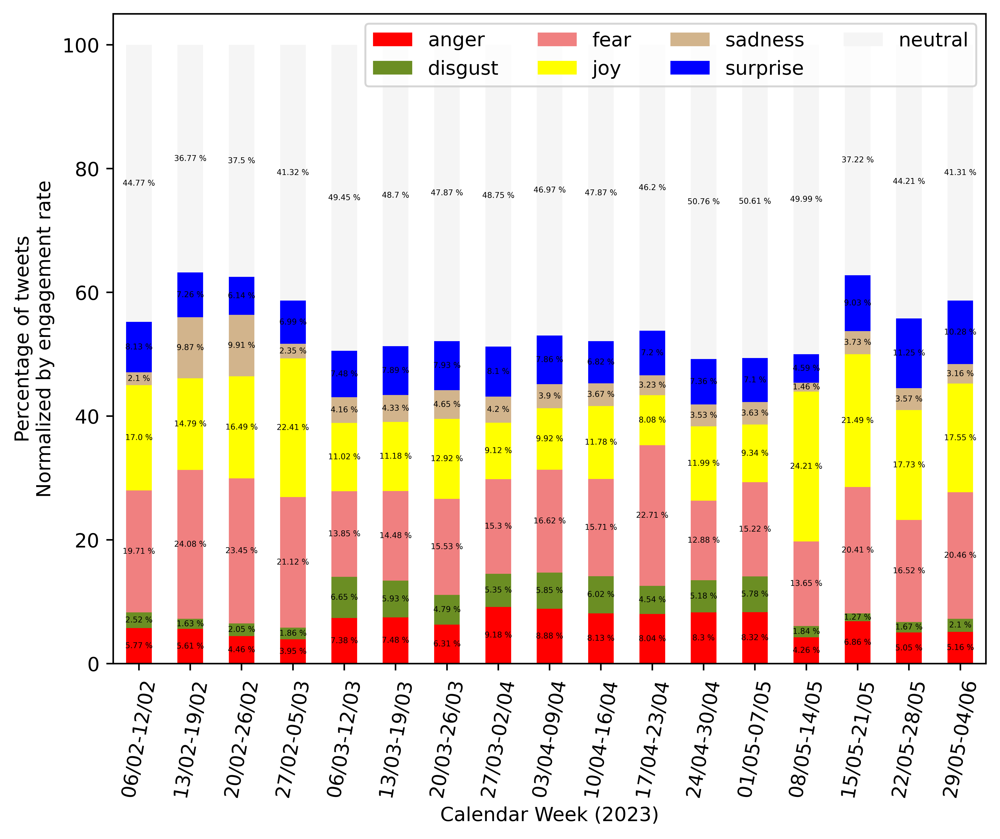

In [487]:
week_map_dict = {week: get_week_date_range_str(2023, week) for week in range(1, 52)}
emotion_df_rel_with_engagement_rate = emotion_df_rel_with_engagement_rate.rename(index=week_map_dict)

fig, ax = plt.subplots(figsize=(8, 6), dpi=700)
plt.style.use('default')

emotion_df_rel_with_engagement_rate.plot(kind='bar', stacked=True, ax=ax, color=['red', 'olivedrab', 'lightcoral', 'yellow', 'tan', "blue", 'whitesmoke'])
plt.ylabel("Percentage of tweets\nNormalized by engagement rate")
plt.xlabel("Calendar Week (2023)")
plt.xticks(rotation = 80)

for ix, row in emotion_df_rel_with_engagement_rate.reset_index(drop=True).iterrows():
    cumulative = 0
    for element in row:
        if element > 0.1:
            plt.text(
                ix,
                cumulative + element / 2,
                f"{round(element, 2)} %",
                va="center",
                ha="center",
                fontsize=4,
            )
        cumulative += element
plt.legend(ncols=4, loc="upper right")

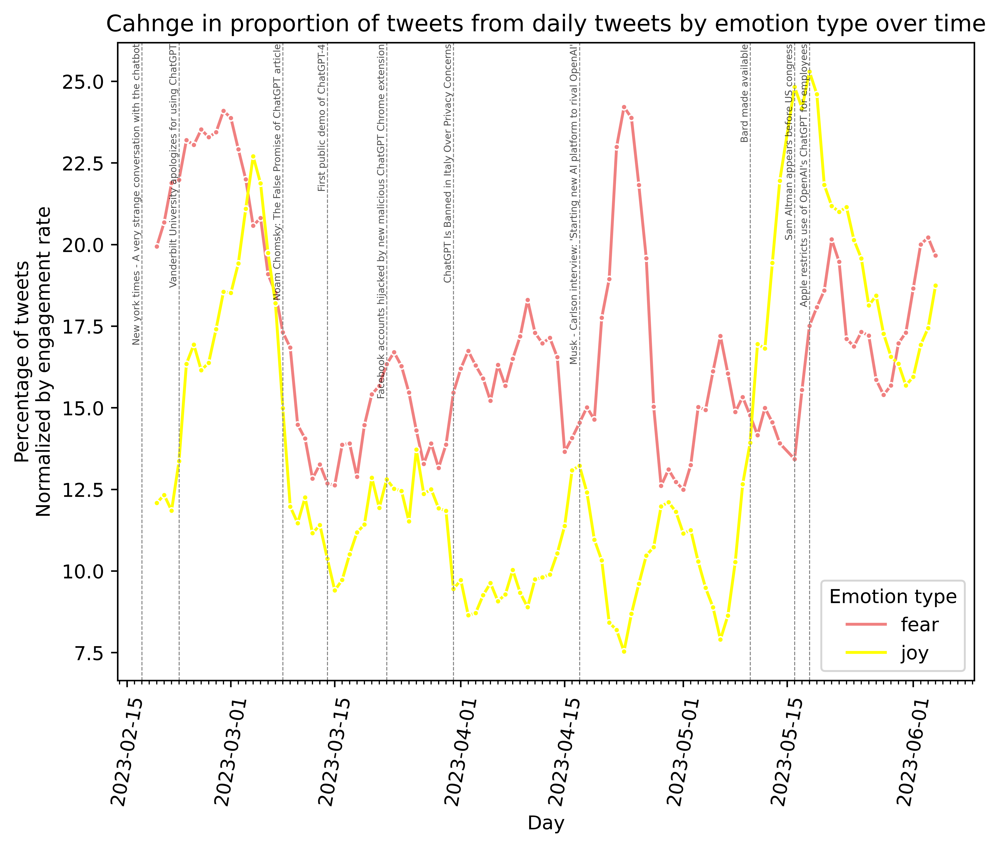

In [491]:

import matplotlib.dates as mdates
fig, ax = plt.subplots(figsize=(8, 6), dpi=750)
plt.style.use('default')

ecp = emotion_df_rel_with_engagement_rate_date_sma.reset_index().melt(id_vars="date", var_name="type", value_name="value")
ecp = ecp[ecp["type"].isin(["fear", "joy"])]
g = sns.lineplot(data=ecp, x="date", y="value", hue="type", marker=".", palette=['lightcoral', 'yellow'], #'olivedrab', ],
                 err_style="bars", errorbar=("ci", 95))

# vertical lines when something happened
plotted_dates = []
for i, event in key_events_dates_df.iterrows():
    date = event["date"]
    event_desc = event["event"]
    if str(date) < str(ax.get_xticklabels()[0]).split(",")[-1].replace(")", "").replace("'", "").strip():
        continue
    if date in plotted_dates:
        continue
    ax.axvline(date, color='gray', linestyle='--', linewidth=0.5)
    offset = (-5, -0.5)
    ax.annotate(event_desc, xy=(date, plt.ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
    plotted_dates.append(date)
    
min_loc = mdates.DayLocator()
ax.xaxis.set_minor_locator(min_loc)

plt.xlabel("Day")
plt.ylabel("Percentage of tweets\nNormalized by engagement rate")
plt.title("Cahnge in proportion of tweets from daily tweets by emotion type over time")
plt.xticks(rotation = 80)
plt.legend(title="Emotion type", loc="lower right")

### Plot sentiment percentage over week time

In [493]:
sentiment_df_pivt = sentiment_df_merged.groupby(['week_num', 'sentiment']).size().reset_index().pivot(columns='sentiment', index='week_num', values=0)
sentiment_df_total = sentiment_df_pivt.sum(axis=1).reset_index().set_index("week_num").rename(columns={0: "total"})
sentiment_df_pivt_all = pd.concat([sentiment_df_pivt, sentiment_df_total], axis=1)
sentiment_df_rel = sentiment_df_pivt_all[sentiment_df_pivt_all.columns[0:-1]].div(sentiment_df_pivt_all[sentiment_df_pivt_all.columns[-1]], 0)*100
sentiment_df_rel_weeks = sentiment_df_rel[["Negative", "Positive", "Neutral"]]
sentiment_df_rel_weeks.head()

,Negative,Positive,Neutral
week_num,,,
6,17.25573492,29.50722175,53.23704333
7,22.04447913,27.89699571,50.05852517
8,20.21888826,29.68630451,50.09480723
9,13.84903094,31.75450527,54.39646379
10,30.03003003,24.67467467,45.29529530


In [494]:
sentiment_df_chng_ratio = copy.copy(sentiment_df_rel)
sentiment_df_chng_ratio["pos_to_neg_ratio"] = sentiment_df_chng_ratio["Positive"] / sentiment_df_chng_ratio["Negative"]
pct_chng_in_ratio = sentiment_df_chng_ratio[["pos_to_neg_ratio"]].pct_change().rename(columns={"pos_to_neg_ratio": "pos_to_neg_ratio_change"}) * 100
sentiment_df_chng_ratio = pd.concat([sentiment_df_chng_ratio, pct_chng_in_ratio], axis=1)
sentiment_df_chng_ratio

,Negative,Neutral,Positive,pos_to_neg_ratio,pos_to_neg_ratio_change
week_num,,,,,
6,17.25573492,53.23704333,29.50722175,1.70999508,NaN
7,22.04447913,50.05852517,27.89699571,1.26548673,-25.99471524
8,20.21888826,50.09480723,29.68630451,1.46824613,16.02224692
9,13.84903094,54.39646379,31.75450527,2.29290449,56.16622040
10,30.03003003,45.29529530,24.67467467,0.82166667,-64.16481065
11,32.86908078,42.85051068,24.28040854,0.73870056,-10.09729432
12,32.10482355,43.61035707,24.28481938,0.75642276,2.39910460
13,33.95565928,42.90866660,23.13567413,0.68134958,-9.92476556
14,36.32038065,42.13209471,21.54752464,0.59326263,-12.92830413


In [495]:
sentiment_df_pivt = sentiment_df_merged.groupby(['date', 'sentiment']).size().reset_index().pivot(columns='sentiment', index='date', values=0)
sentiment_df_total = sentiment_df_pivt.sum(axis=1).reset_index().set_index("date").rename(columns={0: "total"})
sentiment_df_pivt_all = pd.concat([sentiment_df_pivt, sentiment_df_total], axis=1)
sentiment_df_rel = sentiment_df_pivt_all[sentiment_df_pivt_all.columns[0:-1]].div(sentiment_df_pivt_all[sentiment_df_pivt_all.columns[-1]], 0)*100
sentiment_df_rel = sentiment_df_rel[["Negative", "Positive", "Neutral"]]
sentiment_df_rel

,Negative,Positive,Neutral
date,,,
2023-02-06,19.92187500,29.07812500,51.00000000
2023-02-07,13.54838710,30.56451613,55.88709677
2023-02-08,22.60869565,21.73913043,55.65217391
2023-02-09,17.77777778,25.55555556,56.66666667
2023-02-19,22.04447913,27.89699571,50.05852517
...,...,...,...
2023-05-31,20.38976149,36.06748109,43.54275742
2023-06-01,17.13017751,38.60946746,44.26035503
2023-06-02,17.59615385,38.14102564,44.26282051


In [496]:
sentiment_df_pivt_with_engagement_rate = sentiment_df_merged.groupby(['date', 'sentiment']).agg({'engagement_rate' : 'sum'}).reset_index().pivot(columns='sentiment', index='date', values="engagement_rate")
sentiment_df_total_with_engagement_rate = sentiment_df_pivt_with_engagement_rate.sum(axis=1).reset_index().set_index("date").rename(columns={"engagement_rate": "total"})
sentiment_df_pivt_all_with_engagement_rate = pd.concat([sentiment_df_pivt_with_engagement_rate, sentiment_df_total_with_engagement_rate], axis=1)
sentiment_df_rel_with_engagement_rate = sentiment_df_pivt_all_with_engagement_rate[sentiment_df_pivt_all_with_engagement_rate.columns[0:-1]].div(sentiment_df_pivt_all_with_engagement_rate[sentiment_df_pivt_all_with_engagement_rate.columns[-1]], 0)*100
sentiment_df_rel_with_engagement_rate = sentiment_df_rel_with_engagement_rate[["Negative", "Positive", "Neutral"]]
sentiment_df_rel_with_engagement_rate

,Negative,Positive,Neutral
date,,,
2023-02-06,18.36924709,31.37209641,50.25865650
2023-02-07,14.20032782,31.85640787,53.94326430
2023-02-08,16.76571885,19.62503382,63.60924733
2023-02-09,15.72636434,26.39908851,57.87454715
2023-02-19,14.31076638,34.43548850,51.25374512
...,...,...,...
2023-05-31,15.34010686,37.62101954,47.03887359
2023-06-01,15.03611467,38.77857396,46.18531138
2023-06-02,14.81967675,39.79029598,45.39002727


In [497]:
sentiment_df_pivt_with_engagement_rate_weekly = sentiment_df_merged.groupby(['week_num', 'sentiment']).agg({'engagement_rate' : 'sum'}).reset_index().pivot(columns='sentiment', index='week_num', values="engagement_rate")
sentiment_df_total_with_engagement_rate_weekly = sentiment_df_pivt_with_engagement_rate_weekly.sum(axis=1).reset_index().set_index("week_num").rename(columns={"engagement_rate": "total"})
sentiment_df_pivt_all_with_engagement_rate_weekly = pd.concat([sentiment_df_pivt_with_engagement_rate_weekly, sentiment_df_total_with_engagement_rate_weekly], axis=1)
sentiment_df_rel_with_engagement_rate_weekly = sentiment_df_pivt_all_with_engagement_rate_weekly[sentiment_df_pivt_all_with_engagement_rate_weekly.columns[0:-1]].div(sentiment_df_pivt_all_with_engagement_rate_weekly[sentiment_df_pivt_all_with_engagement_rate_weekly.columns[-1]], 0)*100
sentiment_df_rel_with_engagement_rate_weekly = sentiment_df_rel_with_engagement_rate_weekly[["Negative", "Positive", "Neutral"]]
sentiment_df_rel_with_engagement_rate_weekly

,Negative,Positive,Neutral
week_num,,,
6,16.54977508,31.35857822,52.09164670
7,14.31076638,34.43548850,51.25374512
8,19.12559116,32.75257791,48.12183093
9,13.19171275,37.36441255,49.44387470
10,30.06323540,25.08854658,44.84821802
11,31.44627787,26.52392012,42.02980201
12,28.67218189,29.48941752,41.83840059
13,33.42677403,26.83434203,39.73888394
14,35.05027070,23.32428238,41.62544692


In [498]:
sentiment_df_rel_sma = copy.copy(sentiment_df_rel_with_engagement_rate)
for col in sentiment_df_rel_sma.columns:
    sentiment_df_rel_sma['{}_SMA_5'.format(col)] = sentiment_df_rel_sma.loc[:, col].rolling(window=5).mean()
sentiment_df_chng_pct_daily_only_sma = sentiment_df_rel_sma[[col for col in sentiment_df_rel_sma.columns if "SMA" in col]]
sentiment_df_chng_pct_daily_only_sma.columns = [col.split("_SMA")[0] for col in sentiment_df_chng_pct_daily_only_sma.columns]
sentiment_df_chng_pct_daily_only_sma

,Negative,Positive,Neutral
date,,,
2023-02-06,NaN,NaN,NaN
2023-02-07,NaN,NaN,NaN
2023-02-08,NaN,NaN,NaN
2023-02-09,NaN,NaN,NaN
2023-02-19,15.87448490,28.73762302,55.38789208
...,...,...,...
2023-05-31,19.08190797,34.60316298,46.31492905
2023-06-01,18.09172267,35.12034220,46.78793513
2023-06-02,16.36097455,37.61104814,46.02797732


In [499]:
sentiment_df_chng_pct_daily_only_sma["pos_to_neg_ratio"] = sentiment_df_chng_pct_daily_only_sma["Positive"] / sentiment_df_chng_pct_daily_only_sma["Negative"]
sentiment_sma_pct_chng_in_ratio = sentiment_df_chng_pct_daily_only_sma[["pos_to_neg_ratio"]].pct_change().rename(columns={"pos_to_neg_ratio": "pos_to_neg_ratio_change"}) * 100
sentiment_df_chng_ratio_sma = pd.concat([sentiment_df_chng_pct_daily_only_sma, sentiment_sma_pct_chng_in_ratio], axis=1)
sentiment_df_chng_ratio_sma

,Negative,Positive,Neutral,pos_to_neg_ratio,pos_to_neg_ratio_change
date,,,,,
2023-02-06,NaN,NaN,NaN,NaN,NaN
2023-02-07,NaN,NaN,NaN,NaN,NaN
2023-02-08,NaN,NaN,NaN,NaN,NaN
2023-02-09,NaN,NaN,NaN,NaN,NaN
2023-02-19,15.87448490,28.73762302,55.38789208,1.81030271,NaN
...,...,...,...,...,...
2023-05-31,19.08190797,34.60316298,46.31492905,1.81340163,-6.02385411
2023-06-01,18.09172267,35.12034220,46.78793513,1.94123815,7.04954252
2023-06-02,16.36097455,37.61104814,46.02797732,2.29882688,18.42065269


In [ ]:
pos_and_neg_sentiment_df = sentiment_df_merged[sentiment_df_merged["sentiment"].isin(["Negative", "Positive"])]
pos_and_neg_sentiment_df["pol_sentiment_score"] = pos_and_neg_sentiment_df[["sentiment", "sentiment_score"]].apply(lambda x: x[1] * -1 if x[0] == "Negative" else x[1], axis=1)

In [502]:
sentiment_df_rel_weeks = sentiment_df_rel_weeks.rename(index=week_map_dict)

In [503]:
sentiment_df_rel_weeks

,Negative,Positive,Neutral
week_num,,,
06/02-12/02,17.25573492,29.50722175,53.23704333
13/02-19/02,22.04447913,27.89699571,50.05852517
20/02-26/02,20.21888826,29.68630451,50.09480723
27/02-05/03,13.84903094,31.75450527,54.39646379
06/03-12/03,30.03003003,24.67467467,45.29529530
13/03-19/03,32.86908078,24.28040854,42.85051068
20/03-26/03,32.10482355,24.28481938,43.61035707
27/03-02/04,33.95565928,23.13567413,42.90866660
03/04-09/04,36.32038065,21.54752464,42.13209471


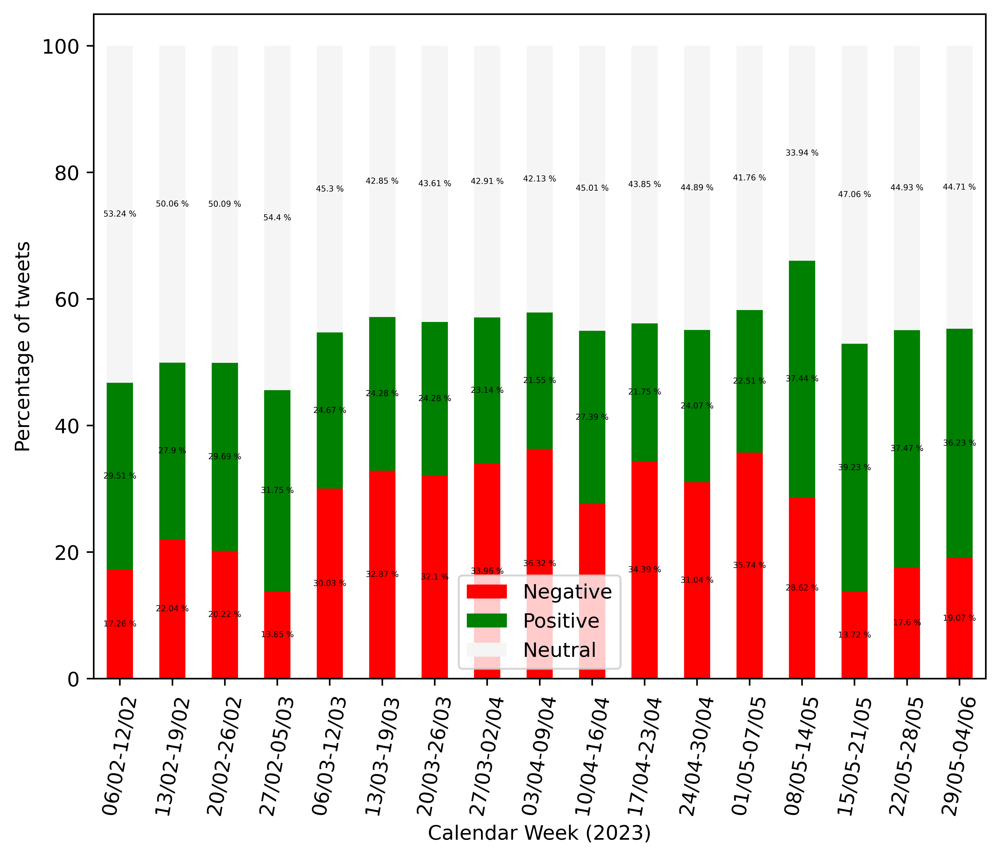

In [504]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=700)
plt.style.use('default')

sentiment_df_rel_weeks.plot(kind='bar', stacked=True, ax=ax, color=['red', 'green', 'whitesmoke'])
plt.ylabel("Percentage of tweets")
plt.xlabel("Calendar Week (2023)")
plt.xticks(rotation = 80)

for ix, row in sentiment_df_rel_weeks.reset_index(drop=True).iterrows():
    cumulative = 0
    for element in row:
        if element > 0.1:
            plt.text(
                ix,
                cumulative + element / 2,
                f"{round(element, 2)} %",
                va="center",
                ha="center",
                fontsize=4,
            )
        cumulative += element

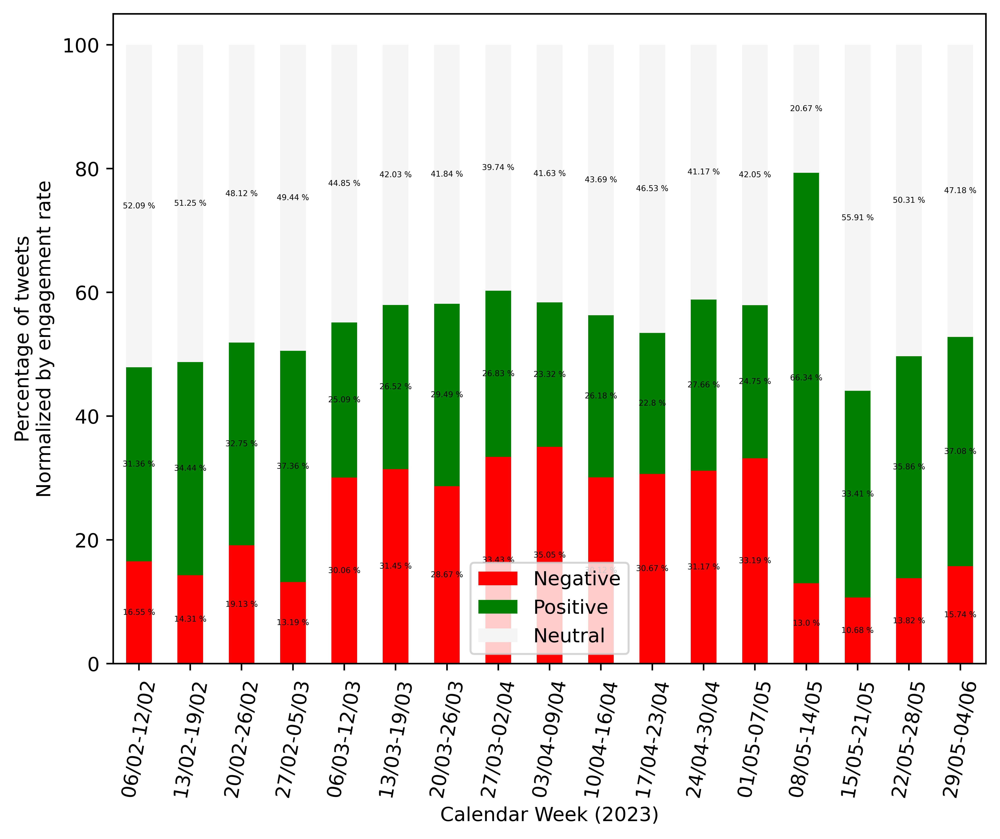

In [505]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=700)
plt.style.use('default')

sentiment_df_rel_with_engagement_rate_weekly = sentiment_df_rel_with_engagement_rate_weekly.rename(index=week_map_dict)
sentiment_df_rel_with_engagement_rate_weekly.plot(kind='bar', stacked=True, ax=ax, color=['red', 'green', 'whitesmoke'])
plt.ylabel("Percentage of tweets\nNormalized by engagement rate")
plt.xlabel("Calendar Week (2023)")
plt.xticks(rotation = 80)

for ix, row in sentiment_df_rel_with_engagement_rate_weekly.reset_index(drop=True).iterrows():
    cumulative = 0
    for element in row:
        if element > 0.1:
            plt.text(
                ix,
                cumulative + element / 2,
                f"{round(element, 2)} %",
                va="center",
                ha="center",
                fontsize=4,
            )
        cumulative += element

In [507]:
from datetime import date, timedelta

def monday_of_calenderweek(year, week):
    first = date(year, 1, 1)
    base = 1 if first.isocalendar()[1] == 1 else 8
    return first + timedelta(days=base - first.isocalendar()[2] + 7 * (week - 1)) + timedelta(days=1)
print(monday_of_calenderweek(2023, 5))
sentiment_df_chng_ratio_new_weeks = sentiment_df_chng_ratio.reset_index()
sentiment_df_chng_ratio_new_weeks["week_first_day"] = sentiment_df_chng_ratio_new_weeks["week_num"].apply(lambda x: monday_of_calenderweek(2023, int(x)))
sentiment_df_chng_ratio_new_weeks = sentiment_df_chng_ratio_new_weeks.set_index("week_first_day")
sentiment_df_chng_ratio_new_weeks.head()

2023-01-31


,week_num,Negative,Neutral,Positive,pos_to_neg_ratio,pos_to_neg_ratio_change
week_first_day,,,,,,
2023-02-07,6,17.25573492,53.23704333,29.50722175,1.70999508,NaN
2023-02-14,7,22.04447913,50.05852517,27.89699571,1.26548673,-25.99471524
2023-02-21,8,20.21888826,50.09480723,29.68630451,1.46824613,16.02224692
2023-02-28,9,13.84903094,54.39646379,31.75450527,2.29290449,56.16622040
2023-03-07,10,30.03003003,45.29529530,24.67467467,0.82166667,-64.16481065


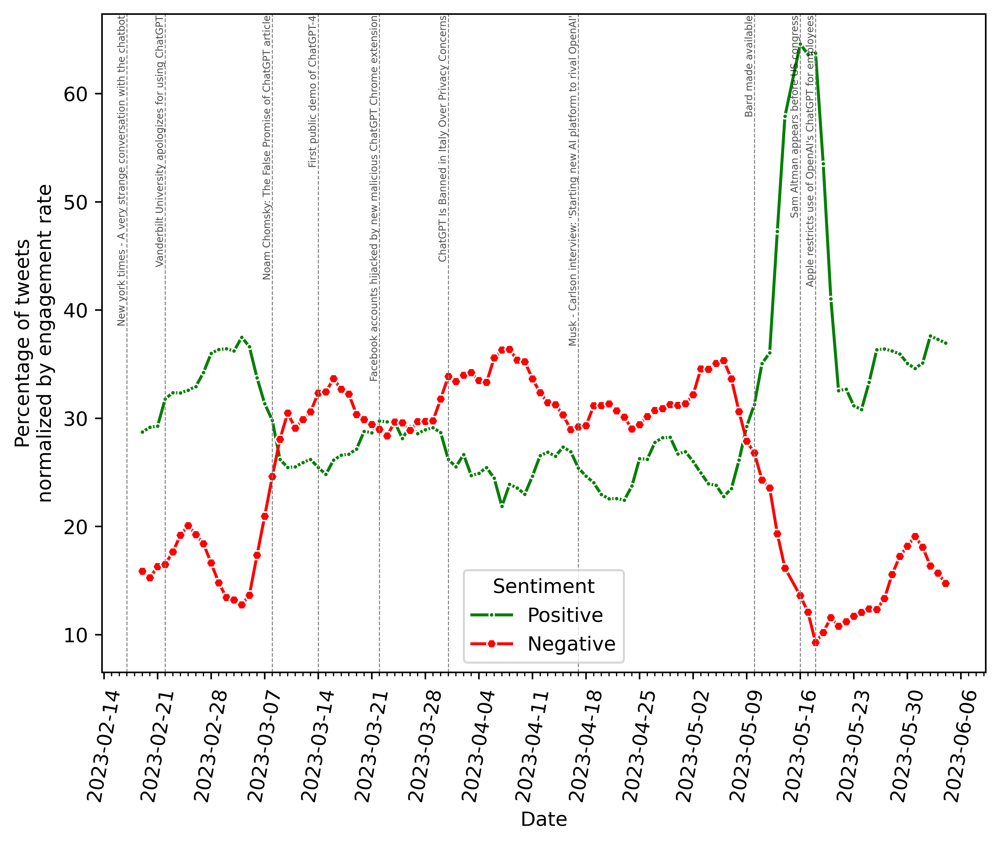

In [508]:
import matplotlib.ticker as ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(figsize=(8, 6), dpi=700)
plt.style.use('default')

sentiment_df_chng_pct_daily_only_sma.index = pd.to_datetime(sentiment_df_chng_pct_daily_only_sma.index).date
# ax = sentiment_df_chng_pct_daily_only_sma.plot(ax=ax, color=['red', 'green', 'whitesmoke'])
ax = sns.lineplot(
    data=sentiment_df_chng_pct_daily_only_sma,
    x=sentiment_df_chng_pct_daily_only_sma.index, y="Positive", color="green", marker=".",
    markers=True, dashes=False, markersize=5, err_style="bars", errorbar=("se", 2), ax=ax, label="Positive")
ax=  sns.lineplot(
    data=sentiment_df_chng_pct_daily_only_sma,
    x=sentiment_df_chng_pct_daily_only_sma.index, y="Negative", color="red", marker="H",
    markers=True, dashes=False, markersize=5, err_style="bars", errorbar=("se", 2), ax=ax, label="Negative")

# vertical lines when something happened
plotted_dates = []
for i, event in key_events_dates_df.iterrows():
    date = event["date"]
    event_desc = event["event"]
    if str(date) < str(ax.get_xticklabels()[0]).split(",")[-1].replace(")", "").replace("'", "").strip():
        continue
    if date in plotted_dates:
        continue
    ax.axvline(date, color='gray', linestyle='--', linewidth=0.5)
    offset = (-5, -0.5)
    ax.annotate(event_desc, xy=(date, plt.ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
    plotted_dates.append(date)

ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
min_loc = mdates.DayLocator()
ax.xaxis.set_minor_locator(min_loc)

# ax.set_title("Public reation on ChatGPT: A story of a crisis")
ax.set_ylabel("Percentage of tweets\nnormalized by engagement rate")
ax.set_xlabel("Date")
plt.xticks(rotation = 80)
ax.xaxis.grid(True) 
ax.yaxis.grid(True)
ax.legend(title='Sentiment')
ax.grid()

In [511]:
pos_and_neg_sentiment_df = pos_and_neg_sentiment_df[["week_num", "sentiment", "pol_sentiment_score"]].set_index("week_num").sort_values("week_num", ascending=True).rename(index=week_map_dict).reset_index()

### Per topic counts

In [515]:
themes_topics_order = {"Topic 1: ChatGPT's Description, Functionality, and Applications.": 1,
                      "Topic 2: Criticism, Concerns, and Limitations of ChatGPT.": 2,
                      "Topic 3: AI in Education, Employment, and Various Industries.": 3,
                      "Topic 4: Comparison, Integration, and Advancements of AI Technologies.": 4,
                      "Topic 5: Ethics, Bias, and Regulation of AI.": 5,
                      "DIFFERENT": 6}

In [516]:
sentiment_df_merged["gpt_classify"] = sentiment_df_merged["gpt_classify"].replace("Different", "DIFFERENT")
sentiment_df_merged = sentiment_df_merged[sentiment_df_merged["gpt_classify"] != "TRASH"]

tweets_count_per_topic_df = sentiment_df_merged.groupby(["gpt_classify"]).count()["id"].reset_index().rename(columns={"id": 'Count', 'gpt_classify': 'Topic'})
tweets_count_per_topic_df["Count_pct"] = round(tweets_count_per_topic_df['Count'] / tweets_count_per_topic_df["Count"].sum() * 100, 2)
tweets_count_per_topic_df

,Topic,Count,Count_pct
0,DIFFERENT,44716,20.56000000
1,"Topic 1: ChatGPT's Description, Functionality,...",28991,13.33000000
2,"Topic 2: Criticism, Concerns, and Limitations ...",55346,25.45000000
3,"Topic 3: AI in Education, Employment, and Vari...",32182,14.80000000
4,"Topic 4: Comparison, Integration, and Advancem...",29923,13.76000000
5,"Topic 5: Ethics, Bias, and Regulation of AI.",26337,12.11000000


In [517]:
tweets_count_per_topic_df_engagement_normalized = sentiment_df_merged.groupby(["gpt_classify"]).agg({"engagement_rate": "sum"}).reset_index().rename(columns={"engagement_rate": 'Count', 'gpt_classify': 'Topic'})
tweets_count_per_topic_df_engagement_normalized["Count_pctengagement_normalized"] = round(tweets_count_per_topic_df_engagement_normalized['Count'] / tweets_count_per_topic_df_engagement_normalized["Count"].sum() * 100, 2)
tweets_count_per_topic_df_engagement_normalized_sorted = tweets_count_per_topic_df_engagement_normalized.sort_values('Topic', key=lambda x: x.map(themes_topics_order)).reset_index(drop=True)
tweets_count_per_topic_df_engagement_normalized_sorted

,Topic,Count,Count_pctengagement_normalized
0,"Topic 1: ChatGPT's Description, Functionality,...",1053.05456680,13.77000000
1,"Topic 2: Criticism, Concerns, and Limitations ...",1601.92714489,20.95000000
2,"Topic 3: AI in Education, Employment, and Vari...",982.84847778,12.85000000
3,"Topic 4: Comparison, Integration, and Advancem...",921.00725898,12.04000000
4,"Topic 5: Ethics, Bias, and Regulation of AI.",709.70682368,9.28000000
5,DIFFERENT,2377.86455378,31.10000000


In [518]:
themes_topics_order = {"Topic 1: ChatGPT's Description, Functionality, and Applications.": 1,
                      "Topic 2: Criticism, Concerns, and Limitations of ChatGPT.": 2,
                      "Topic 3: AI in Education, Employment, and Various Industries.": 3,
                      "Topic 4: Comparison, Integration, and Advancements of AI Technologies.": 4,
                      "Topic 5: Ethics, Bias, and Regulation of AI.": 5,
                      "DIFFERENT": 6}

tweets_count_per_topic_df_sorted = tweets_count_per_topic_df.sort_values('Topic', key=lambda x: x.map(themes_topics_order)).reset_index(drop=True)
tweets_count_per_topic_df_sorted

,Topic,Count,Count_pct
0,"Topic 1: ChatGPT's Description, Functionality,...",28991,13.33000000
1,"Topic 2: Criticism, Concerns, and Limitations ...",55346,25.45000000
2,"Topic 3: AI in Education, Employment, and Vari...",32182,14.80000000
3,"Topic 4: Comparison, Integration, and Advancem...",29923,13.76000000
4,"Topic 5: Ethics, Bias, and Regulation of AI.",26337,12.11000000
5,DIFFERENT,44716,20.56000000


0
1
2
3
4
5


[Text(0, 0, "Topic 1:\nChatGPT's Description,\nFunctionality,\nand Applications."),
 Text(1, 0, 'Topic 2:\nCriticism,Concerns,\nand Limitations of ChatGPT.'),
 Text(2, 0, 'Topic 3:\nAI in Education,\nEmployment,\nand Various Industries.'),
 Text(3, 0, 'Topic 4:\nComparison, Integration,\nand Advancements\nof AI Technologies.'),
 Text(4, 0, 'Topic 5:\nEthics, Bias,\nand Regulation\nof AI.'),
 Text(5, 0, 'Other')]

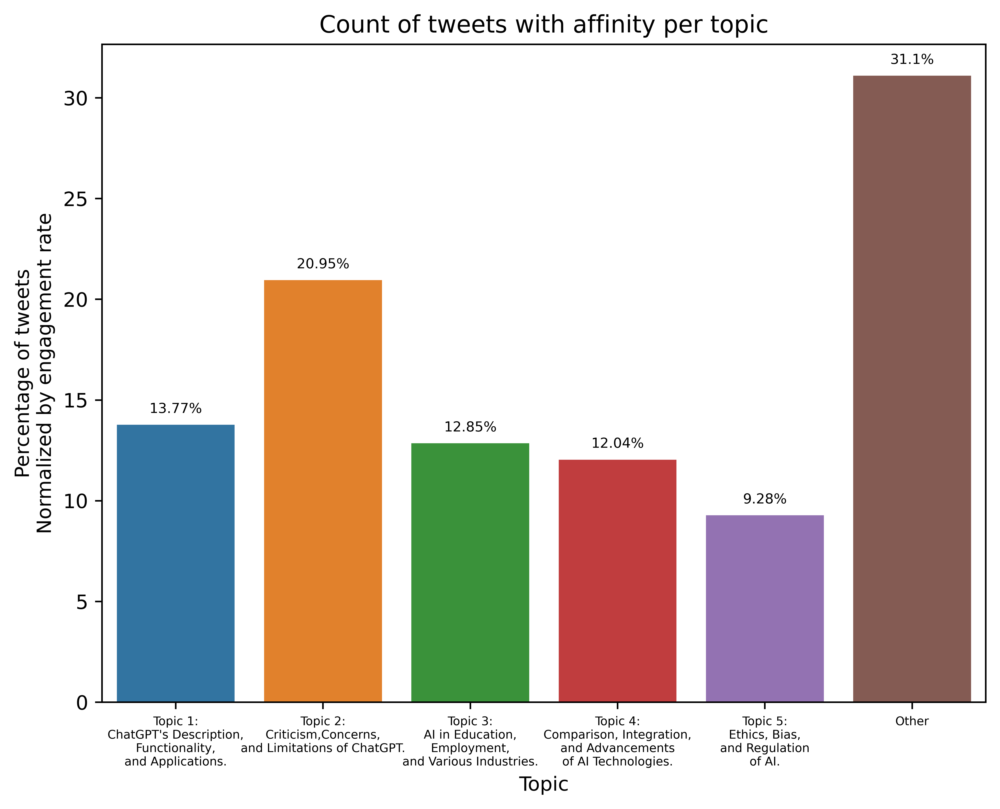

In [520]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=700)
plt.style.use('default')
ax = sns.barplot(data=tweets_count_per_topic_df_engagement_normalized_sorted, x="Topic", y='Count_pctengagement_normalized')
ax.set_xlabel("Topic")
ax.set_ylabel("Percentage of tweets\nNormalized by engagement rate")
ax.set_title("Count of tweets with affinity per topic")

for i, bar in enumerate(ax.patches):
    print(i)
    ax.annotate("{}%".format(tweets_count_per_topic_df_engagement_normalized_sorted.loc[i, "Count_pctengagement_normalized"]),
               (bar.get_x() + bar.get_width() / 2,
                bar.get_height()), ha='center', va='center',
               size=7, xytext=(0, 8),
               textcoords='offset points')

labels = ["Topic 1:\nChatGPT's Description,\nFunctionality,\nand Applications.",
                      "Topic 2:\nCriticism,Concerns,\nand Limitations of ChatGPT.",
                      "Topic 3:\nAI in Education,\nEmployment,\nand Various Industries.",
                      "Topic 4:\nComparison, Integration,\nand Advancements\nof AI Technologies.",
                      "Topic 5:\nEthics, Bias,\nand Regulation\nof AI.",
                      "Other"]
ax.set_xticklabels(["{}".format(l) for l in labels], fontsize=6)

In [521]:
week_num_to_chatgpt_topic_df = sentiment_df_merged[["id", "week_num", "gpt_classify"]].groupby(["week_num", "gpt_classify"]).count().unstack(fill_value=0).stack().reset_index(drop=False)
week_num_chatgpt_count_df = sentiment_df_merged.groupby(["week_num"]).count()["id"].reset_index().rename(columns={"id": "week_count"})
week_num_to_chatgpt_topic_df = week_num_to_chatgpt_topic_df.merge(week_num_chatgpt_count_df, left_on="week_num", right_on="week_num", how="inner")
week_num_to_chatgpt_topic_df = week_num_to_chatgpt_topic_df.reset_index(drop=True).rename(columns={"id": "count"})
week_num_to_chatgpt_topic_df["week_topic_pct"] = round(100 * week_num_to_chatgpt_topic_df["count"] / week_num_to_chatgpt_topic_df["week_count"], 2)
week_num_to_chatgpt_topic_df["week_num"] = week_num_to_chatgpt_topic_df["week_num"].map({week: get_week_date_range_str(2023, week) for week in range(1, 52)})
week_num_to_chatgpt_topic_df.head()

,week_num,gpt_classify,count,week_count,week_topic_pct
0,06/02-12/02,DIFFERENT,1586,11770,13.47000000
1,06/02-12/02,"Topic 1: ChatGPT's Description, Functionality,...",1168,11770,9.92000000
2,06/02-12/02,"Topic 2: Criticism, Concerns, and Limitations ...",2055,11770,17.46000000
3,06/02-12/02,"Topic 3: AI in Education, Employment, and Vari...",1885,11770,16.02000000
4,06/02-12/02,"Topic 4: Comparison, Integration, and Advancem...",3647,11770,30.99000000


In [522]:
daily_chatgpt_topic_df = sentiment_df_merged[["id", "date", "gpt_classify"]].groupby(["date", "gpt_classify"]).count().unstack(fill_value=0).stack().reset_index(drop=False)
daily_chatgpt_count_df = sentiment_df_merged.groupby(["date"]).count()["id"].reset_index().rename(columns={"id": "day_count"})
daily_to_chatgpt_topic_df = daily_chatgpt_topic_df.merge(daily_chatgpt_count_df, left_on="date", right_on="date", how="inner")
daily_to_chatgpt_topic_df = daily_to_chatgpt_topic_df.rename(columns={"id": "count"})
daily_to_chatgpt_topic_df["day_topic_pct"] = round(100 * daily_to_chatgpt_topic_df["count"] / daily_to_chatgpt_topic_df["day_count"], 2)
daily_to_chatgpt_topic_df

,date,gpt_classify,count,day_count,day_topic_pct
0,2023-02-06,DIFFERENT,879,6400,13.73000000
1,2023-02-06,"Topic 1: ChatGPT's Description, Functionality,...",666,6400,10.41000000
2,2023-02-06,"Topic 2: Criticism, Concerns, and Limitations ...",1224,6400,19.12000000
3,2023-02-06,"Topic 3: AI in Education, Employment, and Vari...",1122,6400,17.53000000
4,2023-02-06,"Topic 4: Comparison, Integration, and Advancem...",1586,6400,24.78000000
...,...,...,...,...,...
649,2023-06-04,"Topic 1: ChatGPT's Description, Functionality,...",237,1585,14.95000000
650,2023-06-04,"Topic 2: Criticism, Concerns, and Limitations ...",294,1585,18.55000000
651,2023-06-04,"Topic 3: AI in Education, Employment, and Vari...",229,1585,14.45000000
652,2023-06-04,"Topic 4: Comparison, Integration, and Advancem...",202,1585,12.74000000


In [ ]:
daily_to_chatgpt_topic_df_sma = pd.DataFrame()
for topic in daily_to_chatgpt_topic_df["gpt_classify"].unique().tolist():
    df = daily_to_chatgpt_topic_df[daily_to_chatgpt_topic_df["gpt_classify"] == topic]
    df['day_topic_pct_SMA_5'] = df.loc[:, "day_topic_pct"].rolling(window=5).mean()
    df['day_topic_count_SMA_5'] = df.loc[:, "count"].rolling(window=5).mean()
    
    daily_to_chatgpt_topic_df_sma = pd.concat([daily_to_chatgpt_topic_df_sma, df], axis=0)
daily_to_chatgpt_topic_df_sma['day_count_SMA_5'] = daily_to_chatgpt_topic_df_sma.loc[:, "day_count"].rolling(window=5).mean()

In [525]:
tmp_df = daily_to_chatgpt_topic_df_sma[daily_to_chatgpt_topic_df_sma["gpt_classify"].isin(["Topic 5: Ethics, Bias, and Regulation of AI.", "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."])]
pd.pivot_table(tmp_df, values="day_topic_pct_SMA_5", index="date", columns="gpt_classify")

gpt_classify,"Topic 2: Criticism, Concerns, and Limitations of ChatGPT.","Topic 5: Ethics, Bias, and Regulation of AI."
date,,
2023-02-19,22.58800000,11.77800000
2023-02-20,23.34600000,11.80400000
2023-02-21,24.88800000,12.78400000
2023-02-22,23.68200000,13.23000000
2023-02-23,22.32200000,13.65000000
...,...,...
2023-05-31,23.73200000,9.09800000
2023-06-01,22.49600000,8.95000000
2023-06-02,20.63200000,8.50800000


In [ ]:
daily_chatgpt_topic_df_engagement_norm = sentiment_df_merged[["id", "date", "engagement_rate", "gpt_classify"]].groupby(["date", "gpt_classify"]).agg({"engagement_rate": "sum"}).unstack(fill_value=0).stack().reset_index(drop=False)
daily_chatgpt_count_df_engagement_norm = sentiment_df_merged.groupby(["date"]).agg({"engagement_rate": "sum"})["engagement_rate"].reset_index().rename(columns={"engagement_rate": "day_count"})
daily_chatgpt_count_df_engagement_norm["day_count_SMA_5"] = df.loc[:, "day_count"].rolling(window=5).mean()
daily_to_chatgpt_topic_df_engagement_norm = daily_chatgpt_topic_df_engagement_norm.merge(daily_chatgpt_count_df_engagement_norm, left_on="date", right_on="date", how="inner")
daily_to_chatgpt_topic_df_engagement_norm["day_topic_pct"] = round(100 * daily_to_chatgpt_topic_df_engagement_norm["engagement_rate"] / daily_to_chatgpt_topic_df_engagement_norm["day_count"], 2)
daily_to_chatgpt_topic_df_engagement_norm

daily_to_chatgpt_topic_df_sma_engagement_norm = pd.DataFrame()
for topic in daily_to_chatgpt_topic_df_engagement_norm["gpt_classify"].unique().tolist():
    df = daily_to_chatgpt_topic_df_engagement_norm[daily_to_chatgpt_topic_df_engagement_norm["gpt_classify"] == topic]
    df['day_topic_pct_SMA_5'] = df.loc[:, "day_topic_pct"].rolling(window=5).mean()
    df['day_topic_pct_SMA_5_std'] = df.loc[:, "day_topic_pct"].rolling(window=5).std()
    df['engagement_rate_count_SMA_5'] = df.loc[:, "engagement_rate"].rolling(window=5).mean()
    df['engagement_rate_count_SMA_5_std'] = df.loc[:, "engagement_rate"].rolling(window=5).std()
    
    df['day_topic_pct_SMA_5_UpperBand'] = df['day_topic_pct_SMA_5'] + (2 * df['day_topic_pct_SMA_5_std']) 
    df['day_topic_pct_SMA_5_LowerBand'] = df['day_topic_pct_SMA_5'] - (2 * df['day_topic_pct_SMA_5_std'])
    
    df['engagement_rate_count_SMA_5_UpperBand'] = df['engagement_rate_count_SMA_5'] + (2 * df['engagement_rate_count_SMA_5_std']) 
    df['engagement_rate_count_SMA_5_LowerBand'] = df['engagement_rate_count_SMA_5'] - (2 * df['engagement_rate_count_SMA_5_std'])
    daily_to_chatgpt_topic_df_sma_engagement_norm = pd.concat([daily_to_chatgpt_topic_df_sma_engagement_norm, df], axis=0)

In [529]:
counts_per_topic = sentiment_df_merged.groupby("gpt_classify").count()["id"]
counts_per_topic

gpt_classify
DIFFERENT                                                                 44716
Topic 1: ChatGPT's Description, Functionality, and Applications.          28991
Topic 2: Criticism, Concerns, and Limitations of ChatGPT.                 55346
Topic 3: AI in Education, Employment, and Various Industries.             32182
Topic 4: Comparison, Integration, and Advancements of AI Technologies.    29923
Topic 5: Ethics, Bias, and Regulation of AI.                              26337
Name: id, dtype: int64

In [530]:
counts_per_topic.sum()

217495

In [531]:
proportions_per_topic = sentiment_df_merged.groupby("gpt_classify").count()["id"] / sentiment_df_merged.shape[0] * 100
proportions_per_topic

gpt_classify
DIFFERENT                                                                20.55955309
Topic 1: ChatGPT's Description, Functionality, and Applications.         13.32950183
Topic 2: Criticism, Concerns, and Limitations of ChatGPT.                25.44702177
Topic 3: AI in Education, Employment, and Various Industries.            14.79666199
Topic 4: Comparison, Integration, and Advancements of AI Technologies.   13.75801743
Topic 5: Ethics, Bias, and Regulation of AI.                             12.10924389
Name: id, dtype: float64

In [532]:
sentiment_df_merged.groupby(["gpt_classify", "date"]).count()["id"].reset_index().groupby(["gpt_classify"]).mean()

,id
gpt_classify,
DIFFERENT,410.23853211
"Topic 1: ChatGPT's Description, Functionality, and Applications.",265.97247706
"Topic 2: Criticism, Concerns, and Limitations of ChatGPT.",507.76146789
"Topic 3: AI in Education, Employment, and Various Industries.",295.24770642
"Topic 4: Comparison, Integration, and Advancements of AI Technologies.",274.52293578
"Topic 5: Ethics, Bias, and Regulation of AI.",241.62385321


In [533]:
sentiment_df_merged.groupby(["gpt_classify", "date"]).count()["id"].reset_index().groupby(["gpt_classify"]).std()

,id
gpt_classify,
DIFFERENT,357.48491030
"Topic 1: ChatGPT's Description, Functionality, and Applications.",198.34245818
"Topic 2: Criticism, Concerns, and Limitations of ChatGPT.",213.49463950
"Topic 3: AI in Education, Employment, and Various Industries.",287.32444418
"Topic 4: Comparison, Integration, and Advancements of AI Technologies.",309.81471752
"Topic 5: Ethics, Bias, and Regulation of AI.",146.40948341


In [534]:
sentiment_df_merged.groupby(["gpt_classify", "date"]).count()["id"].reset_index().mean()
sentiment_df_merged.groupby(["gpt_classify", "date"]).count()["id"].reset_index().std()

id   278.03108625
dtype: float64

In [536]:
from scipy.stats import chisquare
chisquare(f_obs=counts_per_topic.values.tolist(), f_exp=None)

Power_divergenceResult(statistic=17762.355111611763, pvalue=0.0)

In [538]:
PLOT_KEY_EVENTS = False
import matplotlib
import seaborn
fig, ax = plt.subplots(figsize=(12, 8), dpi=750)
plt.style.use('default')

colors=["blue", "green", "red", "orange", "purple", "black", "gray"]
styles = ["-", ":", "solid", "-.", "dashdot", "--"]
markers = ["o", "s", "P","D", "*", "X"]

for i, topic in enumerate(daily_to_chatgpt_topic_df_sma_engagement_norm["gpt_classify"].unique().tolist()):
    if topic == "DIFFERENT":
        continue
    sbs = daily_to_chatgpt_topic_df_sma_engagement_norm[daily_to_chatgpt_topic_df_sma_engagement_norm["gpt_classify"] == topic]
    g = sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5", ax=ax,
                     color=colors[i],# linestyle=styles[i],
                     marker=markers[i], markersize=5,
                     label="{}".format(topic))
    if ("Topic 2" in topic) or ("Topic 5" in topic):
        g2 = sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5_UpperBand", ax=ax,
                         color=colors[i], linestyle="--", linewidth=0.1)
        g3 = sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5_LowerBand", ax=ax,
                         color=colors[i], linestyle="--", linewidth=0.1)
        ax.fill_between(sbs["date"], sbs["day_topic_pct_SMA_5_LowerBand"], sbs["day_topic_pct_SMA_5_UpperBand"], color=colors[i], alpha=0.05)

# plt.title("Topic Proportions Over Time on Weekly Interval")
plt.ylabel("Proportions of tweets (%)\nNormalized by engagement rate", fontsize=14)
plt.xlabel("Date", fontsize=14)
plt.xticks(rotation = 45, fontsize=12)
ax.grid()
ax.set_ylim(0, 55)
ax.legend(title = "Topic", title_fontsize=13, fontsize=12, ncols=2, loc=(-0.18, 1.03)) #loc=(1.02, 0.67))

# vertical lines when something happened
if PLOT_KEY_EVENTS:
    plotted_dates = []
    events = key_events_dates_df[key_events_dates_df["date"].isin(daily_to_chatgpt_topic_df_sma_engagement_norm["date"])]
    for i, event in events.iterrows():
        date = event["date"]
        event_desc = event["event"]
        if date in plotted_dates:
            continue
        ax.axvline(date, color='gray', linestyle='--', linewidth=0.5)
        offset = (-5, -0.5)
        ax.annotate(event_desc, xy=(date, plt.ylim()[1]), xytext=offset, textcoords='offset points',
                 rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
        plotted_dates.append(date)

min_loc = mdates.DayLocator()
ax.xaxis.grid(False)
ax.yaxis.grid(True)
ax.xaxis.set_minor_locator(min_loc)
import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%d-%b-%Y')
ax.xaxis.set_major_formatter(myFmt)
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

In [539]:
import pymannkendall as mk
time_series_dict = {}
for i, topic in enumerate(daily_to_chatgpt_topic_df_sma_engagement_norm["gpt_classify"].unique().tolist()):
    if topic == "DIFFERENT":
        continue
    sbs = daily_to_chatgpt_topic_df_sma_engagement_norm[daily_to_chatgpt_topic_df_sma_engagement_norm["gpt_classify"] == topic]
    # Extract the time values and reshape them to a 2D array
    X = sbs.date.values
    # Extract the time series values and reshape them to a 1D array
    sbs["day_topic_pct_SMA_5"] = sbs["day_topic_pct_SMA_5"].replace(np.nan, sbs["day_topic_pct_SMA_5"].values[4])
    y = sbs["day_topic_pct_SMA_5"].values
    time_series_dict[topic] = y
    
    # Compute tau statistics
    trend, h, p, z, Tau, s, var_s, slope, intercept =  mk.yue_wang_modification_test(y) # mk.original_test()
    print("{} - trend={}, h={}, p={}, z={}, Tau={}, s={}, slope={}, intercept={}".format(topic, trend, h, p, z, Tau, s, slope, intercept))
    sens_sploe_results = mk.sens_slope(y)
    print("Sens slope results: {}".format(sens_sploe_results))
    print("===========================================")
    # sieve-bootstrap for potentially autocorrelated data

Topic 1: ChatGPT's Description, Functionality, and Applications. - trend=no trend, h=False, p=0.30649536858293036, z=-1.0226034693608081, Tau=-0.06812776078831125, s=-401.0, slope=-0.0062354437535330764, intercept=14.370713962690786
Sens slope results: Sens_Slope_Test(slope=-0.0062354437535330764, intercept=14.370713962690786)
Topic 2: Criticism, Concerns, and Limitations of ChatGPT. - trend=no trend, h=False, p=0.2895800639357906, z=-1.05904329227938, Tau=-0.1382942575603126, s=-814.0, slope=-0.05246464646464643, intercept=34.21909090909091
Sens slope results: Sens_Slope_Test(slope=-0.05246464646464643, intercept=34.21909090909091)
Topic 3: AI in Education, Employment, and Various Industries. - trend=no trend, h=False, p=0.0660735229274001, z=-1.8379245571785376, Tau=-0.20268433571185865, s=-1193.0, slope=-0.02566926829268291, intercept=12.414140487804877
Sens slope results: Sens_Slope_Test(slope=-0.02566926829268291, intercept=12.414140487804877)
Topic 4: Comparison, Integration, and

In [540]:
from scipy import stats
# Check the two curves of topic 2 and topic 5 have the same gradients and their min diff is zero.
U1, p = stats.wilcoxon(np.gradient(time_series_dict["Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]),
                       np.gradient(time_series_dict['Topic 5: Ethics, Bias, and Regulation of AI.']),
                                   method="auto")
print("wilcoxon test: two groups: statistic={}, pvalue={}".format(U1, p))

wilcoxon test: two groups: statistic=2590.0, pvalue=0.5382998974773484


In [541]:
from scipy import stats
from scipy.stats import mannwhitneyu

groups = []
for i, topic in enumerate(daily_to_chatgpt_topic_df_sma_engagement_norm["gpt_classify"].unique().tolist()):
    if topic == "DIFFERENT":
        continue
    sbs = daily_to_chatgpt_topic_df_sma_engagement_norm[daily_to_chatgpt_topic_df_sma_engagement_norm["gpt_classify"] == topic]
    sbs["day_topic_pct_SMA_5"] = sbs["day_topic_pct_SMA_5"].replace(np.nan, sbs["day_topic_pct_SMA_5"].values[4])
    groups.append(sbs["day_topic_pct_SMA_5"])
    
stat, pvalue = stats.kruskal(*groups)
print("Kruskal-Wallis H-test: statstic={}; p_value={}".format(stat, pvalue))

# post hoc test
import scikit_posthocs as sp
post_hoc_pvalues_df = sp.posthoc_dunn(groups, p_adjust = 'holm')
print("===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
post_hoc_pvalues_df

Kruskal-Wallis H-test: statstic=257.54587065918975; p_value=1.541022202450972e-54


,1,2,3,4,5
1,1.00000000,0.00000000,0.00001253,0.00000000,0.00002837
2,0.00000000,1.00000000,0.00000000,0.00000000,0.00000000
3,0.00001253,0.00000000,1.00000000,0.07015087,0.82838757
4,0.00000000,0.00000000,0.07015087,1.00000000,0.06033526
5,0.00002837,0.00000000,0.82838757,0.06033526,1.00000000


In [542]:
stat, pvalue = stats.stats.friedmanchisquare(*groups)
print("friedmanchisquare test: statstic={}; p_value={}".format(stat, pvalue))

friedmanchisquare test: statstic=223.94128440366967; p_value=2.659093167829485e-47


In [543]:
import scikit_posthocs as sp
#perform Nemenyi post-hoc test
sp.posthoc_nemenyi_friedman(np.array(groups).T)

,0,1,2,3,4
0,1.00000000,0.00100000,0.00100000,0.00100000,0.00252084
1,0.00100000,1.00000000,0.00100000,0.00100000,0.00100000
2,0.00100000,0.00100000,1.00000000,0.04815766,0.90000000
3,0.00100000,0.00100000,0.04815766,1.00000000,0.00744838
4,0.00252084,0.00100000,0.90000000,0.00744838,1.00000000


#### Try to see correlation causility to external events

##### Vaderbilt aplogizes mass shooting

In [133]:
key_events_dates_df

,date,event,link,keep,week_num
1,2023-05-10,Bard made available,NaN,1.00000000,08/05-14/05
5,2023-04-17,Musk - Carlson interview: 'Starting new AI pla...,NaN,1.00000000,17/04-23/04
8,2023-03-08,Noam Chomsky: The False Promise of ChatGPT art...,https://www.nytimes.com/2023/03/08/opinion/noa...,1.00000000,06/03-12/03
10,2023-03-31,ChatGPT Is Banned in Italy Over Privacy Concerns,https://www.garanteprivacy.it/home/docweb/-/do...,1.00000000,27/03-02/04
12,2023-03-14,First public demo of ChatGPT-4,NaN,1.00000000,13/03-19/03
14,2023-02-17,New york times - A very strange conversation w...,https://www.nytimes.com/2023/02/16/technology/...,1.00000000,13/02-19/02
18,2023-05-16,Sam Altman appears before US congress,NaN,1.00000000,15/05-21/05
19,2023-02-22,Vanderbilt University apologizes for using Cha...,https://edition.cnn.com/2023/02/22/tech/vander...,1.00000000,20/02-26/02
20,2023-05-18,Apple restricts use of OpenAI's ChatGPT for em...,NaN,1.00000000,15/05-21/05
21,2023-03-22,Facebook accounts hijacked by new malicious Ch...,NaN,1.00000000,20/03-26/03


In [134]:
# Check if the tweets in peaks really contains discussion about the external event, by sarching its words
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_during_week_20_02_26_02 = topic2_tweets_df[(topic2_tweets_df['created_at'].dt.year == 2023) & (topic2_tweets_df['created_at'].dt.month == 2) & (topic2_tweets_df['created_at'].dt.day >= 20) & (topic2_tweets_df['created_at'].dt.day <= 26)]
print("total tweets in topic {}: {} between {} and {}".format("topic 2", topic2_tweets_df_during_week_20_02_26_02.shape[0], "20/02", "26_02"))
# how many tweets contains the tokens of Vanderbilt University, mass shooting, apologize
tokens_to_search = ["vanderbilt", "shooting"]
chatgpt_variations_tokens = ["chatgpt", "gpt", "chat"]
topic2_tweets_df_during_week_20_02_26_02["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_during_week_20_02_26_02['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
topic2_tweets_df_during_week_20_02_26_02["contains_event_keywords_and_chatgpt_keyword"].sum()

total tweets in topic topic 2: 6471 between 20/02 and 26_02


21

In [ ]:
topic2_tweets_df["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
topic2_tweets_df["contains_event_keywords_and_chatgpt_keyword"].sum()

fig, ax = plt.subplots(2, 1, figsize=(8, 8), dpi=750, constrained_layout = True)
sbs = daily_to_chatgpt_topic_df_sma[daily_to_chatgpt_topic_df_sma["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5", ax=ax[0],
                     color="black",
                     label="{}".format("topic 2"))
ax[0].axvspan("2023-02-20", "2023-02-26", color='coral', alpha=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, fontsize=8)
ax[0].xaxis.grid(False)
ax[0].yaxis.grid(True)
ax[0].set_xlabel(None)
ax[0].xaxis.set_minor_locator(min_loc)
ax[0].set_ylabel("Proportions of tweets (%)", fontsize=8)
ax[0].set_xticklabels([])

plotted_dates = []
events = key_events_dates_df[key_events_dates_df["date"].isin(daily_to_chatgpt_topic_df_sma["date"])]
for i, event in events.iterrows():
    date = event["date"]
    event_desc = event["event"]
    if date in plotted_dates:
        continue
    ax[0].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    ax[1].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    offset = (-5, -0.5)
    if date.month == 2 and date.day == 22:
        ax[0].annotate(event_desc, xy=(date, ax[0].get_ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
        plotted_dates.append(date)
    ax[0].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[1], label="{}".format("topic 2"), estimator="sum")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[1].axvspan("2023-02-20", "2023-02-26", color='coral', alpha=0.5)
ax[1].xaxis.grid(False)
ax[1].yaxis.grid(True)
ax[1].xaxis.set_minor_locator(min_loc)
ax[1].set_xlabel("Date")
ax[1].set_ylabel("Count of tweets contating event-realted keywords", fontsize=8)
ax[1].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

In [136]:
combined_df_topic2_vanderblit = sbs[["date", "day_topic_pct_SMA_5"]].merge(topic2_tweets_df_event_keyword_occur_sum[["date", "contains_event_keywords_and_chatgpt_keyword"]], how="inner", on="date")
combined_df_topic2_vanderblit["day_topic_pct_SMA_5"] = combined_df_topic2_vanderblit["day_topic_pct_SMA_5"].replace(np.nan, combined_df_topic2_vanderblit["day_topic_pct_SMA_5"].values[4])
combined_df_topic2_vanderblit = combined_df_topic2_vanderblit.set_index("date")
combined_df_topic2_vanderblit

,day_topic_pct_SMA_5,contains_event_keywords_and_chatgpt_keyword
date,,
2023-01-31,21.36600000,0
2023-02-01,21.36600000,0
2023-02-02,21.36600000,0
2023-02-03,21.36600000,0
2023-02-04,21.36600000,0
...,...,...
2023-05-31,23.73200000,0
2023-06-01,22.49600000,0
2023-06-02,20.63200000,0


In [137]:
from statsmodels.tsa.stattools import adfuller

def adf_test(df):
    result = adfuller(df.values)
    print('ADF Statistics: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

In [138]:
print('ADF Test: time series: day_topic_pct_SMA_5')
print(adf_test(combined_df_topic2_vanderblit['day_topic_pct_SMA_5']))
print('ADF Test: time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(combined_df_topic2_vanderblit['contains_event_keywords_and_chatgpt_keyword']))

df_transformed = combined_df_topic2_vanderblit.diff().dropna()

print('ADF Test: transformed time series: day_topic_pct_SMA_5')
print(adf_test(df_transformed['day_topic_pct_SMA_5']))
print('ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(df_transformed['contains_event_keywords_and_chatgpt_keyword']))

ADF Test: time series: day_topic_pct_SMA_5
ADF Statistics: -1.703450
p-value: 0.429336
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -5.242461
p-value: 0.000007
Critical values:
	1%: -3.489
	5%: -2.887
	10%: -2.580
None
ADF Test: transformed time series: day_topic_pct_SMA_5
ADF Statistics: -2.753095
p-value: 0.065292
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -6.335584
p-value: 0.000000
Critical values:
	1%: -3.492
	5%: -2.889
	10%: -2.581
None


In [139]:
from statsmodels.tsa.api import VAR

model = VAR(df_transformed)
for i in range(1, 13):
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)

Lag Order = 1
AIC :  0.08825748252306861
Lag Order = 2
AIC :  0.14160976324077018
Lag Order = 3
AIC :  0.12867696323128164
Lag Order = 4
AIC :  0.13528281359817557
Lag Order = 5
AIC :  0.16873187531648393
Lag Order = 6
AIC :  0.025101090434330675
Lag Order = 7
AIC :  0.013635922346062812
Lag Order = 8
AIC :  -0.00815029751672569
Lag Order = 9
AIC :  0.03653939802393158
Lag Order = 10
AIC :  0.10851116471046351
Lag Order = 11
AIC :  -0.0166478867018659
Lag Order = 12
AIC :  -0.11409100546480133


C:\Users\user\.conda\envs\chatgpt\lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [140]:
import statsmodels.api as sm
from statsmodels.tsa.stattools import grangercausalitytests
def grangers_causation_matrix(data, variables, maxlag, test='ssr_chi2test', verbose=False):    
    """Check Granger Causality of all possible combinations of the Time series.
    The rows are the response variable, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

In [141]:
grangers_causation_matrix(df_transformed, df_transformed.columns, maxlag=12)

,day_topic_pct_SMA_5_x,contains_event_keywords_and_chatgpt_keyword_x
day_topic_pct_SMA_5_y,1.00000000,0.00700000
contains_event_keywords_and_chatgpt_keyword_y,0.09270000,1.00000000


In [142]:
topic2_tweets_df_during_week_20_02_26_02[topic2_tweets_df_during_week_20_02_26_02["contains_event_keywords_and_chatgpt_keyword"]]["post"].values.tolist()[0]

'Vanderbilt dean suspended for ChatGPT email about MSU mass shooting https://t.co/LkxfKyp2OI -- The program was written by Democrats, for Democrats and is controlled by Democrats. It is NOT TRUE AI. MSM/Democrats are bamboozling you AGAIN !! 🤨Fake ChatGPT.'

##### Noam Chomsky: The False Promise event

In [144]:
# Check if the tweets in peaks really contains discussion about the external event, by sarching its words 06/03-12/03
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_during_week_06_03_12_03 = topic2_tweets_df[(topic2_tweets_df['created_at'].dt.year == 2023) & (topic2_tweets_df['created_at'].dt.month == 3) & (topic2_tweets_df['created_at'].dt.day >= 6) & (topic2_tweets_df['created_at'].dt.day <= 12)]
print("total tweets in topic {}: {} between {} and {}".format("topic 2", topic2_tweets_df_during_week_06_03_12_03.shape[0], "06/03", "12/03"))
# how many tweets contains the tokens of noam chomsky
tokens_to_search = ["noam", "chomsky"]
chatgpt_variations_tokens = ["chatgpt", "gpt", "chat"]
topic2_tweets_df_during_week_06_03_12_03["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_during_week_06_03_12_03['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
topic2_tweets_df_during_week_06_03_12_03["contains_event_keywords_and_chatgpt_keyword"].sum()

total tweets in topic topic 2: 2261 between 06/03 and 12/03


243

In [ ]:
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_noam = copy.copy(topic2_tweets_df)
topic2_tweets_df_noam["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_noam['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
print(topic2_tweets_df_noam["contains_event_keywords_and_chatgpt_keyword"].sum())

fig, ax = plt.subplots(2, 1, figsize=(8, 8), dpi=750, constrained_layout = True)
sbs = daily_to_chatgpt_topic_df_sma[daily_to_chatgpt_topic_df_sma["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5", ax=ax[0],
                     color="black",
                     label="{}".format("topic 2"))
ax[0].axvspan("2023-03-06", "2023-03-12", color='coral', alpha=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, fontsize=8)
ax[0].xaxis.grid(False)
ax[0].yaxis.grid(True)
ax[0].set_xlabel(None)
ax[0].xaxis.set_minor_locator(min_loc)
ax[0].set_ylabel("Proportions of tweets (%)", fontsize=8)
ax[0].set_xticklabels([])

plotted_dates = []
events = key_events_dates_df[key_events_dates_df["date"].isin(daily_to_chatgpt_topic_df_sma["date"])]
for i, event in events.iterrows():
    date = event["date"]
    event_desc = event["event"]
    if date in plotted_dates:
        continue
    ax[0].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    ax[1].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    offset = (-5, -0.5)
    if date.month == 3 and date.day == 8:
        ax[0].annotate(event_desc, xy=(date, ax[0].get_ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
        plotted_dates.append(date)
    ax[0].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df_noam.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df_noam, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[1], label="{}".format("topic 2"), estimator="sum")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[1].axvspan("2023-03-06", "2023-03-12", color='coral', alpha=0.5)
ax[1].xaxis.grid(False)
ax[1].yaxis.grid(True)
ax[1].xaxis.set_minor_locator(min_loc)
ax[1].set_xlabel("Date")
ax[1].set_ylabel("Count of tweets contating event-realted keywords\nEvent: Noam Chomsky: The False Promise", fontsize=8)
ax[1].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

In [146]:
combined_df_topic2_chomsky = sbs[["date", "day_topic_pct_SMA_5"]].merge(topic2_tweets_df_event_keyword_occur_sum[["date", "contains_event_keywords_and_chatgpt_keyword"]], how="inner", on="date")
combined_df_topic2_chomsky["day_topic_pct_SMA_5"] = combined_df_topic2_chomsky["day_topic_pct_SMA_5"].replace(np.nan, combined_df_topic2_chomsky["day_topic_pct_SMA_5"].values[4])
combined_df_topic2_chomsky = combined_df_topic2_chomsky.set_index("date")
combined_df_topic2_chomsky

,day_topic_pct_SMA_5,contains_event_keywords_and_chatgpt_keyword
date,,
2023-01-31,21.36600000,0
2023-02-01,21.36600000,0
2023-02-02,21.36600000,0
2023-02-03,21.36600000,1
2023-02-04,21.36600000,0
...,...,...
2023-05-31,23.73200000,1
2023-06-01,22.49600000,0
2023-06-02,20.63200000,0


In [147]:
print('ADF Test: time series: day_topic_pct_SMA_5')
print(adf_test(combined_df_topic2_chomsky['day_topic_pct_SMA_5']))
print('ADF Test: time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(combined_df_topic2_chomsky['contains_event_keywords_and_chatgpt_keyword']))

df_transformed_chomsky = combined_df_topic2_chomsky.diff().dropna()

print('ADF Test: transformed time series: day_topic_pct_SMA_5')
print(adf_test(df_transformed_chomsky['day_topic_pct_SMA_5']))
print('ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(df_transformed_chomsky['contains_event_keywords_and_chatgpt_keyword']))

ADF Test: time series: day_topic_pct_SMA_5
ADF Statistics: -1.703450
p-value: 0.429336
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -4.190732
p-value: 0.000683
Critical values:
	1%: -3.490
	5%: -2.888
	10%: -2.581
None
ADF Test: transformed time series: day_topic_pct_SMA_5
ADF Statistics: -2.753095
p-value: 0.065292
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -7.714966
p-value: 0.000000
Critical values:
	1%: -3.491
	5%: -2.888
	10%: -2.581
None


In [148]:
from statsmodels.tsa.api import VAR

model = VAR(df_transformed_chomsky)
for i in range(1, 13):
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)

Lag Order = 1
AIC :  4.703962552000266
Lag Order = 2
AIC :  4.519340503120567
Lag Order = 3
AIC :  4.505960372297563
Lag Order = 4
AIC :  4.5014052029753
Lag Order = 5
AIC :  4.550732478193187
Lag Order = 6
AIC :  4.444172825238109
Lag Order = 7
AIC :  4.511651402000995
Lag Order = 8
AIC :  4.477160356348013
Lag Order = 9
AIC :  4.5361284570594975
Lag Order = 10
AIC :  4.603776164694234
Lag Order = 11
AIC :  4.597450706879565
Lag Order = 12
AIC :  4.684629036256461


C:\Users\user\.conda\envs\chatgpt\lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [149]:
grangers_causation_matrix(df_transformed_chomsky, df_transformed_chomsky.columns, maxlag=6)

,day_topic_pct_SMA_5_x,contains_event_keywords_and_chatgpt_keyword_x
day_topic_pct_SMA_5_y,1.00000000,0.06790000
contains_event_keywords_and_chatgpt_keyword_y,0.00280000,1.00000000


##### Bard made available

In [77]:
# Check if the tweets in peaks really contains discussion about the external event, by searching its words 10/05/2023 08/05-14/05
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_during_week_08_05_14_05 = topic2_tweets_df[(topic2_tweets_df['created_at'].dt.year == 2023) & (topic2_tweets_df['created_at'].dt.month == 5) & (topic2_tweets_df['created_at'].dt.day >= 8) & (topic2_tweets_df['created_at'].dt.day <= 14)]
print("total tweets in topic {}: {} between {} and {}".format("topic 2", topic2_tweets_df_during_week_08_05_14_05.shape[0], "08/05", "14/05"))
# how many tweets contains the tokens of bard google
tokens_to_search = ["bard"]
chatgpt_variations_tokens = ["chatgpt", "gpt", "chat"]
topic2_tweets_df_during_week_08_05_14_05["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_during_week_08_05_14_05['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
topic2_tweets_df_during_week_08_05_14_05["contains_event_keywords_and_chatgpt_keyword"].sum()

total tweets in topic topic 2: 2520 between 08/05 and 14/05


140

In [ ]:
example_posts_bard = topic2_tweets_df_during_week_08_05_14_05[topic2_tweets_df_during_week_08_05_14_05["contains_event_keywords_and_chatgpt_keyword"]]["post"].values.tolist()

In [ ]:
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_bard = copy.copy(topic2_tweets_df)
topic2_tweets_df_bard["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_bard['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
print(topic2_tweets_df_bard["contains_event_keywords_and_chatgpt_keyword"].sum())

fig, ax = plt.subplots(2, 1, figsize=(8, 8), dpi=750, constrained_layout=True)
sbs = daily_to_chatgpt_topic_df_sma[daily_to_chatgpt_topic_df_sma["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5", ax=ax[0],
                     color="red",
                     label="{}".format("topic 2"))
ax[0].axvspan("2023-05-08", "2023-05-14", color='coral', alpha=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, fontsize=8)
ax[0].xaxis.grid(False)
ax[0].yaxis.grid(True)
ax[0].set_xlabel(None)
ax[0].xaxis.set_minor_locator(min_loc)
ax[0].set_ylabel("Proportions of tweets (%)", fontsize=8)
ax[0].set_xticklabels([])

plotted_dates = []
events = key_events_dates_df[key_events_dates_df["date"].isin(daily_to_chatgpt_topic_df_sma["date"])]
for i, event in events.iterrows():
    date = event["date"]
    event_desc = event["event"]
    if date in plotted_dates:
        continue
    ax[0].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    ax[1].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    offset = (-5, -0.5)
    if date.month == 5 and date.day == 10:
        ax[0].annotate(event_desc, xy=(date, ax[0].get_ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
        plotted_dates.append(date)
    ax[0].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df_bard.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df_bard, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[1], label="{}".format("topic 2"), estimator="sum")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[1].axvspan("2023-05-08", "2023-05-14", color='coral', alpha=0.5)
ax[1].xaxis.grid(False)
ax[1].yaxis.grid(True)
ax[1].xaxis.set_minor_locator(min_loc)
ax[1].set_xlabel("Date")
ax[1].set_ylabel("Count of tweets contating event-realted keywords\nEvent: Bard made available", fontsize=8)
ax[1].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

In [81]:
combined_df_topic2_bard = sbs[["date", "day_topic_pct_SMA_5"]].merge(topic2_tweets_df_event_keyword_occur_sum[["date", "contains_event_keywords_and_chatgpt_keyword"]], how="inner", on="date")
combined_df_topic2_bard["day_topic_pct_SMA_5"] = combined_df_topic2_bard["day_topic_pct_SMA_5"].replace(np.nan, combined_df_topic2_bard["day_topic_pct_SMA_5"].values[4])
combined_df_topic2_bard = combined_df_topic2_bard.set_index("date")
combined_df_topic2_bard

,day_topic_pct_SMA_5,contains_event_keywords_and_chatgpt_keyword
date,,
2023-01-31,21.36600000,0
2023-02-01,21.36600000,0
2023-02-02,21.36600000,0
2023-02-03,21.36600000,0
2023-02-04,21.36600000,0
...,...,...
2023-05-31,23.73200000,16
2023-06-01,22.49600000,19
2023-06-02,20.63200000,13


In [84]:
print('ADF Test: time series: day_topic_pct_SMA_5')
print(adf_test(combined_df_topic2_bard['day_topic_pct_SMA_5']))
print('ADF Test: time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(combined_df_topic2_bard['contains_event_keywords_and_chatgpt_keyword']))

df_transformed_bard = combined_df_topic2_bard.diff().dropna()

print('ADF Test: transformed time series: day_topic_pct_SMA_5')
print(adf_test(df_transformed_bard['day_topic_pct_SMA_5']))
print('ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(df_transformed_bard['contains_event_keywords_and_chatgpt_keyword']))

ADF Test: time series: day_topic_pct_SMA_5
ADF Statistics: -1.703450
p-value: 0.429336
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -3.239972
p-value: 0.017784
Critical values:
	1%: -3.491
	5%: -2.888
	10%: -2.581
None
ADF Test: transformed time series: day_topic_pct_SMA_5
ADF Statistics: -2.753095
p-value: 0.065292
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -8.022428
p-value: 0.000000
Critical values:
	1%: -3.491
	5%: -2.888
	10%: -2.581
None


In [96]:
from statsmodels.tsa.api import VAR

model = VAR(df_transformed_bard)
for i in range(1, 12):
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)

Lag Order = 1
AIC :  4.176144559282775
Lag Order = 2
AIC :  4.176506712128451
Lag Order = 3
AIC :  4.14208015892131
Lag Order = 4
AIC :  4.142684764744963
Lag Order = 5
AIC :  4.197596694852871
Lag Order = 6
AIC :  4.007028461302247
Lag Order = 7
AIC :  3.825713637466539
Lag Order = 8
AIC :  3.613834116065726
Lag Order = 9
AIC :  3.634984201764811
Lag Order = 10
AIC :  3.7050723156857126
Lag Order = 11
AIC :  3.690798292479008


C:\Users\user\.conda\envs\chatgpt\lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [97]:
grangers_causation_matrix(df_transformed_bard, df_transformed_bard.columns, maxlag=8)

,day_topic_pct_SMA_5_x,contains_event_keywords_and_chatgpt_keyword_x
day_topic_pct_SMA_5_y,1.00000000,0.41930000
contains_event_keywords_and_chatgpt_keyword_y,0.49510000,1.00000000


##### Sam Altman appears before the US congress

In [126]:
# Check if the tweets in peaks really contains discussion about the external event, by searching its words 16/05/2023 15/05-21/05
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_during_week_15_05_21_05 = topic2_tweets_df[(topic2_tweets_df['created_at'].dt.year == 2023) & (topic2_tweets_df['created_at'].dt.month == 5) & (topic2_tweets_df['created_at'].dt.day >= 15) & (topic2_tweets_df['created_at'].dt.day <= 21)]
print("total tweets in topic {}: {} between {} and {}".format("topic 2", topic2_tweets_df_during_week_15_05_21_05.shape[0], "15/05", "21/05"))
# how many tweets contains the tokens of sam altam, congress
tokens_to_search = ['altman', 'congress']
chatgpt_variations_tokens = ["chatgpt", "gpt", "chat"]
topic2_tweets_df_during_week_15_05_21_05["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_during_week_15_05_21_05['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
topic2_tweets_df_during_week_15_05_21_05["contains_event_keywords_and_chatgpt_keyword"].sum()

total tweets in topic topic 2: 2296 between 15/05 and 21/05


15

In [129]:
example_posts_sam_altman_congress = topic2_tweets_df_during_week_15_05_21_05[topic2_tweets_df_during_week_15_05_21_05["contains_event_keywords_and_chatgpt_keyword"]]["post"].values.tolist()

In [ ]:
topic2_tweets_df = sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
topic2_tweets_df_altman_congress = copy.copy(topic2_tweets_df)
topic2_tweets_df_altman_congress["contains_event_keywords_and_chatgpt_keyword"] = topic2_tweets_df_altman_congress['tokens'].apply(lambda x: any(item in x for item in tokens_to_search) and any(item in x for item in chatgpt_variations_tokens))
print(topic2_tweets_df_altman_congress["contains_event_keywords_and_chatgpt_keyword"].sum())

fig, ax = plt.subplots(2, 1, figsize=(8, 8), dpi=750, constrained_layout=True)
sbs = daily_to_chatgpt_topic_df_sma[daily_to_chatgpt_topic_df_sma["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5", ax=ax[0],
                     color="red",
                     label="{}".format("topic 2"))
ax[0].axvspan("2023-05-15", "2023-05-21", color='coral', alpha=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, fontsize=8)
ax[0].xaxis.grid(False)
ax[0].yaxis.grid(True)
ax[0].set_xlabel(None)
ax[0].xaxis.set_minor_locator(min_loc)
ax[0].set_ylabel("Proportions of tweets (%)", fontsize=8)
ax[0].set_xticklabels([])

plotted_dates = []
events = key_events_dates_df[key_events_dates_df["date"].isin(daily_to_chatgpt_topic_df_sma["date"])]
for i, event in events.iterrows():
    date = event["date"]
    event_desc = event["event"]
    if date in plotted_dates:
        continue
    ax[0].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    ax[1].axvline(date, color='gray', linestyle='--', linewidth=0.5)
    offset = (-5, -0.5)
    if date.month == 5 and date.day == 16:
        ax[0].annotate(event_desc, xy=(date, ax[0].get_ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=5, alpha=0.7)
        plotted_dates.append(date)
    ax[0].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df_altman_congress.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df_altman_congress, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[1], label="{}".format("topic 2"), estimator="sum")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[1].axvspan("2023-05-15", "2023-05-21", color='coral', alpha=0.5)
ax[1].xaxis.grid(False)
ax[1].yaxis.grid(True)
ax[1].xaxis.set_minor_locator(min_loc)
ax[1].set_xlabel("Date")
ax[1].set_ylabel("Count of tweets contating event-realted keywords\nEvent: Bard made available", fontsize=8)
ax[1].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))
# Maybe sam altman appeared before the US congress in an attempt to reassure the world of that the Chat is not a threat to the world and thus the negative discouse deminished?

In [110]:
combined_df_topic2_altman_congress = sbs[["date", "day_topic_pct_SMA_5"]].merge(topic2_tweets_df_event_keyword_occur_sum[["date", "contains_event_keywords_and_chatgpt_keyword"]], how="inner", on="date")
combined_df_topic2_altman_congress["day_topic_pct_SMA_5"] = combined_df_topic2_altman_congress["day_topic_pct_SMA_5"].replace(np.nan, combined_df_topic2_altman_congress["day_topic_pct_SMA_5"].values[4])
combined_df_topic2_altman_congress = combined_df_topic2_altman_congress.set_index("date")
combined_df_topic2_altman_congress

,day_topic_pct_SMA_5,contains_event_keywords_and_chatgpt_keyword
date,,
2023-01-31,21.36600000,1
2023-02-01,21.36600000,3
2023-02-02,21.36600000,3
2023-02-03,21.36600000,2
2023-02-04,21.36600000,3
...,...,...
2023-05-31,23.73200000,3
2023-06-01,22.49600000,1
2023-06-02,20.63200000,1


In [116]:
print('ADF Test: time series: day_topic_pct_SMA_5')
print(adf_test(combined_df_topic2_altman_congress['day_topic_pct_SMA_5']))
print('ADF Test: time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(combined_df_topic2_altman_congress['contains_event_keywords_and_chatgpt_keyword']))

df_transformed_altman_congress = combined_df_topic2_altman_congress.diff().dropna()

print('ADF Test: transformed time series: day_topic_pct_SMA_5')
print(adf_test(df_transformed_altman_congress['day_topic_pct_SMA_5']))
print('ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword')
print(adf_test(df_transformed_altman_congress['contains_event_keywords_and_chatgpt_keyword']))

ADF Test: time series: day_topic_pct_SMA_5
ADF Statistics: -1.703450
p-value: 0.429336
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -7.273961
p-value: 0.000000
Critical values:
	1%: -3.489
	5%: -2.887
	10%: -2.580
None
ADF Test: transformed time series: day_topic_pct_SMA_5
ADF Statistics: -2.753095
p-value: 0.065292
Critical values:
	1%: -3.495
	5%: -2.890
	10%: -2.582
None
ADF Test: transformed time series: contains_event_keywords_and_chatgpt_keyword
ADF Statistics: -9.382312
p-value: 0.000000
Critical values:
	1%: -3.491
	5%: -2.888
	10%: -2.581
None


In [117]:
from statsmodels.tsa.api import VAR

model = VAR(df_transformed_altman_congress)
for i in range(1, 12):
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)

Lag Order = 1
AIC :  1.485276669676543
Lag Order = 2
AIC :  1.507351855579946
Lag Order = 3
AIC :  1.465210596233471
Lag Order = 4
AIC :  1.3980266975484912
Lag Order = 5
AIC :  1.2702911446150078
Lag Order = 6
AIC :  1.1876766668876024
Lag Order = 7
AIC :  1.1917931143883247
Lag Order = 8
AIC :  1.1381971122803358
Lag Order = 9
AIC :  1.1283775835123464
Lag Order = 10
AIC :  1.153810703007318
Lag Order = 11
AIC :  1.1267486807249032


C:\Users\user\.conda\envs\chatgpt\lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


In [121]:
grangers_causation_matrix(df_transformed_altman_congress, df_transformed_altman_congress.columns, maxlag=11)

,day_topic_pct_SMA_5_x,contains_event_keywords_and_chatgpt_keyword_x
day_topic_pct_SMA_5_y,1.00000000,0.31220000
contains_event_keywords_and_chatgpt_keyword_y,0.00310000,1.00000000


##### Plot all granger causalities

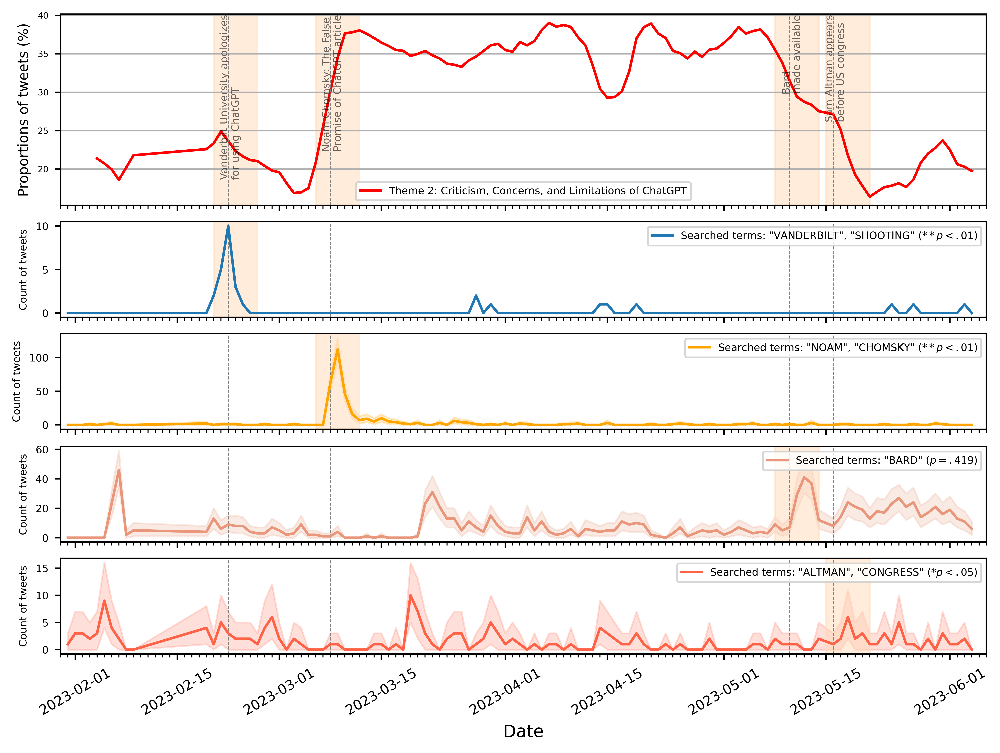

In [166]:
import matplotlib.pyplot as plt
plt.rc('legend',fontsize=6) # using a size in points

fig, ax = plt.subplots(5, 1, figsize=(8, 6), dpi=750, constrained_layout = True, gridspec_kw={'height_ratios': [2, 1, 1, 1, 1]})
sbs = daily_to_chatgpt_topic_df_sma[daily_to_chatgpt_topic_df_sma["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]
sns.lineplot(data=sbs, x="date", y="day_topic_pct_SMA_5", ax=ax[0],
                     color="red",
                     label="{}".format("Theme 2: Criticism, Concerns, and Limitations of ChatGPT"))
ax[0].axvspan("2023-02-20", "2023-02-26", color='peachpuff', alpha=0.5)
ax[0].axvspan("2023-03-06", "2023-03-12", color='peachpuff', alpha=0.5)
ax[0].axvspan("2023-05-08", "2023-05-14", color='peachpuff', alpha=0.5)
ax[0].axvspan("2023-05-15", "2023-05-21", color='peachpuff', alpha=0.5)
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=30, fontsize=8)
ax[0].xaxis.grid(False)
ax[0].yaxis.grid(True)
ax[0].set_xlabel(None)
ax[0].xaxis.set_minor_locator(min_loc)
ax[0].set_ylabel("Proportions of tweets (%)", fontsize=8)
ax[0].set_xticklabels([])
ax[0].tick_params(axis='y', labelsize=5)

plotted_dates = []
events = key_events_dates_df[key_events_dates_df["date"].isin(daily_to_chatgpt_topic_df_sma["date"])]
for i, event in events.iterrows():
    date = event["date"]
    event_desc = event["event"]
    mid = len(event_desc.split(" "))//2
    event_desc = " ".join(event_desc.split(" ")[0:mid]) + '\n' + " ".join(event_desc.split(" ")[mid:]) 
    if date in plotted_dates:
        continue

    offset = (-5, -0.3)
    if (date.month == 2 and date.day == 22) or\
    (date.month == 3 and date.day == 8) or\
    (date.month == 5 and date.day == 10) or\
    (date.month == 5 and date.day == 16):
        ax[0].axvline(date, color='gray', linestyle='--', linewidth=0.5)
        ax[1].axvline(date, color='gray', linestyle='--', linewidth=0.5)
        ax[2].axvline(date, color='gray', linestyle='--', linewidth=0.5)
        ax[3].axvline(date, color='gray', linestyle='--', linewidth=0.5)
        ax[4].axvline(date, color='gray', linestyle='--', linewidth=0.5)
        ax[0].annotate(event_desc, xy=(date, ax[0].get_ylim()[1]), xytext=offset, textcoords='offset points',
             rotation=90, va='top', ha='left', annotation_clip=False, fontsize=6, alpha=0.6, color='black')
        plotted_dates.append(date)
    ax[0].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))

topic2_tweets_df_event_keyword_occur_sum = combined_df_topic2_vanderblit.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=combined_df_topic2_vanderblit, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[1], label="{}".format("Searched terms: \"VANDERBILT\", \"SHOOTING\" ($ ** p < .01$)"), estimator="sum")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[1].axvspan("2023-02-20", "2023-02-26", color='peachpuff', alpha=0.5)
ax[1].xaxis.grid(False)
ax[1].yaxis.grid(True)
ax[1].xaxis.set_minor_locator(min_loc)
ax[1].set_xlabel(None)
ax[1].set_ylabel("Count of tweets", fontsize=6)
ax[1].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))
ax[1].set_xticklabels([])
ax[1].grid(False)
ax[1].legend(loc="upper right")
ax[1].tick_params(axis='y', labelsize=6)

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df_noam.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df_noam, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[2], label="{}".format("Searched terms: \"NOAM\", \"CHOMSKY\" ($ ** p < .01$)"), estimator="sum", color="orange")
ax[2].set_xticklabels(ax[2].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[2].axvspan("2023-03-06", "2023-03-12", color='peachpuff', alpha=0.5)
ax[2].xaxis.grid(False)
ax[2].yaxis.grid(True)
ax[2].xaxis.set_minor_locator(min_loc)
ax[2].set_xlabel(None)
ax[2].set_xticklabels([])
ax[2].set_ylabel("Count of tweets", fontsize=6)
ax[2].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))
ax[2].grid(False)
ax[2].legend(loc="upper right")
ax[2].tick_params(axis='y', labelsize=6)

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df_bard.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df_bard, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[3], label="{}".format("Searched terms: \"BARD\" ($p=.419$)"), estimator="sum", color="darksalmon")
ax[3].set_xticklabels(ax[3].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[3].axvspan("2023-05-08", "2023-05-14", color='peachpuff', alpha=0.5)
ax[3].xaxis.grid(False)
ax[3].yaxis.grid(True)
ax[3].xaxis.set_minor_locator(min_loc)
ax[3].set_xlabel(None)
ax[3].set_ylabel("Count of tweets", fontsize=6)
ax[3].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))
ax[3].grid(False)
ax[3].set_xticklabels([])
ax[3].legend(loc="upper right")
ax[3].tick_params(axis='y', labelsize=6)

topic2_tweets_df_event_keyword_occur_sum = topic2_tweets_df_altman_congress.groupby("date").agg({"contains_event_keywords_and_chatgpt_keyword": "sum"}).reset_index()
sns.lineplot(data=topic2_tweets_df_altman_congress, x="date", y="contains_event_keywords_and_chatgpt_keyword", ax=ax[4], label="{}".format("Searched terms: \"ALTMAN\", \"CONGRESS\" ($ * p < .05$)"), estimator="sum", color="tomato")
ax[4].set_xticklabels(ax[4].get_xticklabels(), rotation=30, fontsize=8)
min_loc = mdates.DayLocator()
ax[4].axvspan("2023-05-15", "2023-05-21", color='peachpuff', alpha=0.5)
ax[4].xaxis.grid(False)
ax[4].yaxis.grid(True)
ax[4].xaxis.set_minor_locator(min_loc)
ax[4].set_xlabel("Date")
ax[4].set_ylabel("Count of tweets", fontsize=6)
ax[4].set_xlim(datetime.datetime.strptime("2023-01-30", "%Y-%m-%d"), datetime.datetime.strptime("2023-06-06", "%Y-%m-%d"))
ax[4].grid(False)
ax[4].legend(loc="upper right")
ax[4].tick_params(axis='y', labelsize=6)

### Per topic (theme) sentiment

In [544]:
themes_topics_order = {"Topic 1: ChatGPT's Description, Functionality, and Applications.": 1,
                      "Topic 2: Criticism, Concerns, and Limitations of ChatGPT.": 2,
                      "Topic 3: AI in Education, Employment, and Various Industries.": 3,
                      "Topic 4: Comparison, Integration, and Advancements of AI Technologies.": 4,
                      "Topic 5: Ethics, Bias, and Regulation of AI.": 5,
                      "DIFFERENT": 6}

topic_labels = ["Topic 1:\nChatGPT's Description,\nFunctionality,\nand Applications.",
                      "Topic 2:\nCriticism,Concerns,\nand Limitations of ChatGPT.",
                      "Topic 3:\nAI in Education,\nEmployment,\nand Various Industries.",
                      "Topic 4:\nComparison, Integration,\nand Advancements\nof AI Technologies.",
                      "Topic 5:\nEthics, Bias,\nand Regulation\nof AI.",
                      "Other"]

In [546]:
# Normalized by engagement rate
fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(20, 8), dpi=700)
plt.style.use('default')
patterns =('/','\\',"xx")

dfs = {}
sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))
for i, topic in enumerate(sentiment_df_merged_sorted["gpt_classify"].unique().tolist()):
    if topic == "DIFFERENT":
        continue
    print(f"Examining topic: {topic}...")
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]
    sbs = sbs.sort_values(by=["week_num"], ascending=False)
    
    sentiment_pivt = sbs.groupby(by=['week_num', 'sentiment']).agg({"engagement_rate": "sum"}).reset_index().pivot(columns='sentiment', index='week_num', values="engagement_rate")
    sentiment_total = sentiment_pivt.sum(axis=1).reset_index().set_index("week_num").rename(columns={0: "total"})
    sentiment_pivt_all = pd.concat([sentiment_pivt, sentiment_total], axis=1)
    sentiment_rel = sentiment_pivt_all[sentiment_pivt_all.columns[0:-1]].div(sentiment_pivt_all[sentiment_pivt_all.columns[-1]], 0) * 100
    print(sentiment_pivt["Negative"].sum() / (sentiment_pivt["Negative"].sum() + sentiment_pivt["Positive"].sum() + sentiment_pivt["Neutral"].sum()) * 100)
    sentiment_rel_weeks = sentiment_rel[["Negative", "Positive", "Neutral"]]
    dfs[topic] = sentiment_rel_weeks
    
    sentiment_rel_weeks.plot(kind='bar', stacked=True, ax=ax[i], color=['red', 'green', 'whitesmoke'])
    bars = ax[i].patches
    hatches = ''.join(h*sentiment_rel_weeks.shape[0] for h in patterns)

    for bar, hatch in zip(bars, hatches):
        bar.set_hatch(hatch)

    ax[i].set_title("{}".format(topic_labels[i]), fontsize=9)
    ax[i].set_xlabel("Week (2023)")
    ax[i].tick_params(axis='x', rotation = 80)
    labels = [get_week_date_range_str(2023, int(item.get_text())) for item in ax[i].get_xticklabels()]
    ax[i].set_xticklabels(labels)
ax[0].set_ylabel("Percentage of tweets (%)\nNormalized by engagement rate")

Examining topic: Topic 1: ChatGPT's Description, Functionality, and Applications....
2.037335992891794
Examining topic: Topic 2: Criticism, Concerns, and Limitations of ChatGPT....
50.99211441301601
Examining topic: Topic 3: AI in Education, Employment, and Various Industries....
4.677438083099938
Examining topic: Topic 4: Comparison, Integration, and Advancements of AI Technologies....
4.314704777587686
Examining topic: Topic 5: Ethics, Bias, and Regulation of AI....
40.560114532745054


Text(0, 0.5, 'Percentage of tweets (%)\nNormalized by engagement rate')

In [560]:
sentiment_df_merged = sentiment_df_merged[sentiment_df_merged["created_at"] >= "2023-02-10"]
# Normalized by engagement rate
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 9), dpi=700)
plt.style.use('default')
patterns =('/','\\',"xx")
colors=["green", "red", "orange", "purple", "black"]
styles = ["-", ":", "solid", "-.", "dashdot", "--"]
markers = ["s", "P", "D", "*", "X"]

dfs = {}
sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))
sentiment_df_merged_sorted["sentiment_polarity_score"] = sentiment_df_merged_sorted[["sentiment", "sentiment_score"]].apply(lambda x: -x[1] if x[0] == "Negative" else 0 if x[0] == "Neutral" else x[1], axis=1)

for i, topic in enumerate(sentiment_df_merged_sorted["gpt_classify"].unique().tolist()):
    if topic == "DIFFERENT":
        continue
    print(f"Examining topic: {topic}...")
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]
    print("Count of Negative sentiment tweets in topic {}: {} ({}% from total in topic)".format(topic, sbs[sbs["sentiment"] == "Negative"].shape[0], 100 * sbs[sbs["sentiment"] == "Negative"].shape[0] / sbs.shape[0]))
    print("Count of Positive sentiment tweets in topic {}: {} ({}% from total in topic)".format(topic, sbs[sbs["sentiment"] == "Positive"].shape[0], 100 * sbs[sbs["sentiment"] == "Positive"].shape[0] / sbs.shape[0]))
    sbs = sbs.sort_values(by=["date"], ascending=False)
    
    sbs["sentiment_polarity_score_sma"] = sbs["sentiment_polarity_score"].rolling(window=5).mean()
    dfs[topic] = sbs.groupby(by=['date']).agg({"sentiment_polarity_score_sma": "mean"})
    sns.lineplot(data=sbs, x="date", y="sentiment_polarity_score_sma", ax=ax, label="{}".format(topic), color=colors[i], marker=markers[i], estimator="mean")
    print("=======================================================")

sns.lineplot(data=sentiment_df_merged_sorted, x="date", y="sentiment_polarity_score", ax=ax, label="All", color="gray", linestyle="--", estimator="mean")
    
ax.legend(title="Topic", title_fontsize=13, fontsize=12, ncols=2, loc=(-0.18, 1.03)) #loc=(1.02, 0.67))
ax.tick_params(axis='x', rotation=45, labelsize=12)
min_loc = mdates.DayLocator()
ax.xaxis.set_minor_locator(min_loc)
ax.set_ylabel("Mean sentiment polarity", fontsize=14)
ax.set_xlabel("Date", fontsize=14)

ax.xaxis.grid(False)
ax.yaxis.grid(True)
ax.set_ylim(-1, 1)

import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%d-%b-%Y')
ax.xaxis.set_major_formatter(myFmt)
ax.xaxis.set_major_formatter(myFmt)
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

Examining topic: Topic 1: ChatGPT's Description, Functionality, and Applications....
Count of Negative sentiment tweets in topic Topic 1: ChatGPT's Description, Functionality, and Applications.: 728 (2.6165402724364735% from total in topic)
Count of Positive sentiment tweets in topic Topic 1: ChatGPT's Description, Functionality, and Applications.: 15731 (56.53955360672825% from total in topic)
Examining topic: Topic 2: Criticism, Concerns, and Limitations of ChatGPT....
Count of Negative sentiment tweets in topic Topic 2: Criticism, Concerns, and Limitations of ChatGPT.: 27449 (51.50775928393162% from total in topic)
Count of Positive sentiment tweets in topic Topic 2: Criticism, Concerns, and Limitations of ChatGPT.: 6194 (11.622975736991236% from total in topic)
Examining topic: Topic 3: AI in Education, Employment, and Various Industries....
Count of Negative sentiment tweets in topic Topic 3: AI in Education, Employment, and Various Industries.: 1846 (6.093012509489388% from total

In [ ]:
# statistical test for trends
import pymannkendall as mk
for i, topic in enumerate(daily_to_chatgpt_topic_df_sma["gpt_classify"].unique().tolist()):
    if topic == "DIFFERENT":
        continue
    sbs = dfs[topic]
    for sentiment in ["Positive_sma", "Negative_sma"]:
        # Extract the time values and reshape them to a 2D array
        X = sbs.index.values
        # Extract the time series values and reshape them to a 1D array
        y = sbs[sentiment].values
        # Compute tau statistics
        trend, h, p, z, Tau, s, var_s, slope, intercept =  mk.original_test(y)
        print("{} ({})- trend={}, h={}, p={}, z={}, Tau={}, s={}, slope={}, intercept={}".format(topic, sentiment, trend, h, p, z, Tau, s, slope, intercept))
        print("===========================================")
        # sieve-bootstrap for potentially autocorrelated data

In [ ]:
# Kruskal - Wallis statistical test with post-hoc Dunn's test
stat, pvalue = stats.kruskal(*[df["Negative"] for topic, df in dfs.items()])
print("Kruskal-Wallis H-test: statstic={}; p_value={}".format(stat, pvalue))

# post hoc test
import scikit_posthocs as sp
post_hoc_pvalues_df = sp.posthoc_dunn([df["Negative"] for topic, df in dfs.items()], p_adjust = 'holm')
print("===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
post_hoc_pvalues_df

In [ ]:
# Positive vs. Negative for topic 1
post_hoc_pvalues_df_positive_negative_topic1 = sp.posthoc_dunn([dfs["Topic 1: ChatGPT's Description, Functionality, and Applications."]["Negative"], dfs["Topic 1: ChatGPT's Description, Functionality, and Applications."]["Positive"]], p_adjust='holm')
print("=========================================== post_hoc_pvalues_df_positive_negative_topic1 ===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
display(post_hoc_pvalues_df_positive_negative_topic1)

# Positive vs. Negative for topic 3
post_hoc_pvalues_df_positive_negative_topic3 = sp.posthoc_dunn([dfs["Topic 3: AI in Education, Employment, and Various Industries."]["Negative"], dfs["Topic 3: AI in Education, Employment, and Various Industries."]["Positive"]], p_adjust='holm')
print("=========================================== post_hoc_pvalues_df_positive_negative_topic3 ===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
display(post_hoc_pvalues_df_positive_negative_topic3)

# Positive vs. Negative for topic 4
post_hoc_pvalues_df_positive_negative_topic4 = sp.posthoc_dunn([dfs["Topic 4: Comparison, Integration, and Advancements of AI Technologies."]["Negative"], dfs["Topic 4: Comparison, Integration, and Advancements of AI Technologies."]["Positive"]], p_adjust='holm')
print("=========================================== post_hoc_pvalues_df_positive_negative_topic4 ===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
display(post_hoc_pvalues_df_positive_negative_topic4)

# Positive in topic 1 vs. Positive for topic 3
post_hoc_pvalues_df_positive1_positive_topic4 = sp.posthoc_dunn([dfs["Topic 3: AI in Education, Employment, and Various Industries."]["Positive"], dfs["Topic 1: ChatGPT's Description, Functionality, and Applications."]["Positive"]], p_adjust='holm')
print("=========================================== post_hoc_pvalues_df_positive1_positive_topic4 ===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
display(post_hoc_pvalues_df_positive1_positive_topic4)

In [ ]:
groups = []
for i in range(len(list(dfs.values()))):
    d = list(dfs.values())[i]["sentiment_polarity_score_sma"].values
    groups.append(d)

In [ ]:
# I think the Friedman test is appropriate here, continouts dependent variable of sentiment polatiry, repeated measures, dependent on time points.
from scipy.stats import friedmanchisquare
stat, pvalue = friedmanchisquare(*list(dfs.values()))
print("friedmanchisquare test: statstic={}; p_value={}".format(stat, pvalue))

import scikit_posthocs as sp
#perform Nemenyi post-hoc test
sp.posthoc_nemenyi_friedman(np.array(groups).T)

### Per topic (theme) emotion

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(20, 8), sharey=True, dpi=700)
plt.style.use('default')

topic_labels = ["Topic 1:\nChatGPT's Description,\nFunctionality,\nand Applications.",
                      "Topic 2:\nCriticism,Concerns,\nand Limitations of ChatGPT.",
                      "Topic 3:\nAI in Education,\nEmployment,\nand Various Industries.",
                      "Topic 4:\nComparison, Integration,\nand Advancements\nof AI Technologies.",
                      "Topic 5:\nEthics, Bias,\nand Regulation\nof AI.",
                      "Other"]

sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))
for i, topic in enumerate(sentiment_df_merged_sorted["gpt_classify"].unique().tolist()):
    print(f"Examining topic: {topic}...")
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]
    sbs = sbs.sort_values(by=["week_num"], ascending=False)
    
    sentiment_pivt = sbs.groupby(by=['week_num', 'emotion']).size().reset_index().pivot(columns='emotion', index='week_num', values=0)
    sentiment_total = sentiment_pivt.sum(axis=1).reset_index().set_index("week_num").rename(columns={0: "total"})
    sentiment_pivt_all = pd.concat([sentiment_pivt, sentiment_total], axis=1)
    sentiment_rel = sentiment_pivt_all[sentiment_pivt_all.columns[0:-1]].div(sentiment_pivt_all[sentiment_pivt_all.columns[-1]], 0) * 100
    sentiment_rel_weeks = sentiment_rel[["anger", "disgust", "fear", "joy", "sadness", "surprise", "neutral"]]
    
    sentiment_rel_weeks.plot(kind='bar', stacked=True, ax=ax[i], color=['red', 'olivedrab', 'lightcoral', 'yellow', 'tan', "blue", 'whitesmoke'])
    ax[i].set_title("{}".format(topic_labels[i]), fontsize=9)
    ax[i].set_xlabel("Calendar Week (2023)")
    ax[i].tick_params(axis='x', rotation = 80)
    labels = [get_week_date_range_str(2023, int(item.get_text())) for item in ax[i].get_xticklabels()]
    ax[i].set_xticklabels(labels)
    if i != 5:
        ax[i].get_legend().remove()
ax[0].set_ylabel("Percentage of tweets")

# Add the main title
fig.suptitle("Proportion of tweets per emotion over extracted topics", fontsize=15)

### Per topic (theme) engagement rate

In [561]:
sentiment_df_merged["gpt_classify"] = sentiment_df_merged["gpt_classify"].replace("Different", "DIFFERENT")
sentiment_df_merged = sentiment_df_merged[sentiment_df_merged["gpt_classify"] != "TRASH"]

In [562]:
def reject_outliers(data, m=2):
    return data[abs(data - np.mean(data)) < m * np.std(data)]

In [ ]:
eng_topic2 = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]["engagement_rate"]
eng_topic2_no_outliers = eng_topic2

In [586]:
import matplotlib.pyplot as plt
# only topic 2 vs topic 5
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 9), sharey=True, dpi=750)
plt.style.use('default')

colors=["green", "red", "orange", "purple", "black"]
styles = ["-", ":", "solid", "-.", "dashdot", "--"]
markers = ["s", "P", "D", "*", "X"]

groups = []
sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))

for i, topic in enumerate(sentiment_df_merged_sorted["gpt_classify"].unique().tolist()):
    print(f"Examining topic: {topic}...")
    if topic == "DIFFERENT":
        continue
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]
    sbs = sbs[sbs["sentiment"] == "Negative"]
    transformer = RobustScaler(with_centering=False, with_scaling=False)
    sbs["engagement_rate"] = sbs[["impression_count", "engagement_rate"]].apply(lambda x: 1 / x[0] if x[1] == 0 else x[1], axis=1)
    sbs["engagement_rate"] = sbs["engagement_rate"] * 10
    sbs["engagement_rate"] = sbs["engagement_rate"].apply(lambda x: min(x, 1))
    sbs["engagement_rate_norm"] = transformer.fit_transform(sbs["engagement_rate"].values.reshape(-1, 1))
    
    sbs_day_grouped = sbs.groupby(["date"]).agg({"engagement_rate_norm": "median"})
    sbs_day_grouped["engagement_rate_norm_sma"] = sbs_day_grouped["engagement_rate_norm"].rolling(window=14).mean()
    
    axj = sns.lineplot(data=sbs_day_grouped, x="date", y="engagement_rate_norm_sma", marker=markers[i], color=colors[i], # estimator=np.median, 
                  # err_style="bars", errorbar=("ci", 95), err_kws={'capsize':1.5, 'ecolor': 'lightgray'},
                       ax=ax, label=topic)
    groups.append(sbs_day_grouped["engagement_rate_norm_sma"].fillna(sbs_day_grouped["engagement_rate_norm_sma"].values[14]).values)
    
sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["sentiment"] == "Negative"]
transformer = RobustScaler(with_centering=False, with_scaling=False)
sbs["engagement_rate"] = sbs[["impression_count", "engagement_rate"]].apply(lambda x: 1 / x[0] if x[1] == 0 else x[1], axis=1)
sbs["engagement_rate"] = sbs["engagement_rate"] * 10
sbs["engagement_rate"] = sbs["engagement_rate"].apply(lambda x: min(x, 1))
sbs["engagement_rate_norm"] = transformer.fit_transform(sbs["engagement_rate"].values.reshape(-1, 1))

sbs_day_grouped_all = sbs.groupby(["date"]).agg({"engagement_rate_norm": "median"})
sbs_day_grouped_all["engagement_rate_norm_sma"] = sbs_day_grouped_all["engagement_rate_norm"].rolling(window=14).mean()

axj2 = sns.lineplot(data=sbs_day_grouped_all, x="date", y="engagement_rate_norm_sma", linestyle="--", color="gray", # estimator=np.median, 
                  # err_style="bars", errorbar=("ci", 95), err_kws={'capsize':1.5, 'ecolor': 'lightgray'},
                   ax=ax, label="All")

ax.set_xlabel("Date", fontsize=14)
# ax.set_xticklabels(labels, rotation = 45)
ax.xaxis.grid(False)
ax.yaxis.grid(False)
ax.set_xlim(19402, 19517) # show on xaxis the date 14-Feb to 08-Jun
plt.xticks(rotation = 45)
ax.set_ylabel("Median engagement rate", fontsize=14)
ax.legend(title="Topic", title_fontsize=13, fontsize=12, ncols=2, loc=(-0.18, 1.03)) #loc=(1.02, 0.67))

min_loc = mdates.DayLocator()
ax.xaxis.grid(False)
ax.yaxis.grid(True)
ax.xaxis.set_minor_locator(min_loc)
import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%d-%b-%Y')
ax.xaxis.set_major_formatter(myFmt)
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

Examining topic: Topic 1: ChatGPT's Description, Functionality, and Applications....
Examining topic: Topic 2: Criticism, Concerns, and Limitations of ChatGPT....
Examining topic: Topic 3: AI in Education, Employment, and Various Industries....
Examining topic: Topic 4: Comparison, Integration, and Advancements of AI Technologies....
Examining topic: Topic 5: Ethics, Bias, and Regulation of AI....
Examining topic: DIFFERENT...


In [ ]:
from scipy.stats import friedmanchisquare
groups[0] = np.array(list(groups[0]) + [0, 0])
stat, pvalue = stats.stats.friedmanchisquare(*groups)
print("friedmanchisquare test: statstic={}; p_value={}".format(stat, pvalue))

import scikit_posthocs as sp
#perform Nemenyi post-hoc test
sp.posthoc_nemenyi_friedman(np.array(groups).T)

In [ ]:
from scipy import stats
# Check the two curves of topic 2 and topic 5 have the same gradients and their min diff is zero.
U1, p = stats.wilcoxon(np.gradient(groups[1]),
                       np.gradient(groups[4]),
                       correction=True, alternative='two-sided',
                       method="exact")
print("Wilcoxon test: two groups: statistic={}, pvalue={}".format(U1, p))

In [ ]:
import matplotlib.pyplot as plt
# only topic 2 vs topic 5
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12, 9), sharey=True, dpi=750)
plt.style.use('default')

colors=["green", "red", "orange", "purple", "black"]
styles = ["-", ":", "solid", "-.", "dashdot", "--"]
markers = ["s", "P", "D", "*", "X"]

sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))

sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["sentiment"] == "Negative"]
transformer = RobustScaler(with_centering=False, with_scaling=False)
sbs["engagement_rate"] = sbs[["impression_count", "engagement_rate"]].apply(lambda x: 1 / x[0] if x[1] == 0 else x[1], axis=1)
sbs["engagement_rate"] = sbs["engagement_rate"] * 10
sbs["engagement_rate"] = sbs["engagement_rate"].apply(lambda x: min(x, 1))
sbs["engagement_rate_norm"] = transformer.fit_transform(sbs["engagement_rate"].values.reshape(-1, 1))
    
sbs_day_grouped = sbs.groupby(["date"]).agg({"engagement_rate_norm": "median"})
sbs_day_grouped["engagement_rate_norm_sma"] = sbs_day_grouped["engagement_rate_norm"].rolling(window=14).mean()

axj = sns.lineplot(data=sbs_day_grouped, x="date", y="engagement_rate_norm_sma", marker=markers[0], color="black", # estimator=np.median, 
                  # err_style="bars", errorbar=("ci", 95), err_kws={'capsize':1.5, 'ecolor': 'lightgray'},
                   ax=ax, label="All")

ax.set_xlabel("Date", fontsize=14)
# ax.set_xticklabels(labels, rotation = 45)
ax.xaxis.grid(False)
ax.yaxis.grid(False)
plt.xticks(rotation = 45)
ax.set_ylabel("Median engagement rate", fontsize=14)
ax.legend(title = "Topic", title_fontsize=13, fontsize=12, ncols=2, loc=(-0.18, 1.03)) #loc=(1.02, 0.67))

min_loc = mdates.DayLocator()
ax.xaxis.grid(False)
ax.yaxis.grid(True)
ax.xaxis.set_minor_locator(min_loc)
import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%d-%b-%Y')
ax.xaxis.set_major_formatter(myFmt)
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

In [ ]:
topic_labels = ["Topic 2:\nCriticism, Concerns,\nand Limitations of ChatGPT.",
                "Topic 5:\nEthics, Bias, and Regulation of AI."]

groups = []
groups_median_overtime = []
for i, topic in enumerate([v.replace("\n", " ") for v in topic_labels]):
    print(f"Examining topic: {topic}...")
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]
    # sbs = sbs[sbs["sentiment"] == "Negative"]
    sbs["engagement_rate"] = sbs[["impression_count", "engagement_rate"]].apply(lambda x: 1 / x[0] if x[1] == 0 else x[1], axis=1)
    sbs["engagement_rate"] = sbs["engagement_rate"] * 10
    groups.append(sbs["engagement_rate"])
    
    medians_overtime = [item for sublist in sbs.groupby("week_num").agg({"engagement_rate": "median"}).values for item in sublist]
    groups_median_overtime.append(medians_overtime)
    
    print("======== on engagement rates (not median) ===========")
    print("N", sbs["engagement_rate"].shape[0])
    print("Mean", sbs["engagement_rate"].mean())
    print("STD", sbs["engagement_rate"].std())
    print("Median", sbs["engagement_rate"].median())
    print("Min", sbs["engagement_rate"].min())
    print("Max", sbs["engagement_rate"].max())
    print("Min median ", sbs.groupby(["week_num"]).agg({"engagement_rate": "median"}).min().values[0])
    print("Max median ", sbs.groupby(["week_num"]).agg({"engagement_rate": "median"}).max().values[0])
    
    print("======== on engagement rates (medians) ===========")
    print("N", len(medians_overtime))
    print("Mean", np.array(medians_overtime).mean())
    print("STD", np.array(medians_overtime).std())
    print("Median", np.median(medians_overtime))
    print("Min", np.array(medians_overtime).min())
    print("Max", np.array(medians_overtime).max())
    print("Min median ", sbs.groupby(["week_num"]).agg({"engagement_rate": "median"}).min().values[0])
    print("Max median ", sbs.groupby(["week_num"]).agg({"engagement_rate": "median"}).max().values[0])
    
stat, pvalue = stats.kruskal(*groups)
print("Kruskal-Wallis H-test: statstic={}; p_value={}".format(stat, pvalue))

# post hoc test
import scikit_posthocs as sp
post_hoc_pvalues_df = sp.posthoc_dunn(groups, p_adjust = 'holm')
print("===========================================")
pd.set_option('display.float_format', lambda x: '%.8f' % x)
post_hoc_pvalues_df

In [ ]:
from scipy import stats

statistic, pvalue = stats.fligner(*groups)
print("Flinger Test for variance equality between the two groups: statistic={}, pvalue={}".format(statistic, pvalue))
U1, p = stats.mannwhitneyu(groups[0].values, groups[1].values, method="auto")
print("Man Whitney U test: two groups: statistic={}, pvalue={}".format(U1, p))
t, pval = stats.ttest_ind(groups[0].values, groups[1].values, equal_var=False)
print("T test: two groups: statistic={}, pvalue={}".format(t, pval))

In [ ]:
from scipy import stats

U1, p = stats.wilcoxon(groups_median_overtime[0], groups_median_overtime[1], method="auto")
print("wilcoxon test: two groups: statistic={}, pvalue={}".format(U1, p))

In [ ]:
import pymannkendall as mk
for i, topic in enumerate([v.replace("\n", " ") for v in topic_labels]):
    print(topic)
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]
    sbs = sbs[sbs["sentiment"] == "Negative"]
    sbs["engagement_rate"] = sbs[["impression_count", "engagement_rate"]].apply(lambda x: 1 / x[0] if x[1] == 0 else x[1], axis=1)
    sbs["engagement_rate"] = sbs["engagement_rate"] * 10
    # Extract the time values and reshape them to a 2D array
    X = sbs.week_num.values
    # Extract the time series values and reshape them to a 1D array
    y = sbs["engagement_rate"].values
    # Compute tau statistics
    trend, h, p, z, Tau, s, var_s, slope, intercept = mk.original_test(y, alpha=0.05)
    print("{} - trend={}, h={}, p={}, z={}, Tau={}, s={}, slope={}, intercept={}".format(topic, trend, h, p, z, Tau, s, slope, intercept))
    print("===========================================")
    # sieve-bootstrap for potentially autocorrelated data

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=750)
plt.style.use('default')

sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))

topic_labels = ["Topic 1:\nChatGPT's Description,\nFunctionality,\nand Applications.",
                      "Topic 2:\nCriticism,Concerns,\nand Limitations of ChatGPT.",
                      "Topic 3:\nAI in Education,\nEmployment,\nand Various Industries.",
                      "Topic 4:\nComparison, Integration,\nand Advancements\nof AI Technologies.",
                      "Topic 5:\nEthics, Bias,\nand Regulation\nof AI.",
                      "Other"]

sns.barplot(x='gpt_classify', y='engagement_rate', data=sentiment_df_merged_sorted, palette='CMRmap_r', estimator=np.mean)
ax.set_xlabel("Topic")
ax.set_ylabel("Average tweet engagement rate")
ax.set_xticklabels(topic_labels, fontsize=6)

### Per topic topic modeling

In [86]:
np.random.seed(42)

In [87]:
sentiment_df_merged_sorted = sentiment_df_merged.sort_values('gpt_classify', key=lambda x: x.map(themes_topics_order))

In [128]:
connector_words=["chatgpt", "gpt", "chatGPT", "GPT", "ChatGPT", "CHATGPT"]
# Build the bigram and trigram models
bigram = gensim.models.Phrases(sentiment_df_merged_sorted["tokens"], min_count=1, connector_words=list(gensim.models.phrases.ENGLISH_CONNECTOR_WORDS) + connector_words) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[sentiment_df_merged_sorted["tokens"]], min_count=1, connector_words=list(gensim.models.phrases.ENGLISH_CONNECTOR_WORDS) + connector_words)
# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

In [91]:
sentiment_df_merged_sorted['bigrams_tokens'] = sentiment_df_merged_sorted["tokens"].progress_apply(lambda x: make_bigrams(x))
sentiment_df_merged_sorted['trigrams_tokens'] = sentiment_df_merged_sorted["tokens"].progress_apply(lambda x: make_trigrams(x))

  0%|          | 0/244288 [00:00<?, ?it/s]

  0%|          | 0/244288 [00:00<?, ?it/s]

In [ ]:
num_topics = 3
num_words = 500
lda_models = {}
np.random.seed(42)

for i, topic in enumerate(sentiment_df_merged_sorted["gpt_classify"].unique().tolist()):
    if topic == "Different":
        continue
    print(f"Examining topic: {topic}...")
    sbs = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == topic]

    # Create dictionary
    dictionary = Dictionary(sbs["trigrams_tokens"])
    # Filter dictionary
    dictionary.filter_extremes(no_below=3, no_above=0.60, keep_n=100_000)
    print(len(dictionary))
    # Create corpus
    corpus = [dictionary.doc2bow(doc) for doc in sbs["trigrams_tokens"]]
    
    lda_model = LdaModel(corpus=tqdm(corpus), id2word=dictionary, iterations=50, num_topics=num_topics,
                         passes=10, minimum_probability=0.05, alpha='auto', random_state=42)
    
    coherence_model_lda = gensim.models.CoherenceModel(model=lda_model, texts=sbs["trigrams_tokens"],
                                                       dictionary=dictionary, coherence='c_v')
    coherence_lda = coherence_model_lda.get_coherence()
    print("Topic {}: coherence_lda: {}".format(topic, coherence_lda))
    
    topics_word_prob_pairs = lda_model.show_topics(num_topics, num_words, formatted=False)
    topics = [[w[0] for w in word_prob_pairs[-1]] for word_prob_pairs in topics_word_prob_pairs]
    topics_with_weight = [[(w[0], w[1]) for w in word_prob_pairs[-1]] for word_prob_pairs in topics_word_prob_pairs]
    topics_with_weight_df = pd.DataFrame(topics_with_weight)
    topics_words_df = pd.DataFrame(topics)
    topics_words_df.index += 1
    topics_words_df.columns=["Word_{}".format(i + 1) for i in range(num_words)]
    topics_words_df = topics_words_df.reset_index().rename(columns={"index": 'Topic num'})
    lda_models[topic] = (lda_model, corpus, topics_words_df, topics_with_weight_df)
    
    display(topics_words_df)
    print("=============================")

### Draw distribution of subtopics

In [93]:
docs_count_per_topic_above_thr_dfs = {}

for topic_name, lda_mod_corpus in lda_models.items():
    lda_mod, corpus, words, weights = lda_mod_corpus
    print(f"Examining topic: {topic_name}...")
    document_topics_dist = lda_mod.get_document_topics(corpus, minimum_probability=0.05, minimum_phi_value=None, per_word_topics=False)
    document_topics_dist_df = pd.DataFrame.from_records(document_topics_dist, columns=['Topic {}'.format(i + 1) for i in range(3)])
    document_topics_dist_df = document_topics_dist_df.applymap(lambda x: x[1] if x is not None else 0)
    
    subtopic_per_doc = document_topics_dist_df.idxmax(axis=1)
    docs_count_per_topic_above_thr = document_topics_dist_df.idxmax(axis=1).value_counts().reset_index(drop=False)
    
    docs_count_per_topic_above_thr["index"] = docs_count_per_topic_above_thr["index"].apply(lambda x: int(x.split(" ")[-1]))
    docs_count_per_topic_above_thr_df = docs_count_per_topic_above_thr.rename(columns={"index": 'Topic num', 0: 'Count'})
    docs_count_per_topic_above_thr_df = docs_count_per_topic_above_thr_df.sort_values(by='Topic num')
    docs_count_per_topic_above_thr_df["Count_pct"] = round(100 * docs_count_per_topic_above_thr_df["Count"] / docs_count_per_topic_above_thr_df["Count"].sum(), 2)
    docs_count_per_topic_above_thr_dfs[topic_name] = (docs_count_per_topic_above_thr_df, subtopic_per_doc, words)

Examining topic: Topic 1: ChatGPT's Description, Functionality, and Applications....
Examining topic: Topic 2: Criticism, Concerns, and Limitations of ChatGPT....
Examining topic: Topic 3: AI in Education, Employment, and Various Industries....
Examining topic: Topic 4: Comparison, Integration, and Advancements of AI Technologies....
Examining topic: Topic 5: Ethics, Bias, and Regulation of AI....
Examining topic: DIFFERENT...


In [94]:
per_doc_topic2 = docs_count_per_topic_above_thr_dfs["Topic 2: Criticism, Concerns, and Limitations of ChatGPT."][1]
topic2_df = pd.concat([sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."].reset_index(), per_doc_topic2], axis=1)
topic2_df = topic2_df.rename(columns={0: "Sub-topic"})
per_doc_topic5 = docs_count_per_topic_above_thr_dfs["Topic 5: Ethics, Bias, and Regulation of AI."][1]
topic5_df = pd.concat([sentiment_df_merged[sentiment_df_merged["gpt_classify"] == "Topic 5: Ethics, Bias, and Regulation of AI."].reset_index(), per_doc_topic5], axis=1)
topic5_df = topic5_df.rename(columns={0: "Sub-topic"})

In [96]:
# topic2
week_num_to_topic2_df = topic2_df[["id", "week_num", "Sub-topic"]].groupby(["week_num", "Sub-topic"]).count().unstack(fill_value=0).stack().reset_index(drop=False)
week_num_count2_df = topic2_df.groupby(["week_num"]).count()["id"].reset_index().rename(columns={"id": "week_count"})
week_num_to_topic2_df = week_num_to_topic2_df.merge(week_num_count2_df, left_on="week_num", right_on="week_num", how="inner")
week_num_to_topic2_df = week_num_to_topic2_df.reset_index(drop=True).rename(columns={"id": "count"})
week_num_to_topic2_df["week_topic_pct"] = round(100 * week_num_to_topic2_df["count"] / week_num_to_topic2_df["week_count"], 2)
week_num_to_topic2_df["week_num"] = week_num_to_topic2_df["week_num"].map({week: get_week_date_range_str(2023, week) for week in range(1, 52)})

week_num_to_topic5_df = topic5_df[["id", "week_num", "Sub-topic"]].groupby(["week_num", "Sub-topic"]).count().unstack(fill_value=0).stack().reset_index(drop=False)
week_num_count5_df = topic5_df.groupby(["week_num"]).count()["id"].reset_index().rename(columns={"id": "week_count"})
week_num_to_topic5_df = week_num_to_topic5_df.merge(week_num_count5_df, left_on="week_num", right_on="week_num", how="inner")
week_num_to_topic5_df = week_num_to_topic5_df.reset_index(drop=True).rename(columns={"id": "count"})
week_num_to_topic5_df["week_topic_pct"] = round(100 * week_num_to_topic5_df["count"] / week_num_to_topic5_df["week_count"], 2)
week_num_to_topic5_df["week_num"] = week_num_to_topic5_df["week_num"].map({week: get_week_date_range_str(2023, week) for week in range(1, 52)})

week_num_to_topic5_df.head()

,week_num,Sub-topic,count,week_count,week_topic_pct
0,30/01-05/02,Topic 1,137,4500,3.04
1,30/01-05/02,Topic 2,4210,4500,93.56
2,30/01-05/02,Topic 3,153,4500,3.40
3,06/02-12/02,Topic 1,85,1429,5.95
4,06/02-12/02,Topic 2,1285,1429,89.92


In [168]:
terms = []
for tl in sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == "Topic 5: Ethics, Bias, and Regulation of AI."]["trigrams_tokens"]:
    terms.extend(tl)

from collections import defaultdict
topic5_counts = defaultdict(lambda: 0)

topic5_tokens_list = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == "Topic 5: Ethics, Bias, and Regulation of AI."]["tokens"]
topic2_tokens_list = sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]["tokens"]

In [172]:
import itertools
from itertools import chain
from collections import Counter
from tqdm import tqdm

flat_list_trigrams_topic2 = chain.from_iterable(sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == "Topic 2: Criticism, Concerns, and Limitations of ChatGPT."]["trigrams_tokens"])
topic2_counter = Counter(flat_list_trigrams_topic2)
flat_list_trigrams_topic5 = chain.from_iterable(sentiment_df_merged_sorted[sentiment_df_merged_sorted["gpt_classify"] == "Topic 5: Ethics, Bias, and Regulation of AI."]["trigrams_tokens"])
topic5_counter = Counter(flat_list_trigrams_topic5)

w_counts_topic2 = {}
w_counts_topic5 = {}
for w in tqdm(list(set(list(itertools.chain(*topic2_words_df.iloc[:, 1:].values.tolist()))))):
    w_words = w.split(" ")
    w_counts_topic2[w] = 0
    for l in topic2_tokens_list:
        if ((w_words[0] in l) and (w_words[1] in l)) or ((w_words[0] in l) and (w_words[2] in l))  or ((w_words[1] in l) and (w_words[2] in l)):
            w_counts_topic2[w] += 1
    
for w in tqdm(list(set(list(itertools.chain(*topic5_words_df.iloc[:, 1:].values.tolist()))))):
    w_words = w.split(" ")
    w_counts_topic5[w] = 0
    for l in topic5_tokens_list:
        if ((w_words[0] in l) and (w_words[1] in l)) or ((w_words[0] in l) and (w_words[2] in l))  or ((w_words[1] in l) and (w_words[2] in l)):
            w_counts_topic5[w] += 1
# display(w_counts_topic2)
# display(w_counts_topic5)

100%|████████████████████████████████████████████████████████████████████████████████| 608/608 [00:59<00:00, 10.14it/s]


In [ ]:
sorted(w_counts_topic5.items(), key=lambda x: x[1], reverse=True)

In [100]:
topic2_with_weights_df = lda_models["Topic 2: Criticism, Concerns, and Limitations of ChatGPT."][-1]
topic2_with_weights_df = topic2_with_weights_df.apply(lambda x: x[0]).T
topic2_with_weights_df = topic2_with_weights_df.rename(columns={0: "word", 1: "weight"})

topic5_with_weights_df = lda_models["Topic 5: Ethics, Bias, and Regulation of AI."][-1]
topic5_with_weights_df = topic5_with_weights_df.apply(lambda x: x[0]).T

topic5_with_weights_df= topic5_with_weights_df.rename(columns={0: "word", 1: "weight"})
topic_with_weights_df_comb = topic2_with_weights_df.set_index("word")
topic_with_weights_df_comb = topic_with_weights_df_comb.rename(columns={"weight": "weight_topic_2"})
topic_with_weights_df_comb = topic_with_weights_df_comb.merge(topic5_with_weights_df, on="word", how="inner")
topic_with_weights_df_comb = topic_with_weights_df_comb.rename(columns={"weight": "weight_topic_5"})
topic_with_weights_df_comb

,word,weight_topic_2,weight_topic_5
0,up fake guardian,0.027146,0.000248
1,aificial intelligence chatbot,0.019932,0.015463
2,fake chatgpt chrome,0.013473,0.000248
3,language model train,0.012411,0.000247
4,aificialintelligence machinelearning deeplearning,0.00997,0.000247
...,...,...,...
72,sophisticated thought language,0.000162,0.000248
73,pew research center,0.000162,0.000249
74,weapon mass destruction,0.000162,0.00028
75,lack critical thinking,0.000161,0.000248


In [101]:
topic_with_weights_df_comb_leftjoin = topic2_with_weights_df.set_index("word")
topic_with_weights_df_comb_leftjoin = topic_with_weights_df_comb_leftjoin.rename(columns={"weight": "weight_topic_2"})
topic_with_weights_df_comb_leftjoin = topic_with_weights_df_comb_leftjoin.merge(topic5_with_weights_df, on="word", how="left")
topic_with_weights_df_comb_leftjoin = topic_with_weights_df_comb_leftjoin.rename(columns={"weight": "weight_topic_5"})
topic_with_weights_df_comb_leftjoin

,word,weight_topic_2,weight_topic_5
0,generate fake citation,0.037574,NaN
1,up fake guardian,0.027146,0.000248
2,good bad ugly,0.026136,NaN
3,aificial intelligence chatbot,0.019932,0.015463
4,fake chatgpt extension,0.018311,NaN
...,...,...,...
495,lack critical thinking,0.000161,0.000248
496,google stack overflow,0.000161,NaN
497,chomsky false promise,0.000161,NaN
498,tie up knot,0.000161,NaN


In [184]:
# by corrected counts of trigrams of topics 2 and 5
print("Topic 2 top by weight\n===========================")
topic2_with_weights_df_sorted = topic2_with_weights_df.sort_values(by=["weight"], ascending=False)
topic2_with_weights_df_sorted["word_count"] = np.nan
topic2_with_weights_df_sorted["word_count"] = topic2_with_weights_df_sorted["word"].apply(lambda x: w_counts_topic2[x])
topic2_with_weights_df_sorted["weight"] = topic2_with_weights_df_sorted["weight"] * 100
# Remove intersection words between topic 2 and topic 5
display(topic2_with_weights_df_sorted[~topic2_with_weights_df_sorted["word"].isin(topic_with_weights_df_comb["word"])].head(15))

print("Topic 5 top by weight\n===========================")
topic5_with_weights_df_sorted = topic5_with_weights_df.sort_values(by=["weight"], ascending=False)
topic5_with_weights_df_sorted["word_count"] = np.nan
topic5_with_weights_df_sorted["word_count"] = topic5_with_weights_df_sorted["word"].apply(lambda x: w_counts_topic5[x])
topic5_with_weights_df_sorted["weight"] = topic5_with_weights_df_sorted["weight"] * 100
# Remove intersection words between topic 2 and topic 5
display(topic5_with_weights_df_sorted[~topic5_with_weights_df_sorted["word"].isin(topic_with_weights_df_comb["word"])].head(15))

Topic 2 top by weight


,word,weight,word_count
0,generate fake citation,3.757403,652
2,good bad ugly,2.613552,1128
4,fake chatgpt extension,1.831091,3598
5,bias allow hate,1.465494,29
6,openai cybersecurity robotics,1.400802,87
9,answer difficult discern,1.056117,29
12,speech conservative man,0.92006,21
14,generative bad environment,0.805375,78
16,think outside box,0.793458,39
17,replace search engine,0.773037,441


Topic 5 top by weight


,word,weight,word_count
0,human solve captcha,4.999911,101
1,use racial slur,3.129382,70
2,political bias irreparable,2.530922,659
4,aificial intelligence tool,1.866007,1066
5,spread fake news,1.669623,626
6,use outsource kenyan,1.638089,53
10,pass turing test,1.469248,41
12,economic political disruption,1.340695,31
13,laborer earn hour,1.315052,18
14,andy vermaut share,1.266049,30


In [183]:
# by corrected counts of trigrams of topics 2 and 5
print("Topic 2 top by count and weight\n===========================")
topic2_with_weights_df_sorted = copy.copy(topic2_with_weights_df)
topic2_with_weights_df_sorted["word_count"] = np.nan
topic2_with_weights_df_sorted["word_count"] = topic2_with_weights_df_sorted["word"].apply(lambda x: w_counts_topic2[x])
topic2_with_weights_df_sorted["word_count_weight"] = topic2_with_weights_df_sorted["word_count"] * topic2_with_weights_df_sorted["weight"]
topic2_with_weights_df_sorted["weight"] = topic2_with_weights_df_sorted["weight"] * 100
topic2_with_weights_df_sorted = topic2_with_weights_df_sorted.sort_values(by=["word_count_weight"], ascending=False)
# Remove intersection words between topic 2 and topic 5
tpc2_df = topic2_with_weights_df_sorted[~topic2_with_weights_df_sorted["word"].isin(topic_with_weights_df_comb["word"])]
display(tpc2_df.head(15))

print("Topic 5 top by count and weight\n===========================")
topic5_with_weights_df_sorted = copy.copy(topic5_with_weights_df)
topic5_with_weights_df_sorted["word_count"] = np.nan
topic5_with_weights_df_sorted["word_count"] = topic5_with_weights_df_sorted["word"].apply(lambda x: w_counts_topic5[x])
topic5_with_weights_df_sorted["word_count_weight"] = topic5_with_weights_df_sorted["word_count"] * topic5_with_weights_df_sorted["weight"]
topic5_with_weights_df_sorted["weight"] = topic5_with_weights_df_sorted["weight"] * 100
topic5_with_weights_df_sorted = topic5_with_weights_df_sorted.sort_values(by=["word_count_weight"], ascending=False)
# Remove intersection words between topic 2 and topic 5
tpc5_df = topic5_with_weights_df_sorted[~topic5_with_weights_df_sorted["word"].isin(topic_with_weights_df_comb["word"])]
display(tpc5_df.head(15))

Topic 2 top by count and weight


,word,weight,word_count,word_count_weight
4,fake chatgpt extension,1.831091,3598,65.882641
2,good bad ugly,2.613552,1128,29.480868
0,generate fake citation,3.757403,652,24.498265
33,advanced language model,0.621761,1186,7.374084
31,official chatgpt app,0.644466,958,6.173988
69,stop chatgpt development,0.417203,1093,4.560024
64,aificial intelligence bot,0.433535,1028,4.456739
19,elon musk stress,0.771202,496,3.825161
74,popular aificial intelligence,0.373133,1010,3.768644
92,predictive language model,0.298786,1173,3.504758


Topic 5 top by count and weight


,word,weight,word_count,word_count_weight
4,aificial intelligence tool,1.866007,1066,19.891633
2,political bias irreparable,2.530922,659,16.678777
5,spread fake news,1.669623,626,10.451837
28,aificalintelligence aificial intelligence,0.868862,1057,9.183875
40,rise aificial intelligence,0.65055,1056,6.869811
0,human solve captcha,4.999911,101,5.04991
63,aificial intelligence act,0.378577,1060,4.012921
67,aificial intelligence base,0.365893,1070,3.915052
95,aificial intelligence world,0.280191,1080,3.026064
25,prevent chatgpt cheating,0.942452,277,2.610592


In [103]:
print("Topic 2 top by count and weight\n===========================")
topic2_with_weights_df_sorted = copy.copy(topic2_with_weights_df)
topic2_with_weights_df_sorted["word_count"] = np.nan
topic2_with_weights_df_sorted["word_count"] = topic2_with_weights_df_sorted["word"].apply(lambda x: w_counts_topic2[x])
topic2_with_weights_df_sorted["word_count_weight"] = topic2_with_weights_df_sorted["word_count"] * topic2_with_weights_df_sorted["weight"]
topic2_with_weights_df_sorted["weight"] = topic2_with_weights_df_sorted["weight"] * 100
topic2_with_weights_df_sorted = topic2_with_weights_df_sorted.sort_values(by=["word_count_weight"], ascending=False)
# Remove intersection words between topic 2 and topic 5
tpc2_df = topic2_with_weights_df_sorted[~topic2_with_weights_df_sorted["word"].isin(topic_with_weights_df_comb["word"])]
display(tpc2_df.head(15))

print("Topic 5 top by count and weight\n===========================")
topic5_with_weights_df_sorted = copy.copy(topic5_with_weights_df)
topic5_with_weights_df_sorted["word_count"] = np.nan
topic5_with_weights_df_sorted["word_count"] = topic5_with_weights_df_sorted["word"].apply(lambda x: w_counts_topic5[x])
topic5_with_weights_df_sorted["word_count_weight"] = topic5_with_weights_df_sorted["word_count"] * topic5_with_weights_df_sorted["weight"]
topic5_with_weights_df_sorted["weight"] = topic5_with_weights_df_sorted["weight"] * 100
topic5_with_weights_df_sorted = topic5_with_weights_df_sorted.sort_values(by=["word_count_weight"], ascending=False)
# Remove intersection words between topic 2 and topic 5
tpc5_df = topic5_with_weights_df_sorted[~topic5_with_weights_df_sorted["word"].isin(topic_with_weights_df_comb["word"])]
display(tpc5_df.head(15))

Topic 2 top by count and weight


,word,weight,word_count,word_count_weight
2,good bad ugly,2.613552,52,1.359047
0,generate fake citation,3.757403,33,1.239943
6,openai cybersecurity robotics,1.400802,19,0.266152
4,fake chatgpt extension,1.831091,10,0.183109
5,bias allow hate,1.465494,11,0.161204
14,generative bad environment,0.805375,13,0.104699
33,advanced language model,0.621761,14,0.087047
69,stop chatgpt development,0.417203,19,0.079268
17,replace search engine,0.773037,10,0.077304
28,long term memory,0.649244,11,0.071417


Topic 5 top by count and weight


,word,weight,word_count,word_count_weight
0,human solve captcha,4.999911,17,0.849985
5,spread fake news,1.669623,49,0.818115
4,aificial intelligence tool,1.866007,33,0.615782
1,use racial slur,3.129382,17,0.531995
2,political bias irreparable,2.530922,16,0.404948
14,andy vermaut share,1.266049,27,0.341833
6,use outsource kenyan,1.638089,16,0.262094
17,new york times,1.133219,18,0.203979
19,manipulate public opinion,1.062123,15,0.159319
13,laborer earn hour,1.315052,12,0.157806


In [ ]:
top_topic_5 = topic_with_weights_df_comb.sort_values(by="weight_topic_5", ascending=False)["word"].values.tolist()[0:200]
top_topic_2 = topic_with_weights_df_comb.sort_values(by="weight_topic_2", ascending=False)["word"].values.tolist()[0:200]

intersection_words = list(set.intersection(set(top_topic_5), set(top_topic_2)))
selected_words = ['aificial intelligence world', 'lose human touch', 'weapon mass destruction', 'tool not replacement', 'technology technologynews technews',
 'woke mind virus', 'up fake guardian', 'cause human extinction', 'double edged sword', 'exhibit like banality',
 'self drive car',
 'cybersecurity cybersecurite insurtech', 'power come responsibility', 'pass turing test']

In [ ]:
import matplotlib
import seaborn
import matplotlib.ticker as ticker
fig, ax = plt.subplots(1, 1, figsize=(7, 6), dpi=700)
plt.style.use('default')

sbs_words = topic_with_weights_df_comb[topic_with_weights_df_comb["word"].isin(selected_words)]
print(sbs_words)
ax = sbs_words.iloc[0:50].plot(x="word", y=["weight_topic_2", "weight_topic_5"], kind="barh", color=['orange', 'coral'], rot=0, ax=ax)
scale_x = 10^-1
# ticks_x = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x/scale_x))
ticks = [round(x, 2) for x in ax.get_xticks()*10**2]
# ax.xaxis.set_major_formatter(ticks_x)
ax.set_xticklabels(ticks)

bars = ax.patches
hatches = ''.join(h * len(sbs_words.iloc[0:60]) for h in '/\O.')
for bar, hatch in zip(bars, hatches):
    bar.set_hatch(hatch)

ax.legend(labels=["Topic 2: Criticism, Concerns, and Limitations of ChatGPT.", "Topic 5: Ethics, Bias, and Regulation of AI."], fontsize=6)
ax.set_ylabel(r"Term", fontsize=10)
ax.set_xlabel(r"Weight $(x 10^{-2})$", fontsize=10)
ax.set_title("Weight of top important terms in two topics", fontsize=12)

## Classifier of emotion

In [181]:
sentiment_df_merged = load_existing_tweets_file("temp_tweets_to_process_04062023_with_sentiment.csv")

In [ ]:
emotion_classifier = pipeline("text-classification", model="j-hartmann/emotion-english-distilroberta-base", return_all_scores=True, verbose=1)

In [50]:
def get_emotion(emotion_dicts, multiple_batch=False):
    highest_emotion_score = 0
    highest_emotion_label = ""
    if not multiple_batch:
        emotion_dicts = emotion_dicts[0]
    for dict_output in emotion_dicts:
        label = dict_output["label"]
        score = dict_output["score"]
        if score > highest_emotion_score:
            highest_emotion_score = score
            highest_emotion_label = label
    return highest_emotion_label, highest_emotion_score

def run_emotion_classifier(x):
    if pd.isna(x):
        return None, None
    else:
        return get_emotion(emotion_classifier(x))

In [51]:
sentiment_df_merged.shape

(83332, 17)

In [52]:
emotion_df = sentiment_df_merged

In [53]:
emotion_df["emotion"], emotion_df["emotion_score"] = zip(*[get_emotion(x, multiple_batch=True) for x in emotion_classifier(emotion_df["clean_post_for_sentiment"].values.tolist())])

Disabling tokenizer parallelism, we're using DataLoader multithreading already


In [55]:
emotion_df_merged = emotion_df

In [57]:
emotion_df_merged.to_csv("temp_tweets_to_process_04062023_with_sentiment_emotion.csv", index=False)